# Imports

In [41]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import accuracy_score
from scipy.stats import mode
from sklearn.cluster import DBSCAN
import pandas as pd

# Functions

In [42]:
def generatePointsUniformally(center, radius, numberOfPoints):
    theta = np.random.uniform(0, 2*np.pi, numberOfPoints)
    r = radius * np.sqrt(np.random.uniform(0, 1, numberOfPoints))
    x = center[0] + r * np.cos(theta)
    y = center[1] + r * np.sin(theta)
    return np.column_stack((x, y))

def visualizeScatterPlotForTheThreeCirclesWithCenters(circle1, circle2, circle3):
    plt.figure(figsize=(10, 10))
    plt.scatter(circle1[:, 0], circle1[:, 1], c='green', label='Part 1')
    plt.scatter(circle2[:, 0], circle2[:, 1], c='red', label='Part 2')
    plt.scatter(circle3[:, 0], circle3[:, 1], c='orange', label='Part 3')
    plt.scatter([0, 11, 21], [0, 11, 21], c='black', marker='x', s=100, label='Centers')
    plt.title('Original Data')
    plt.legend()
    
def kmeansClusteringCalculateAndVisualize(circles):
    kmeans = KMeans(n_clusters=3, init=np.array([[0, 0], [11, 11], [21, 21]]), n_init=1)
    kmeans.fit(circles)

    plt.figure(figsize=(10, 10))
    plt.scatter(circles[:, 0], circles[:, 1], c=kmeans.labels_)
    plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='black', s =100, marker='x', label='Centers')
    plt.title('K-Means clusters')
    plt.legend()
    return kmeans

def mapPredictedLabels(true_labels, predicted_labels):
    predicted_labels_mapped = np.zeros_like(predicted_labels)
    for i in range(3):
        mask = (predicted_labels == i)
        predicted_labels_mapped[mask] = mode(true_labels[mask])[0]
        
    return predicted_labels_mapped

def meanDistanceToCenter(points, center):
    return np.mean(np.sqrt(np.sum((points - center) ** 2, axis=1)))

def calculateMeanDistances(circle1, circle2, circle3, circles, kmeans):   
    # Calculate mean distances for original parts
    meanDistanceCircle1 = meanDistanceToCenter(circle1, [0, 0])
    meanDistanceCircle2 = meanDistanceToCenter(circle2, [11, 11])
    meanDistanceCircle3 = meanDistanceToCenter(circle3, [21, 21])

    # Calculate mean distances for k-means clusters
    meanDistanceCluster1 = meanDistanceToCenter(circles[predicted_labels_mapped == 0], kmeans.cluster_centers_[0])
    meanDistanceCluster2 = meanDistanceToCenter(circles[predicted_labels_mapped == 1], kmeans.cluster_centers_[1])
    meanDistanceCluster3 = meanDistanceToCenter(circles[predicted_labels_mapped == 2], kmeans.cluster_centers_[2])

    comparison_data = {
        "Cluster": ["Circle 1", "Circle 2", "Circle 3"],
        "Mean Distance (Original)": [meanDistanceCircle1, meanDistanceCircle2, meanDistanceCircle3],
        "Mean Distance (K-Means)": [meanDistanceCluster1, meanDistanceCluster2, meanDistanceCluster3]
    }

    comparison_df = pd.DataFrame(comparison_data)

    # Displaying the table
    comparison_df.style.set_properties(**{'text-align': 'center'}).set_table_styles([dict(selector='th', props=[('text-align', 'center')])])
    return comparison_df

# Initialize the data

In [43]:
numberOfPoints = 1000
circle1 = generatePointsUniformally((0, 0), 1, numberOfPoints)
circle2 = generatePointsUniformally((11, 11), 11, numberOfPoints)
circle3 = generatePointsUniformally((21, 21), 22, numberOfPoints)
circles = np.vstack((circle1, circle2, circle3))

# First 1000 points will have label 0, second 1000 will have label 1, last 1000 will have label 2
true_labels = np.array([0] * numberOfPoints + [1] * numberOfPoints + [2] * numberOfPoints)

# 1. Visualize the scatter plot of the three parts of the data set with their points and centers.

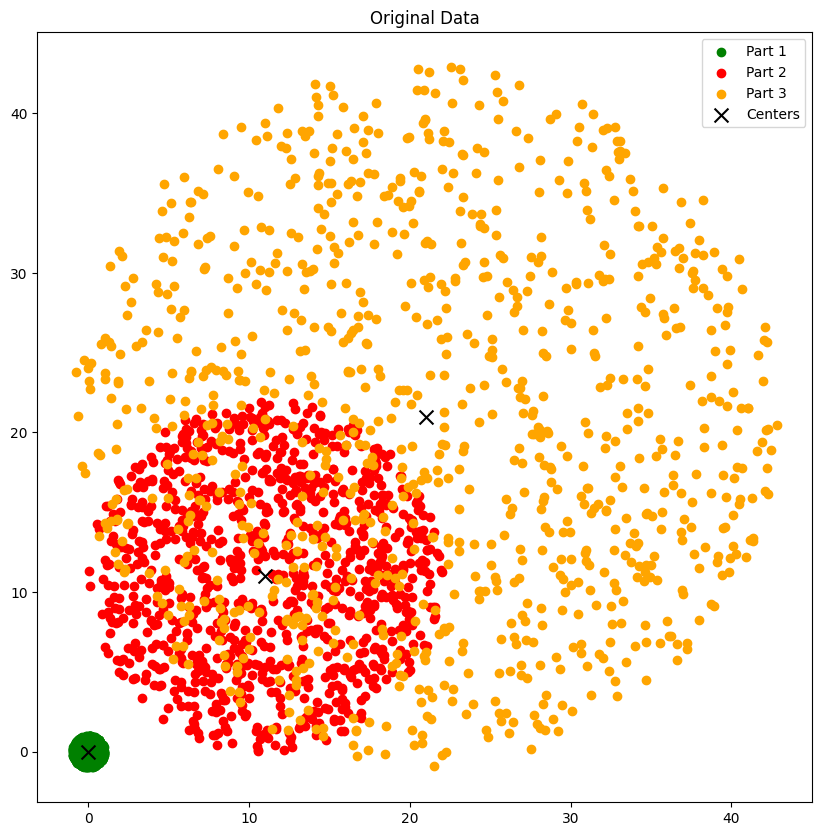

In [44]:
visualizeScatterPlotForTheThreeCirclesWithCenters(circle1, circle2, circle3)

# 2. Visualize the scatter plot of the three clusters after k-mean with their points and centers.

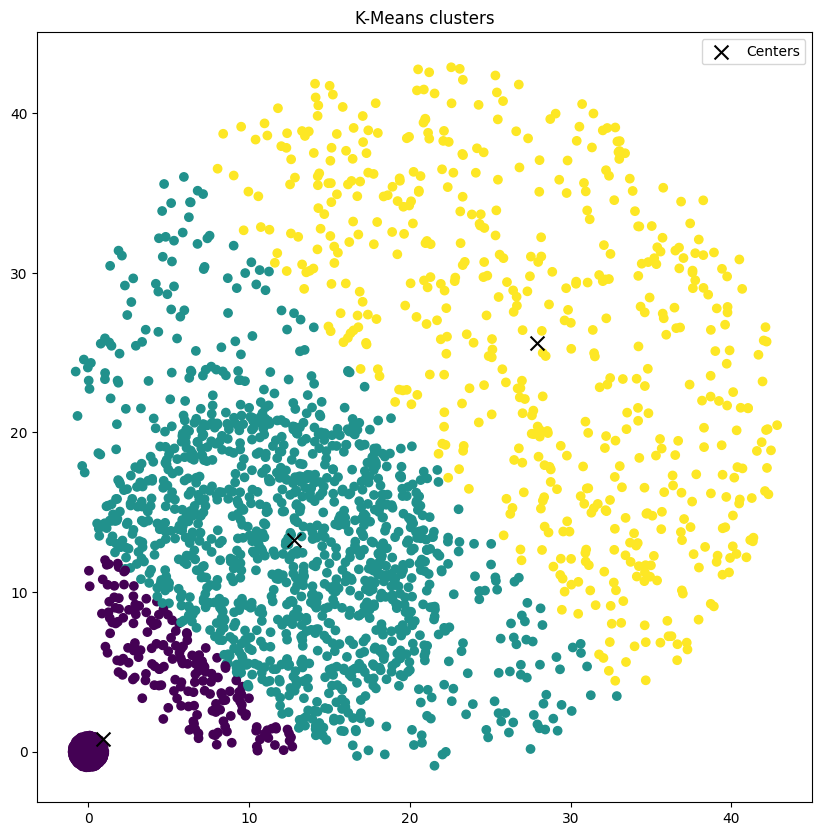

In [45]:
kmeans = kmeansClusteringCalculateAndVisualize(circles)

# 3. Compute the accuracy of the k-mean clustering

In [46]:
predicted_labels_mapped = mapPredictedLabels(true_labels, kmeans.labels_)
print(f"The accuracy of K-means clustering is {accuracy_score(true_labels, predicted_labels_mapped) * 100:.2f}%")

The accuracy of K-means clustering is 79.43%


# 4. Propose a clustering algorithm that can cluster them with more accurate accuracy

Proposed Algorithm: DBSCAN (Density-Based Spatial Clustering of Applications with Noise) is a strong candidate for more accurately clustering the given dataset.
This is due to several reasons:
- Flexibility in Cluster Shapes: DBSCAN can identify clusters of various shapes and sizes. Unlike k-means, which is best suited for spherical clusters, DBSCAN can effectively handle the circular shapes in our dataset, regardless of their orientation.
- Handling Varying Cluster Sizes: Our dataset has clusters of different sizes (radii of 1, 11, and 22 units). DBSCAN is well-suited for this scenario because it doesn't rely on the assumption that clusters are of similar sizes, unlike k-means, which can struggle with varying cluster dimensions.
- Overlap Between Clusters: The positioning of the clusters in our dataset might lead to overlap, particularly between the larger circles. DBSCAN can better manage such overlapping scenarios as it groups points based on density, whereas k-means might misclassify points in overlapping regions due to its reliance on centroid proximity.
- No Need for Preset Cluster Numbers: DBSCAN does not require pre-specifying the number of clusters, making it more versatile for datasets where the number of clusters is not known in advance. This contrasts with k-means, which needs the number of clusters to be defined beforehand.

# 5. Compare the mean distance of points to its center cluster result from k-mean with the mean distance of points to its centers from the original parts

In [47]:
calculateMeanDistances(circle1, circle2, circle3, circles, kmeans)

,Cluster,Mean Distance (Original),Mean Distance (K-Means)
0,Circle 1,0.664256,2.305768
1,Circle 2,7.399181,8.313197
2,Circle 3,14.667036,12.030292


The mean distances in the k-means clusters are generally greater than those in the original parts. This suggests that the clustering has not perfectly captured the original distributions, which is also reflected in the accuracy score of about 79.70%.

# 6. If the data set is distributed into ellipses that are directed vertically, how would the clusters from k-mean will be look like

If the dataset was distributed into vertically directed ellipses instead of circles, the k-means clusters would likely be less accurate. K-means assumes spherical clusters, so it might not properly capture the elongated shape of ellipses, especially if they are oriented vertically rather than being centered around the mean points.

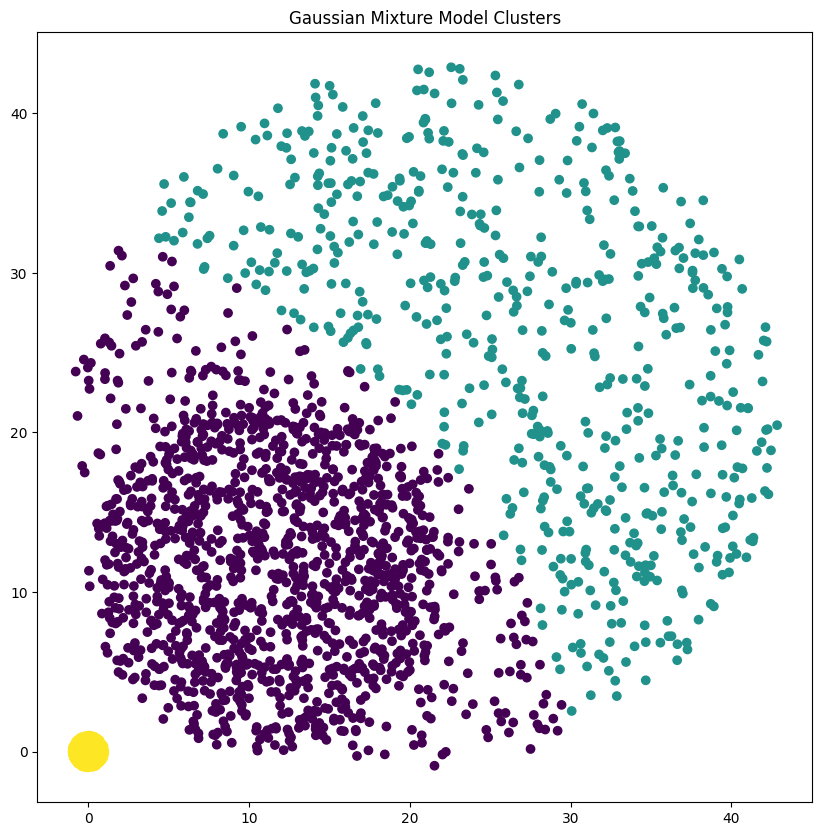

0.863

In [105]:
from sklearn.mixture import GaussianMixture
from sklearn.metrics import accuracy_score

# Gaussian Mixture Model Clustering
gmm = GaussianMixture(n_components=3, random_state=42)
gmm.fit(circles)
gmm_labels = gmm.predict(circles)

# Visualize GMM result
plt.figure(figsize=(10, 10))
plt.scatter(circles[:, 0], circles[:, 1], c=gmm_labels)
plt.title('Gaussian Mixture Model Clusters')
plt.show()

# Map GMM labels to true labels for accuracy calculation
gmm_labels_mapped = np.zeros_like(gmm_labels)
for i in range(3):
    mask = (gmm_labels == i)
    gmm_labels_mapped[mask] = mode(true_labels[mask])[0]

# Calculate accuracy
gmm_accuracy = accuracy_score(true_labels, gmm_labels_mapped)
gmm_accuracy


234


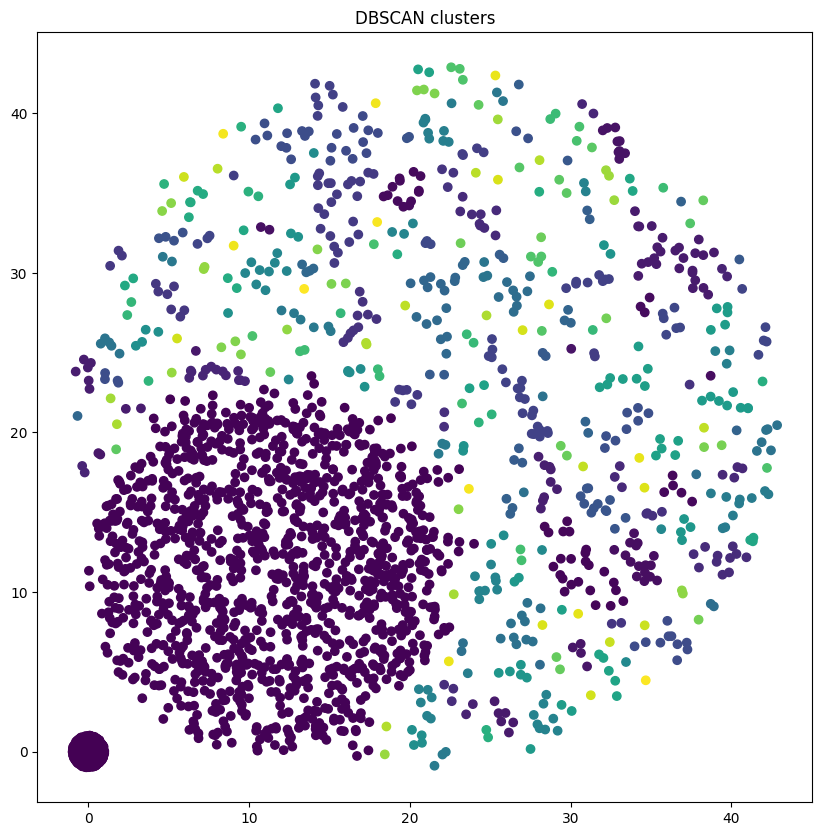

0.6666666666666666
2


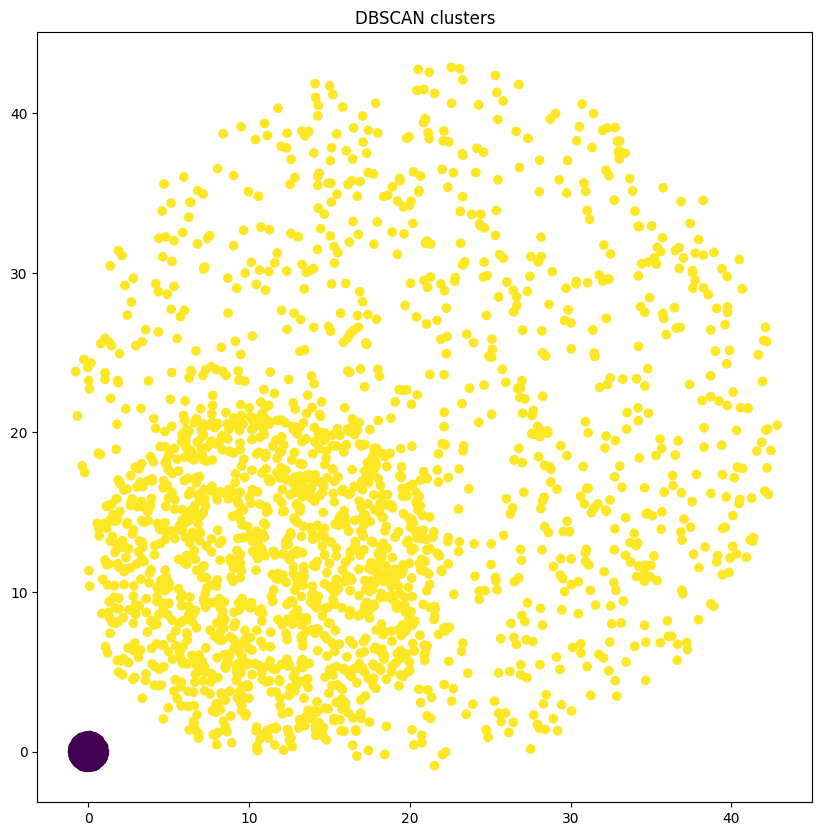

0.6666666666666666
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


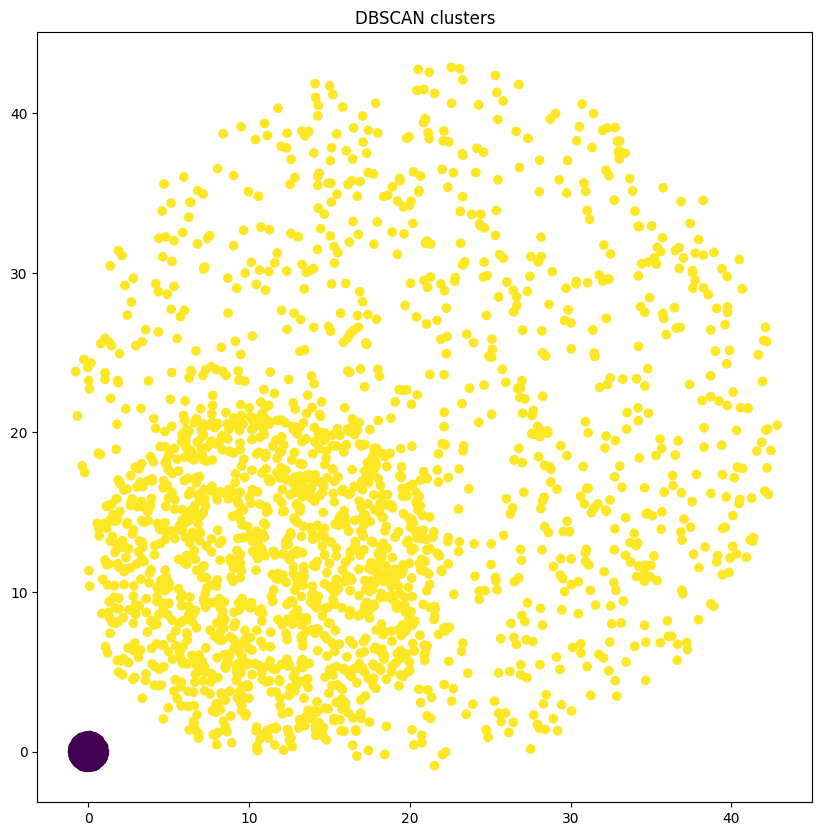

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


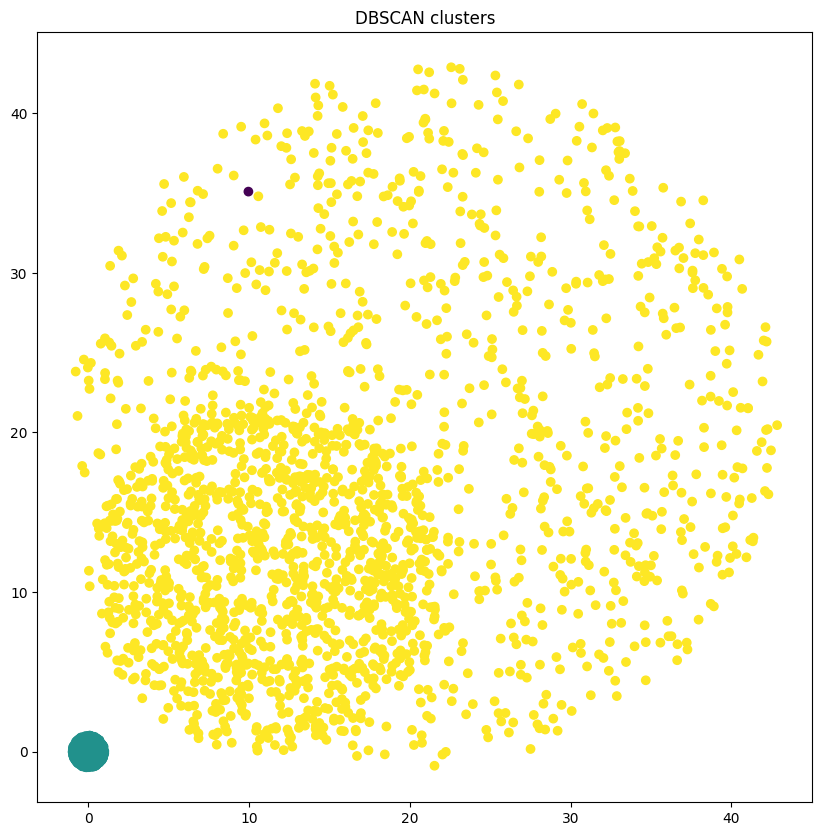

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


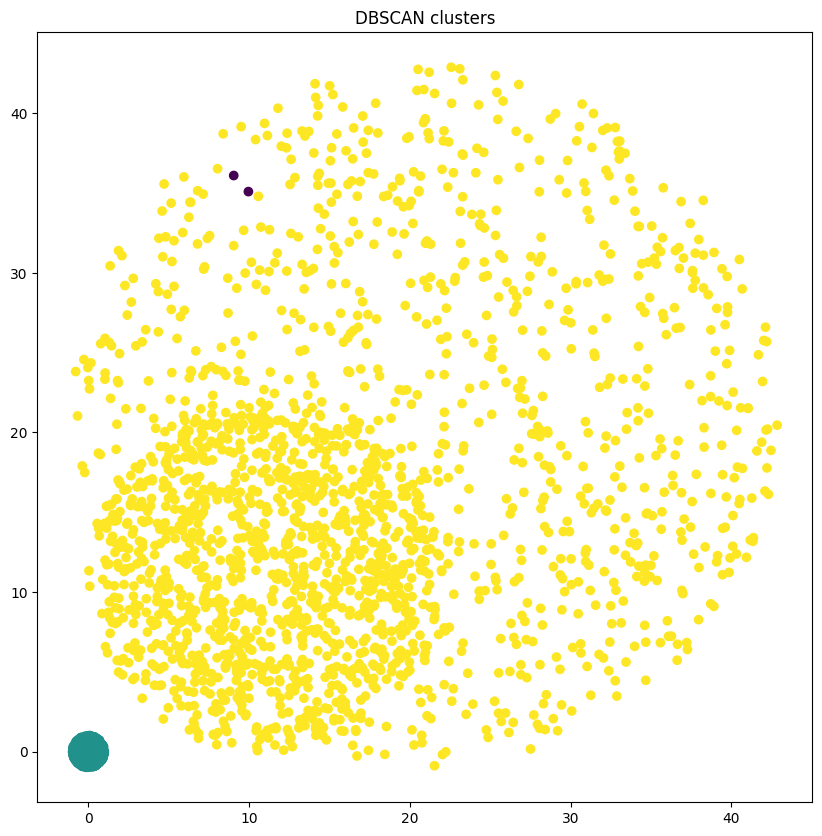

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


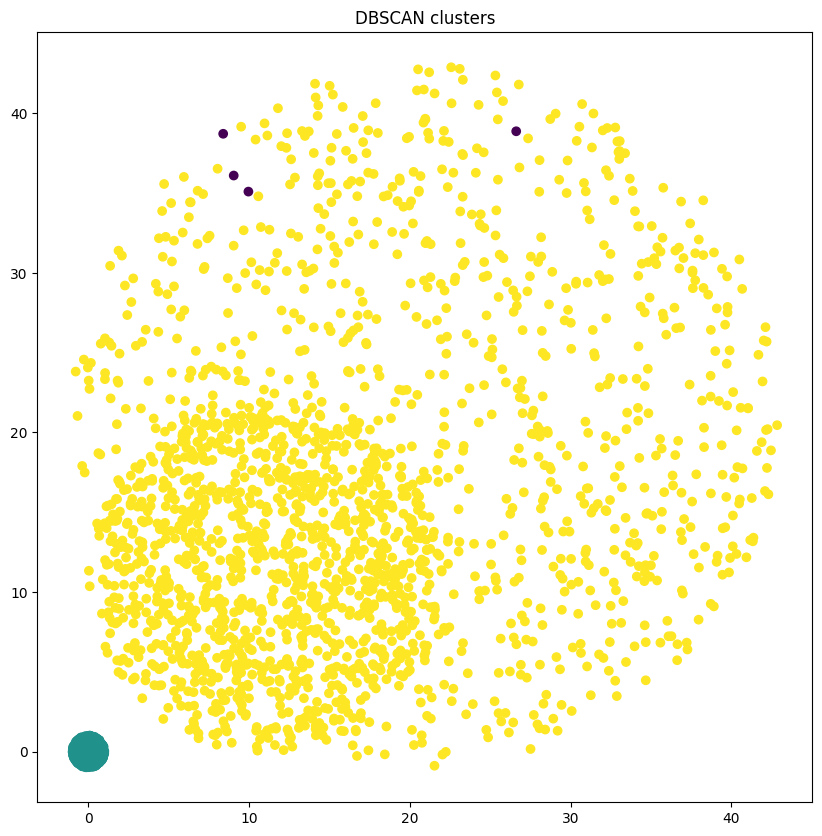

0.6666666666666666
4


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


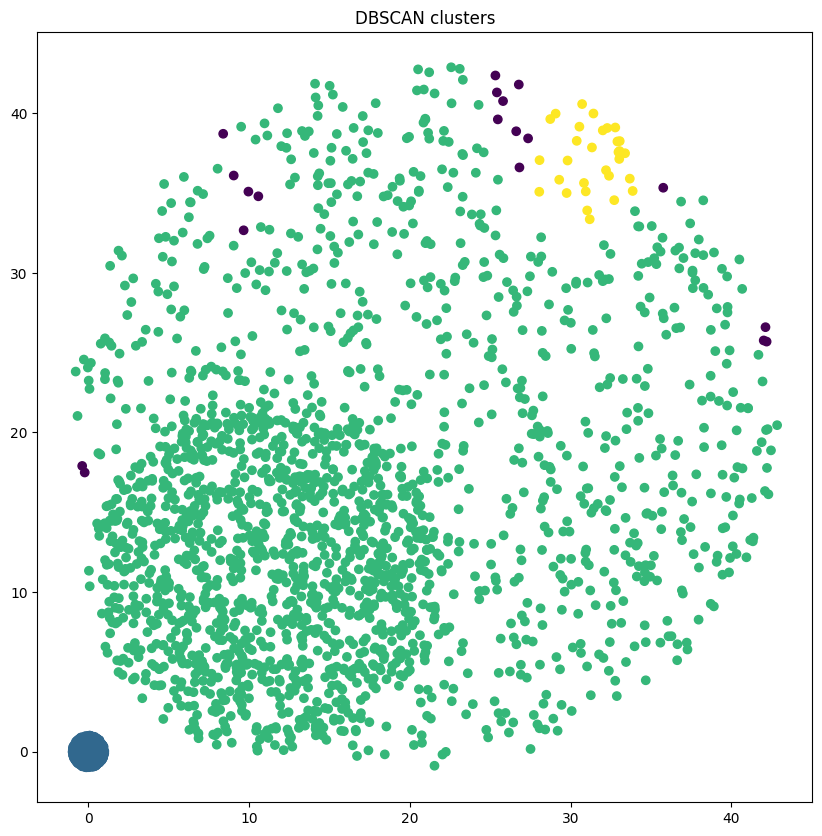

0.6766666666666666
6


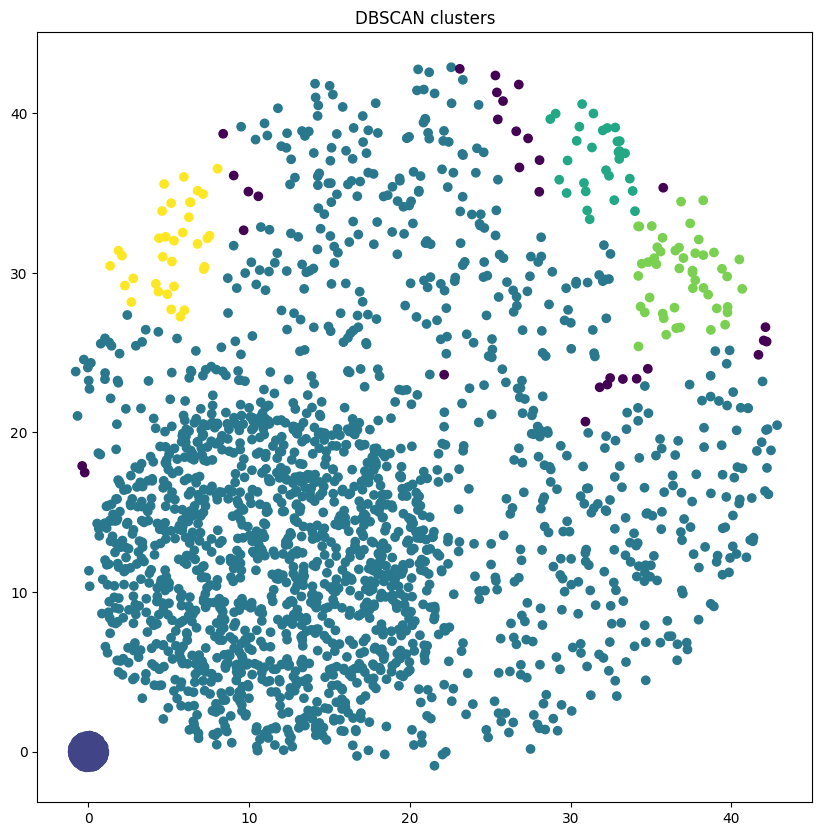

0.6763333333333333
9


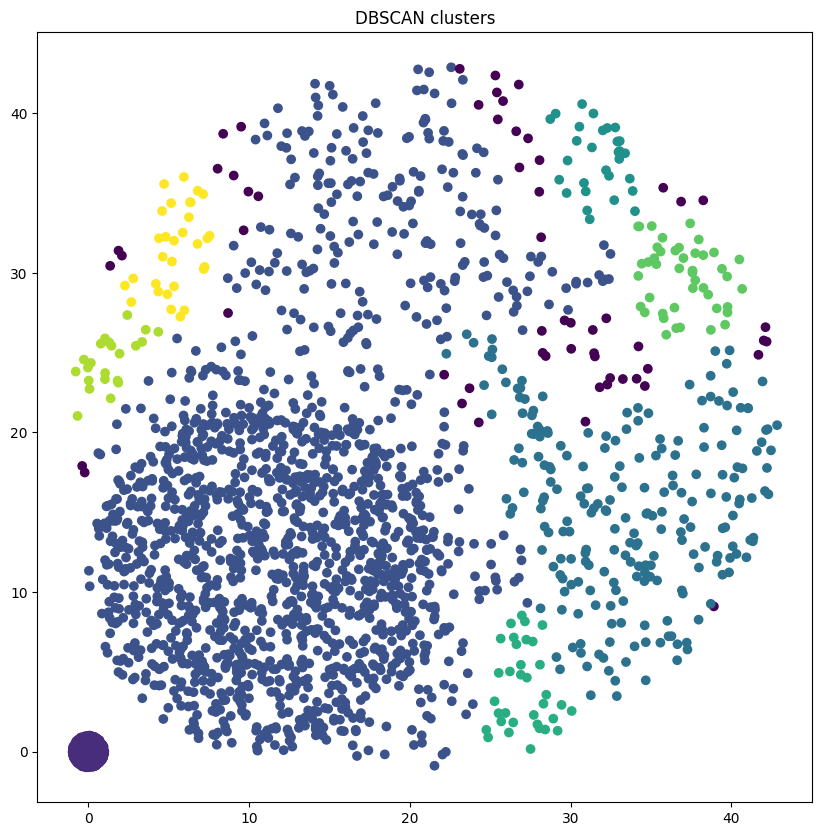

0.7403333333333333
16


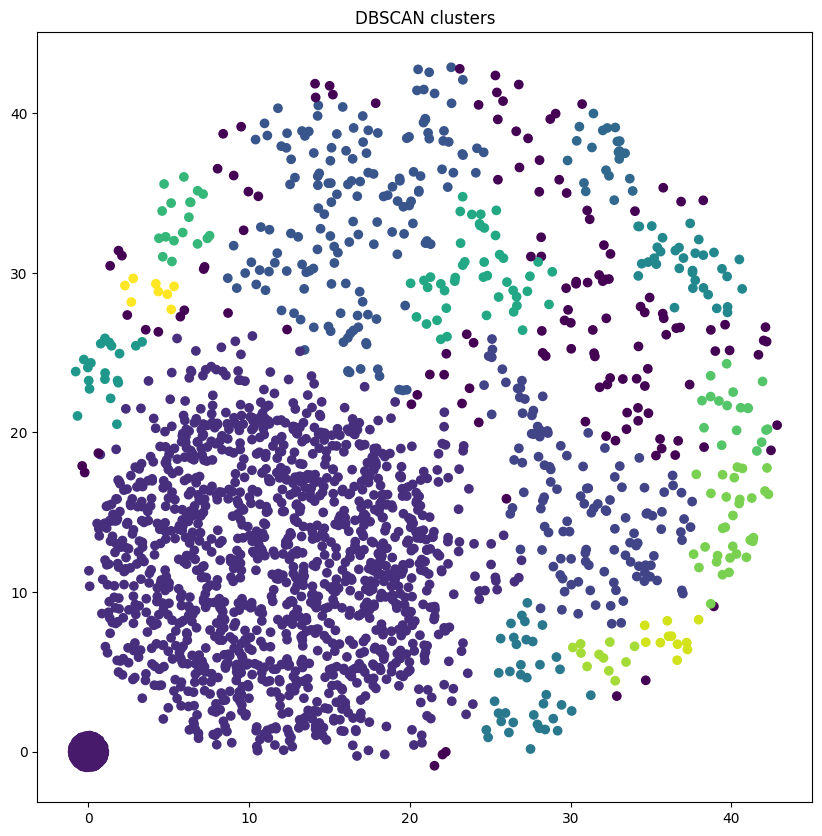

0.708
2


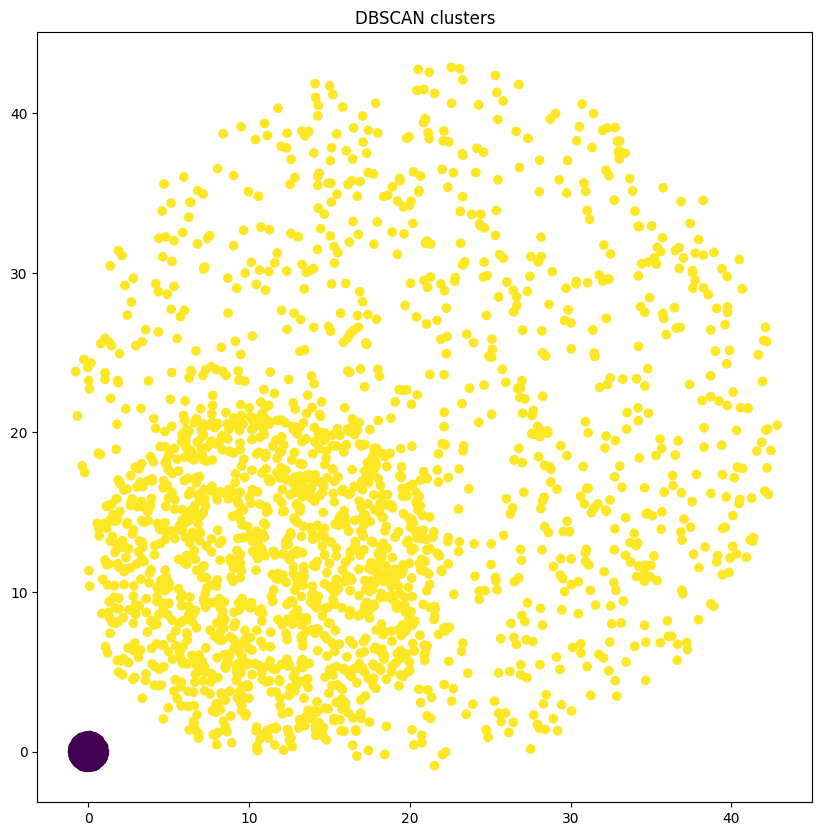

0.6666666666666666
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


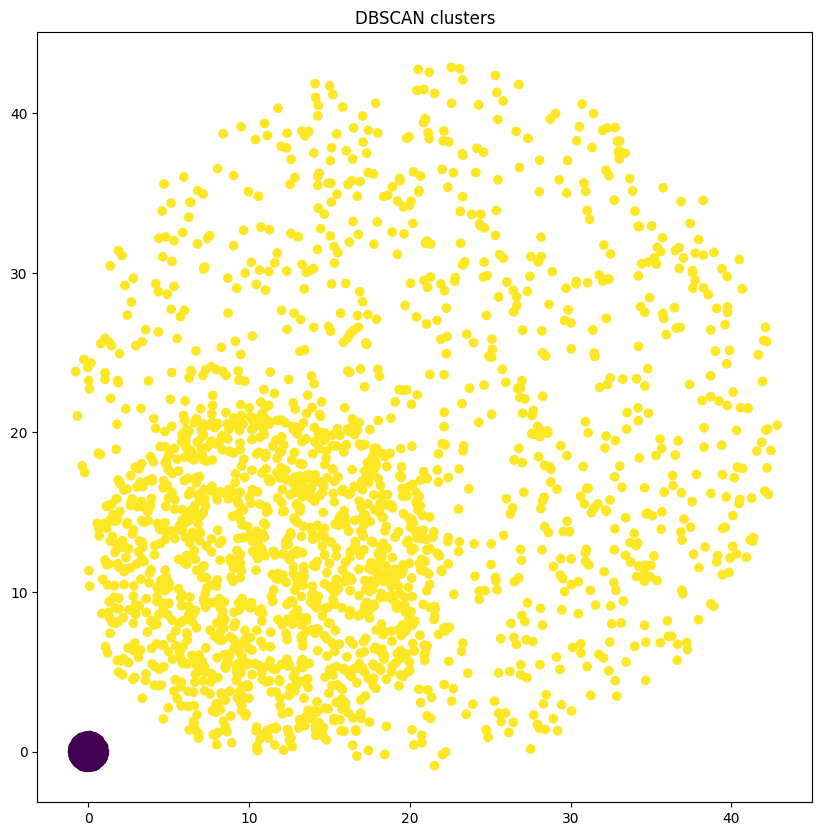

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
2


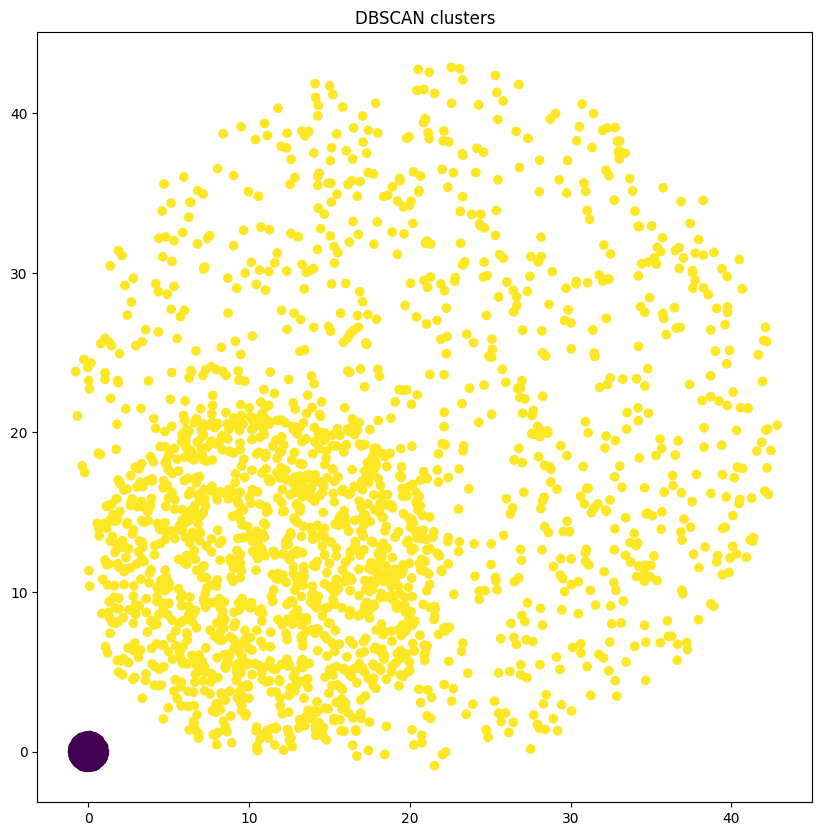

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


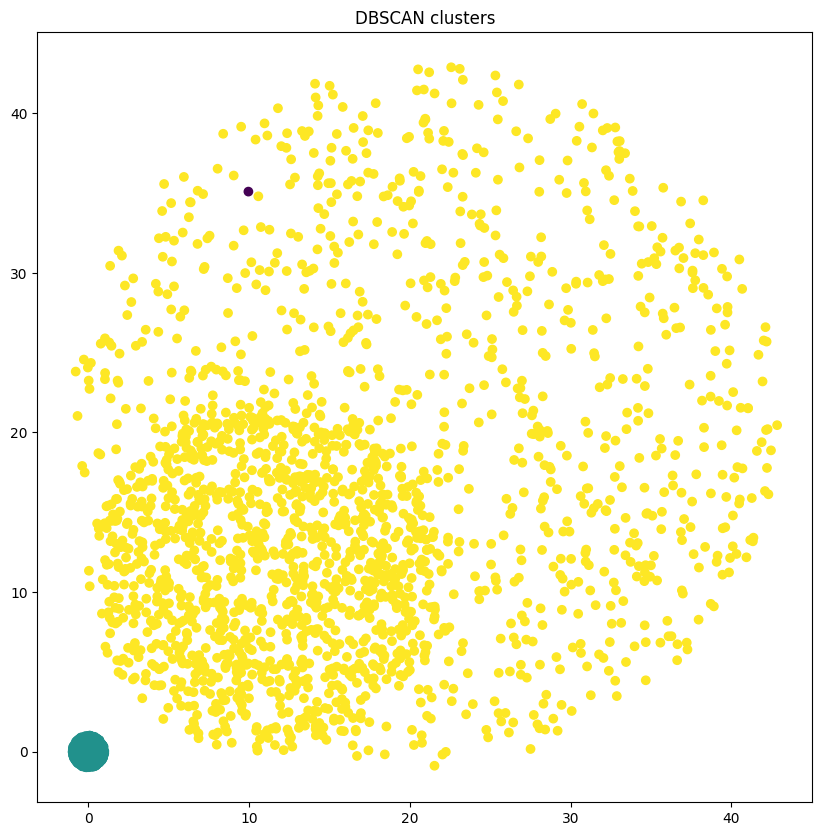

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


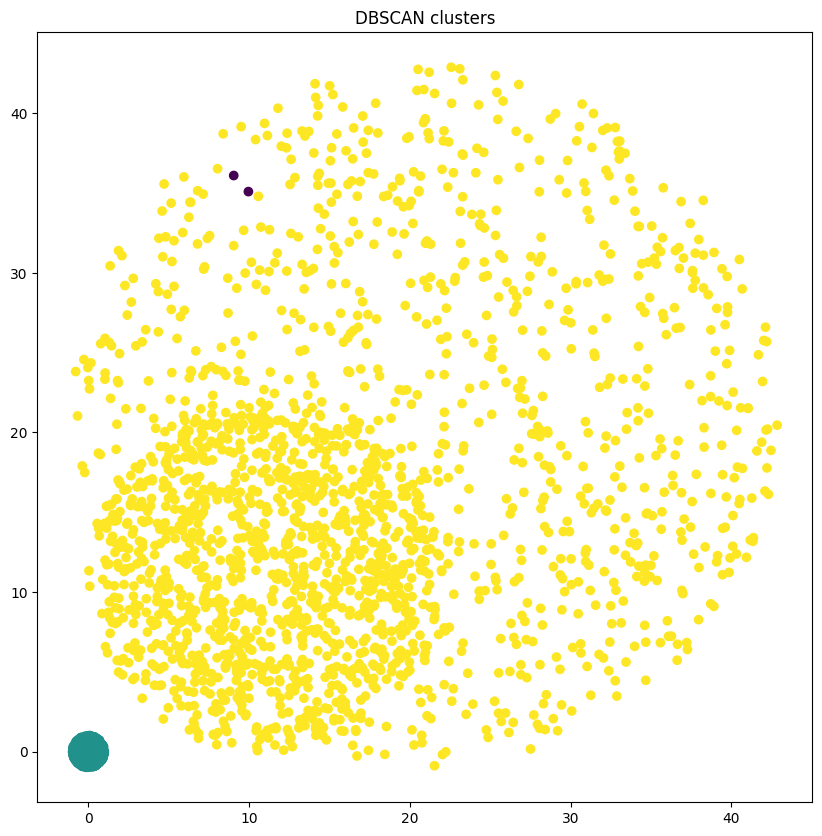

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


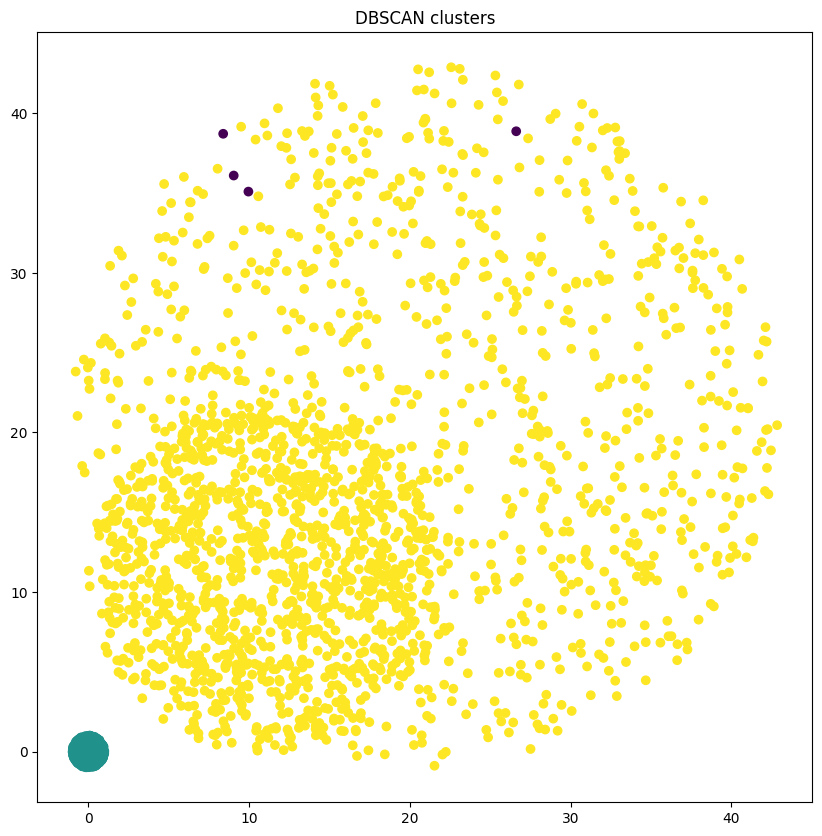

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
4


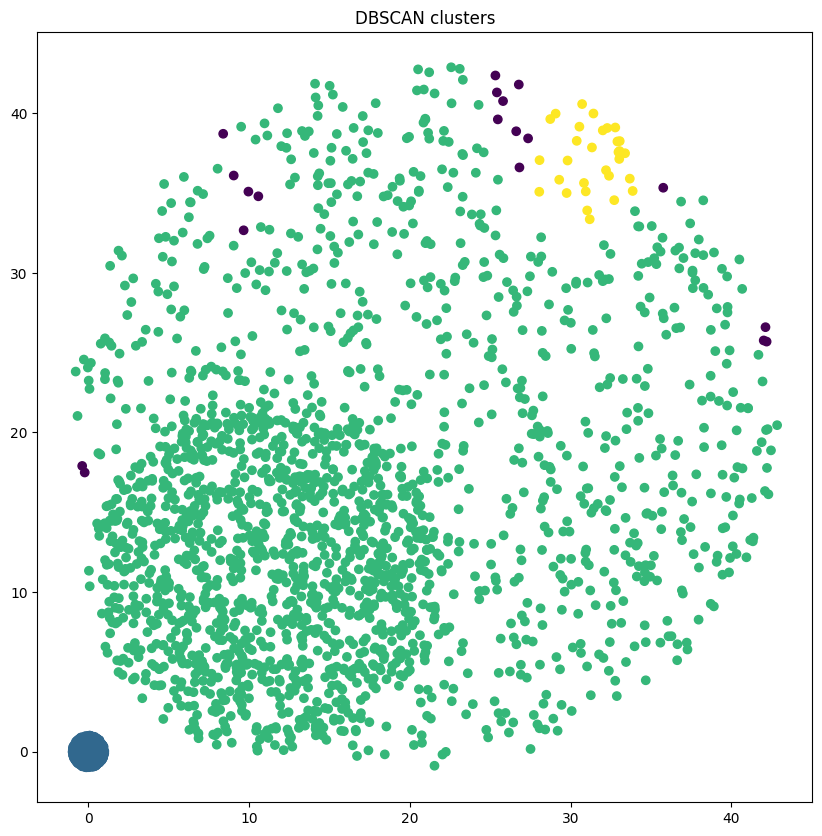

0.6766666666666666
6


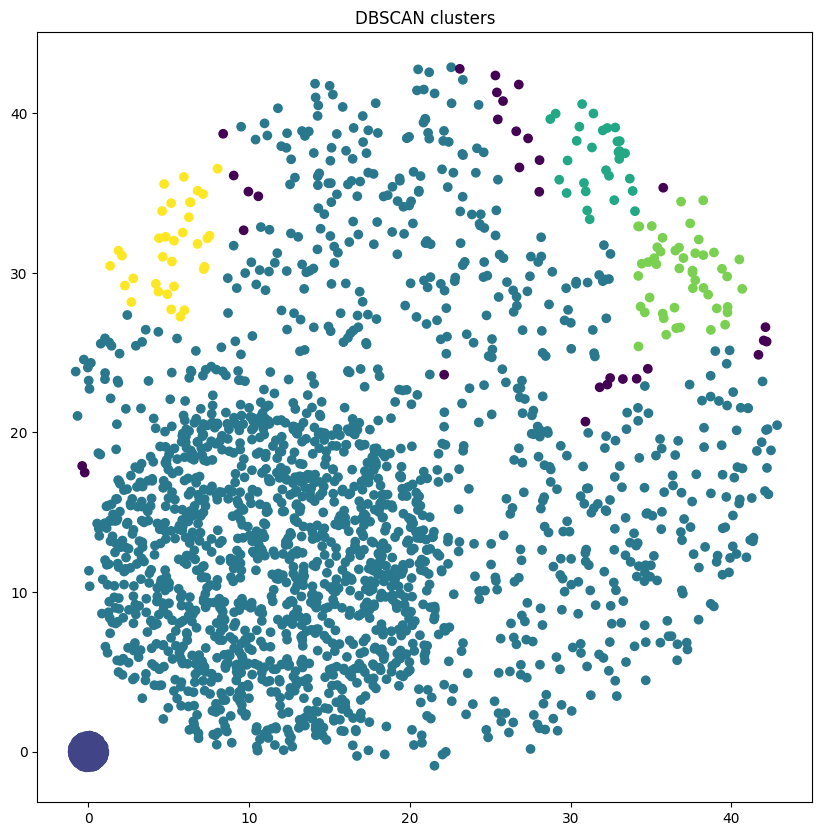

0.6763333333333333
9


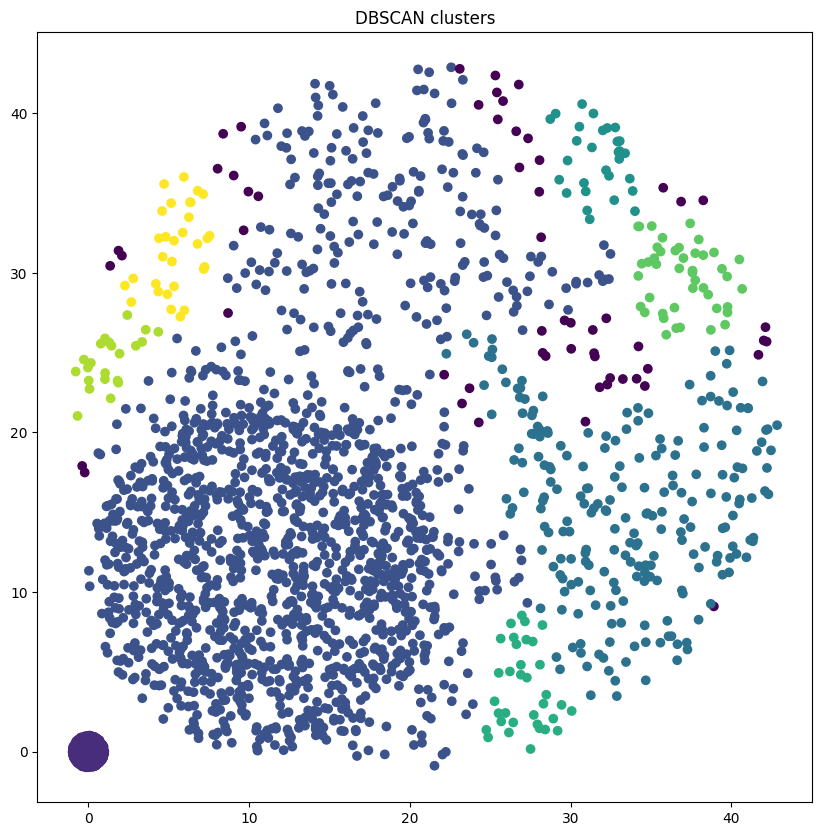

0.7403333333333333
16


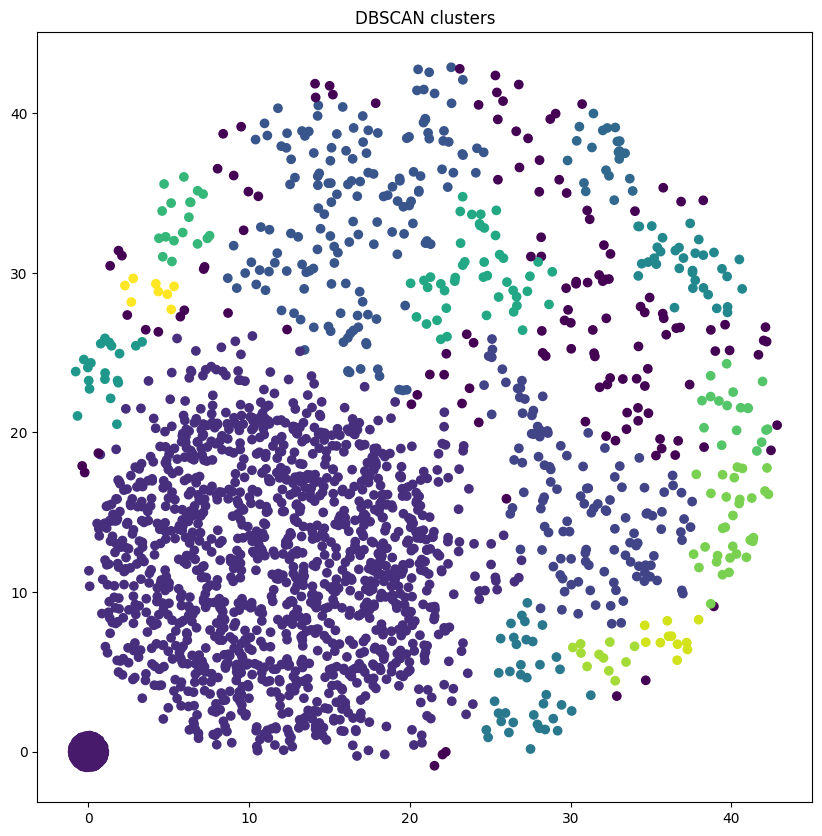

0.708
2


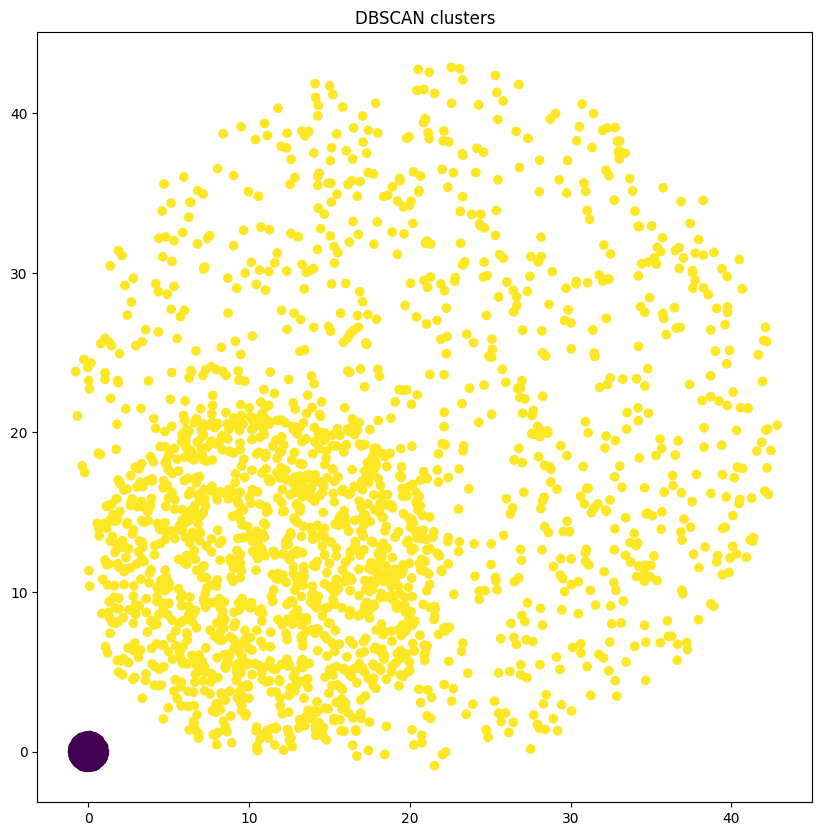

0.6666666666666666
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


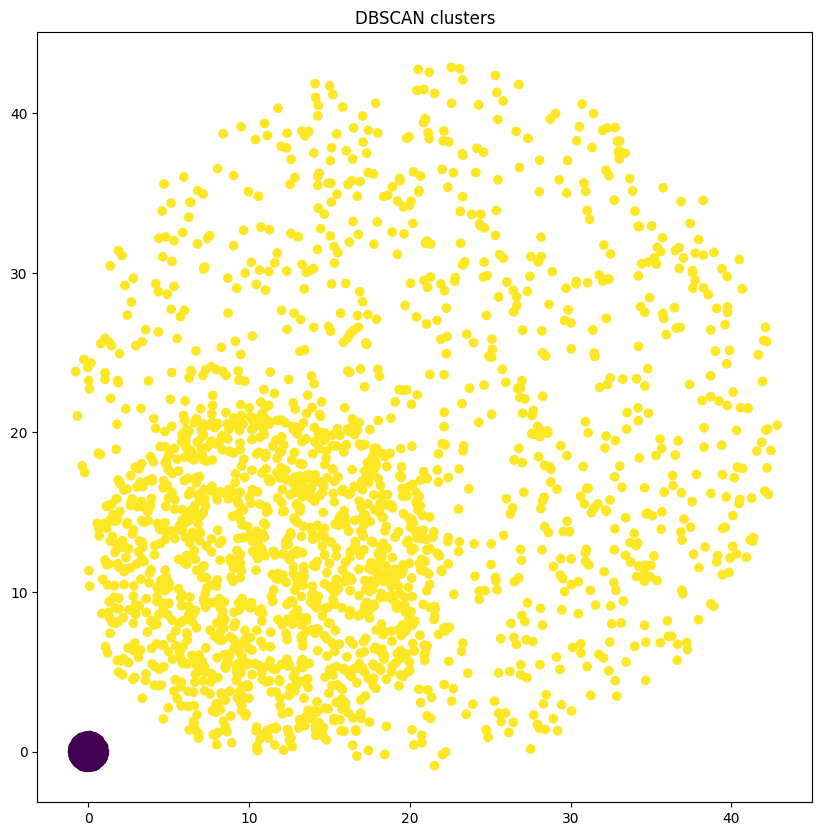

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
2


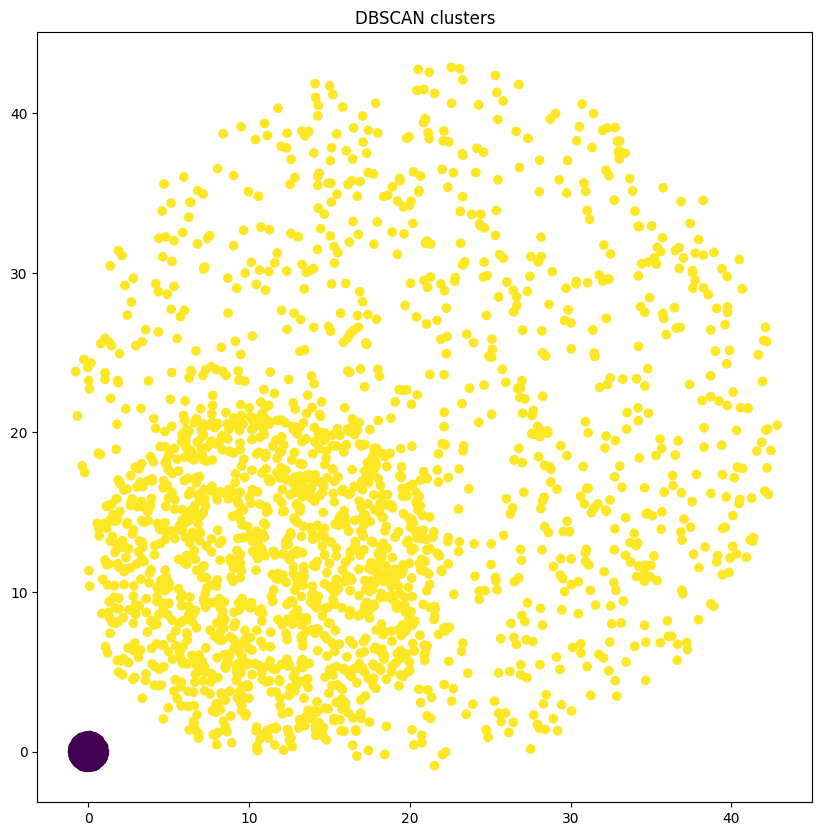

0.6666666666666666
3


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


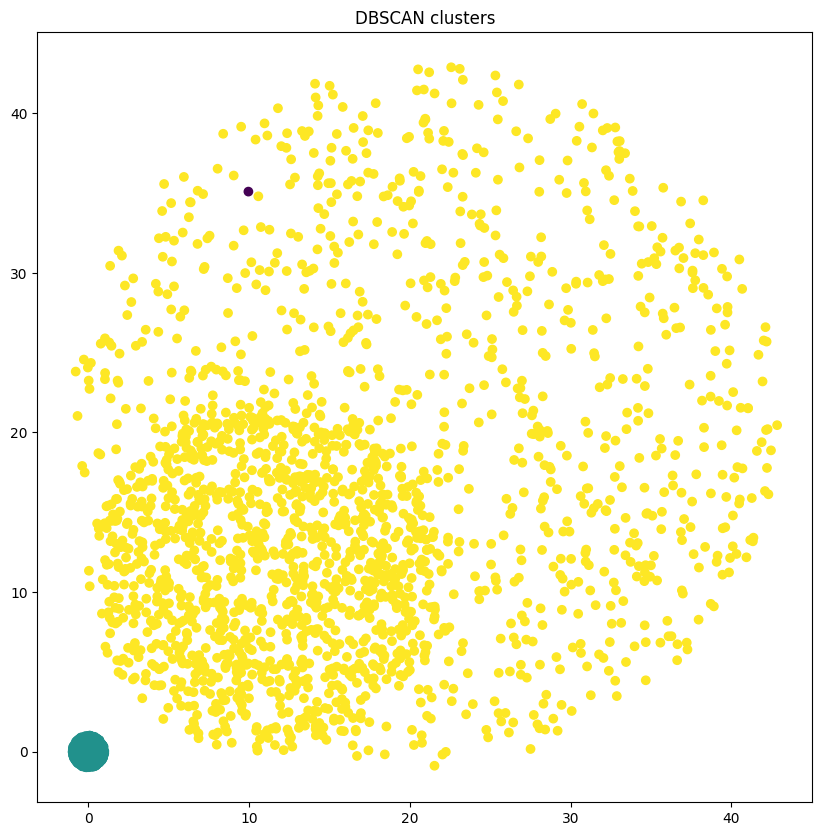

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


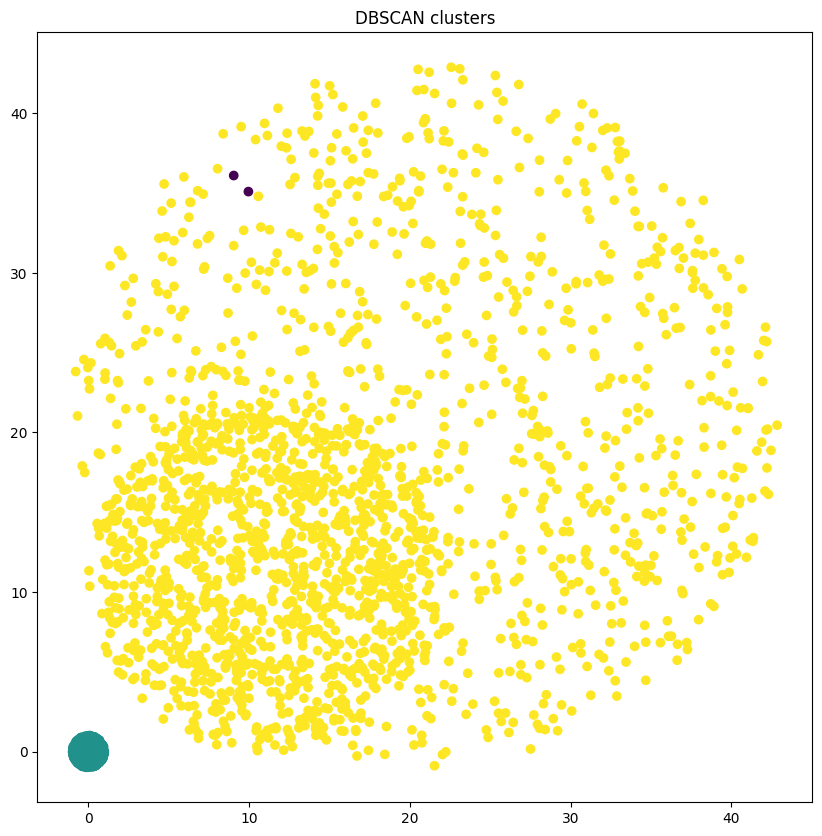

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


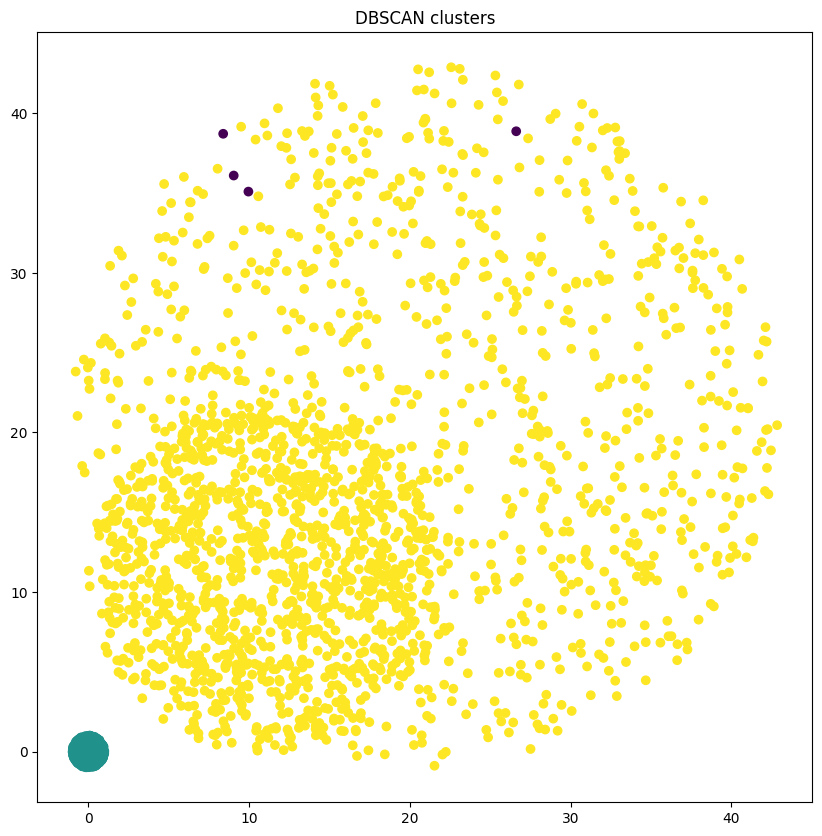

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
4


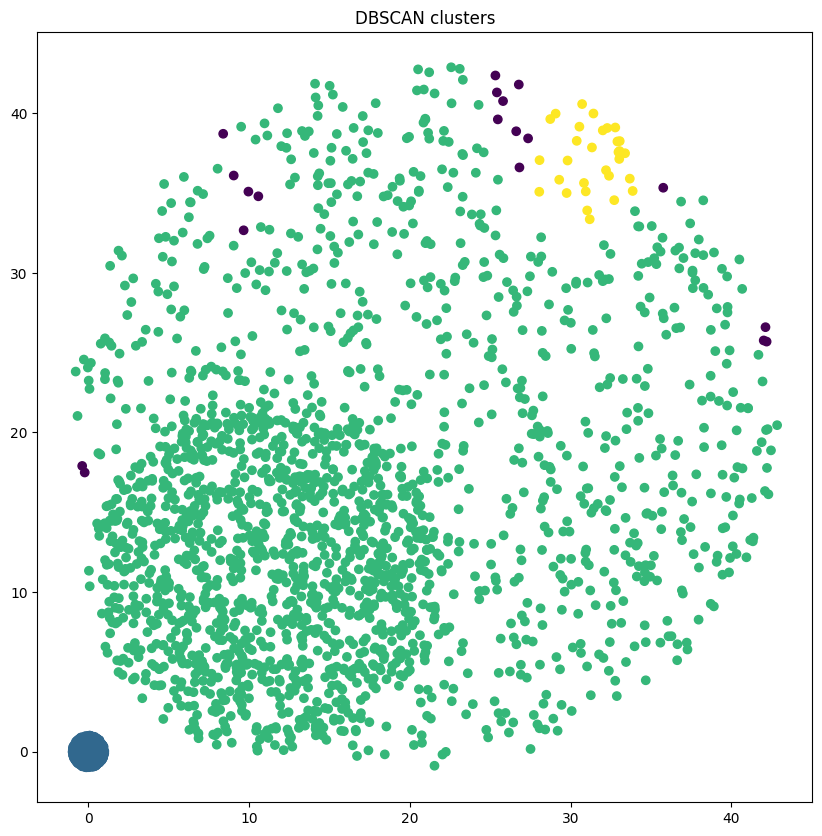

0.6766666666666666
6


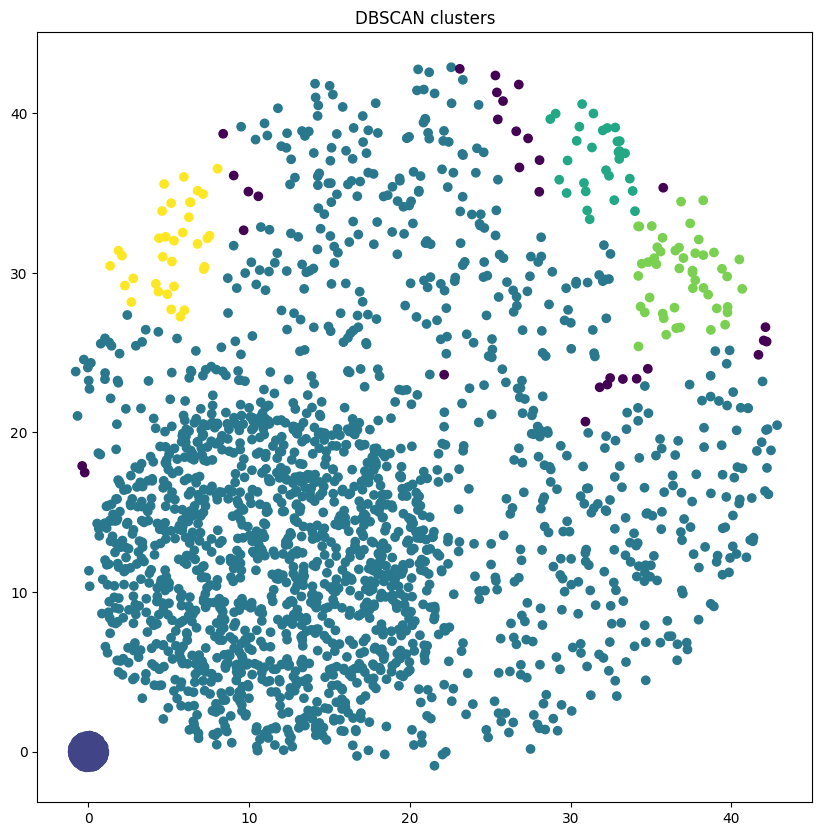

0.6763333333333333
9


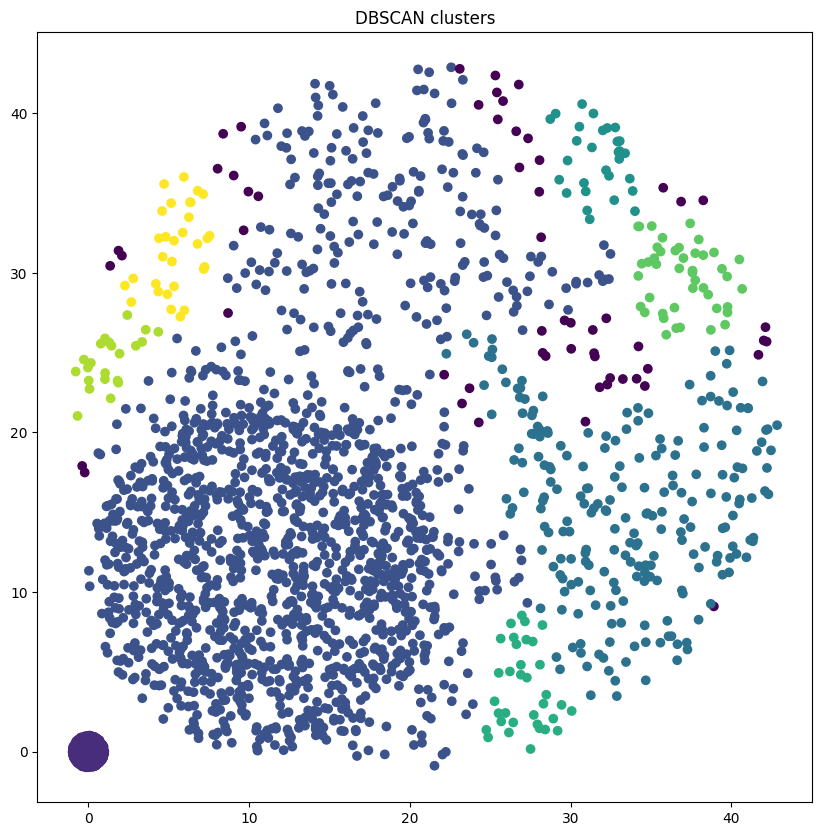

0.7403333333333333
16


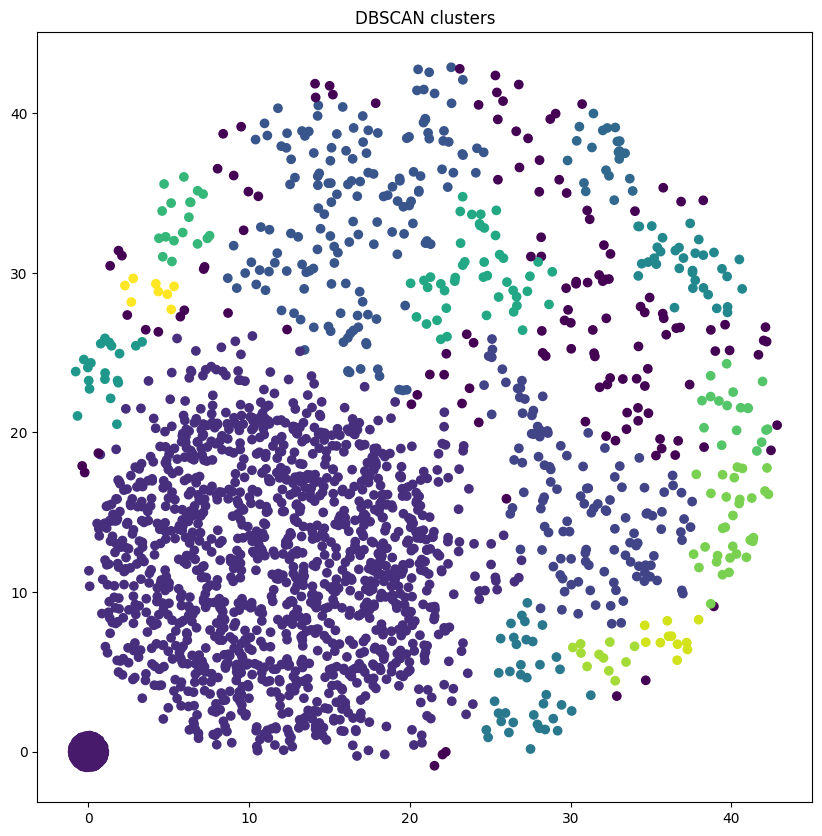

0.708
1


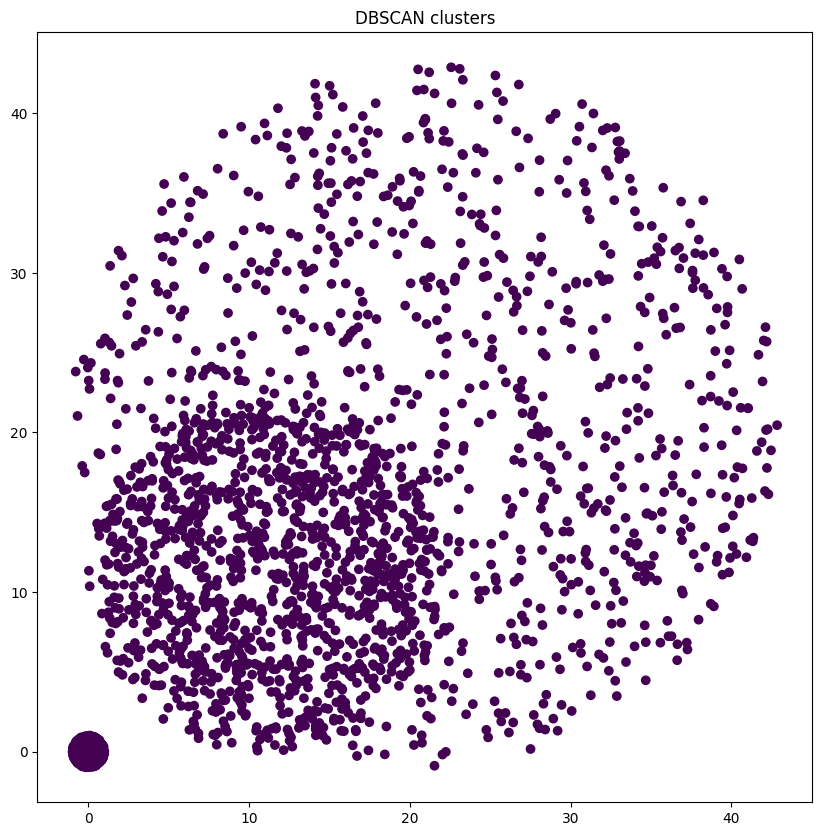

0.3333333333333333
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


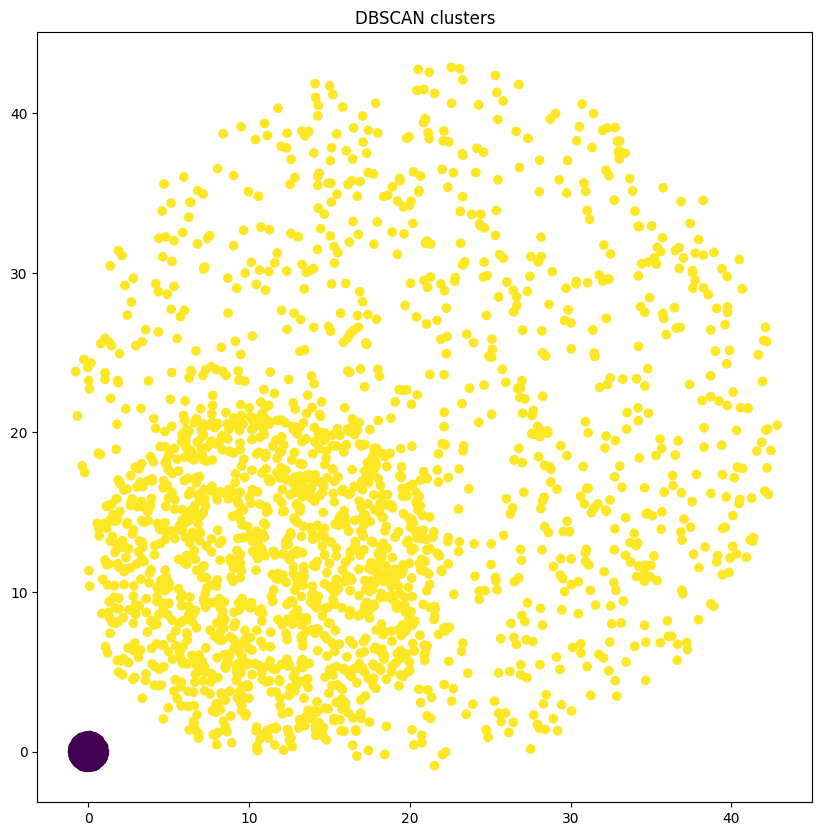

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
2


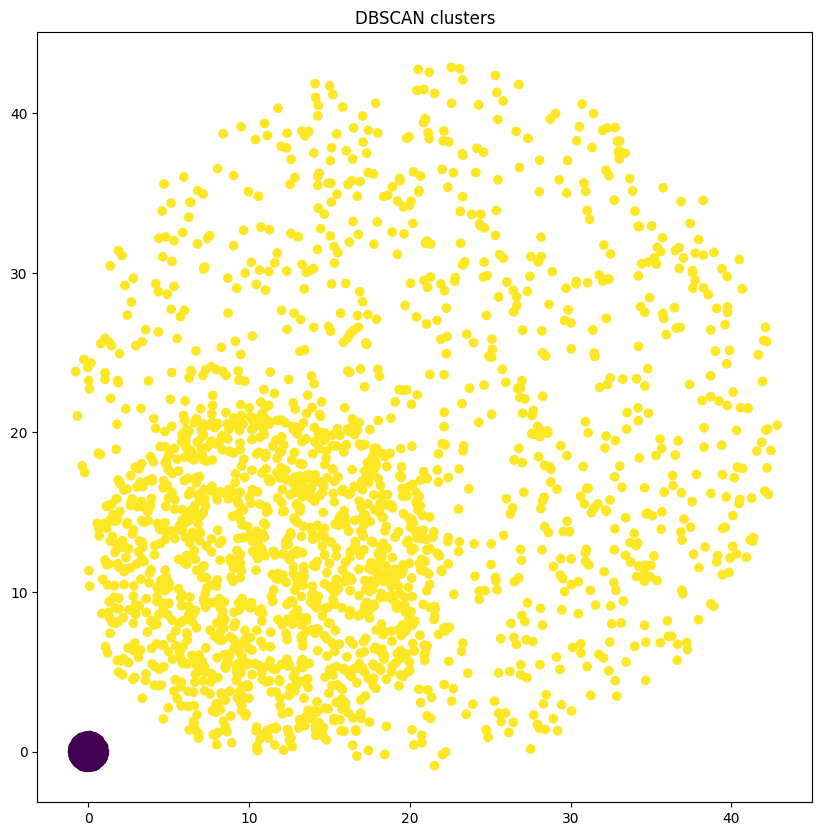

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


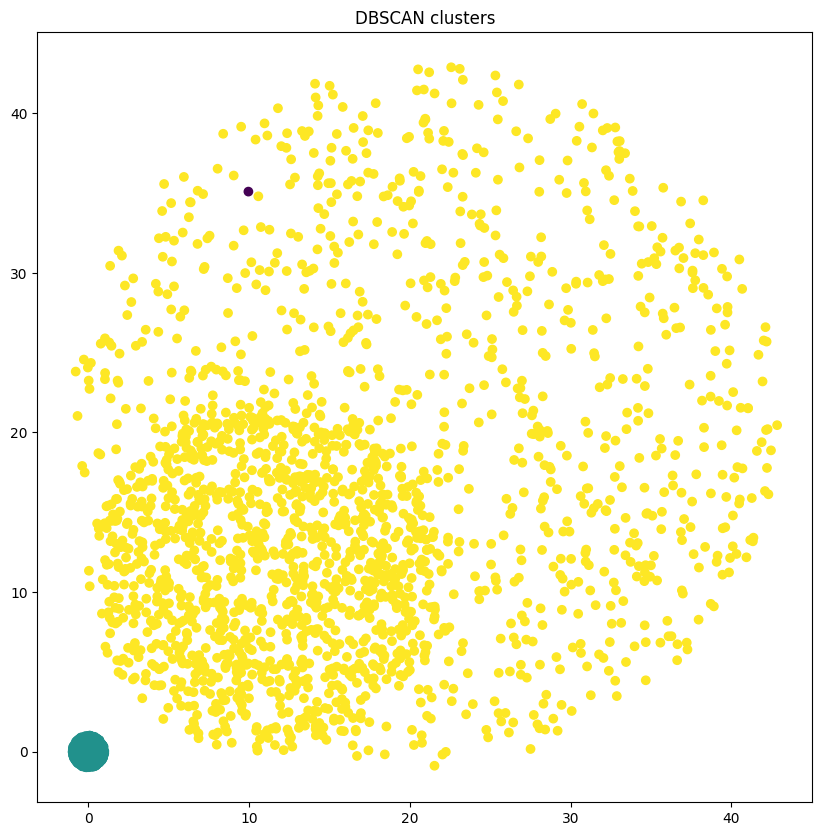

0.6666666666666666
3


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


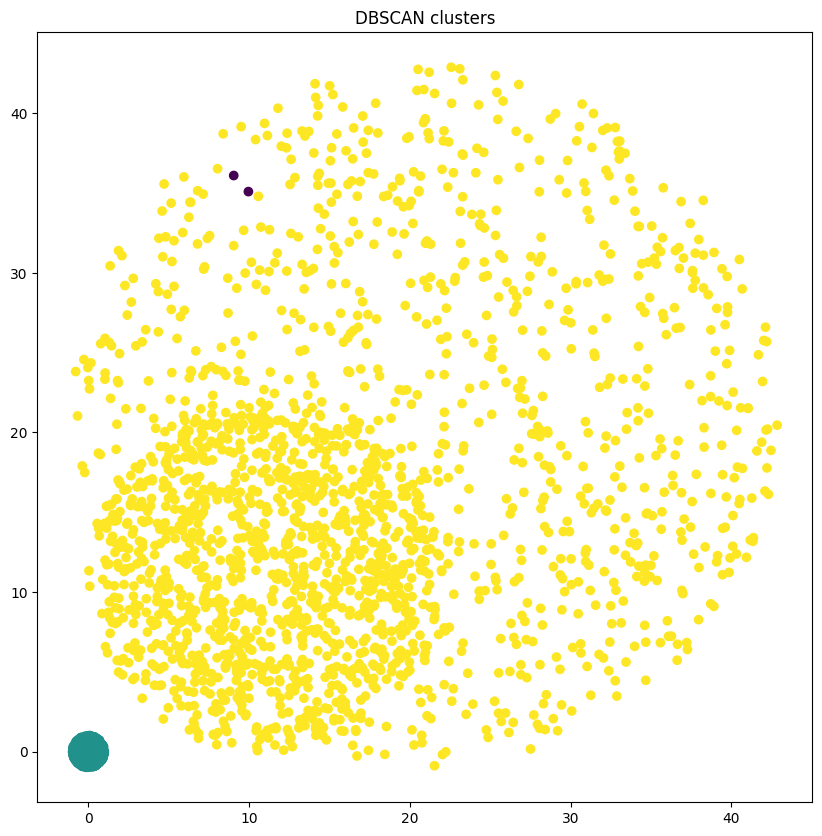

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


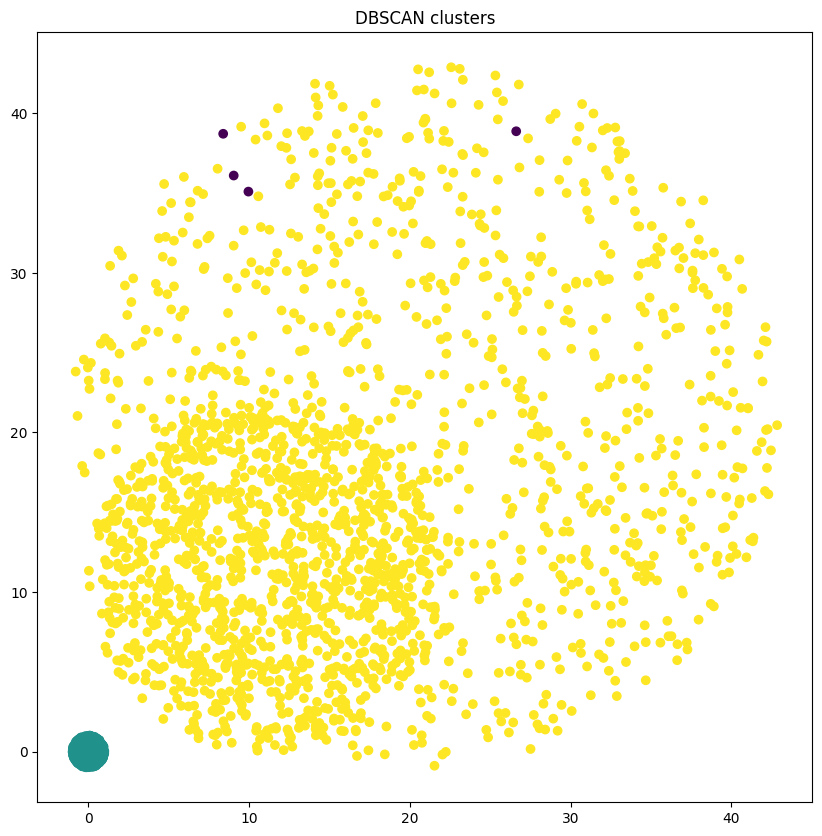

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
4


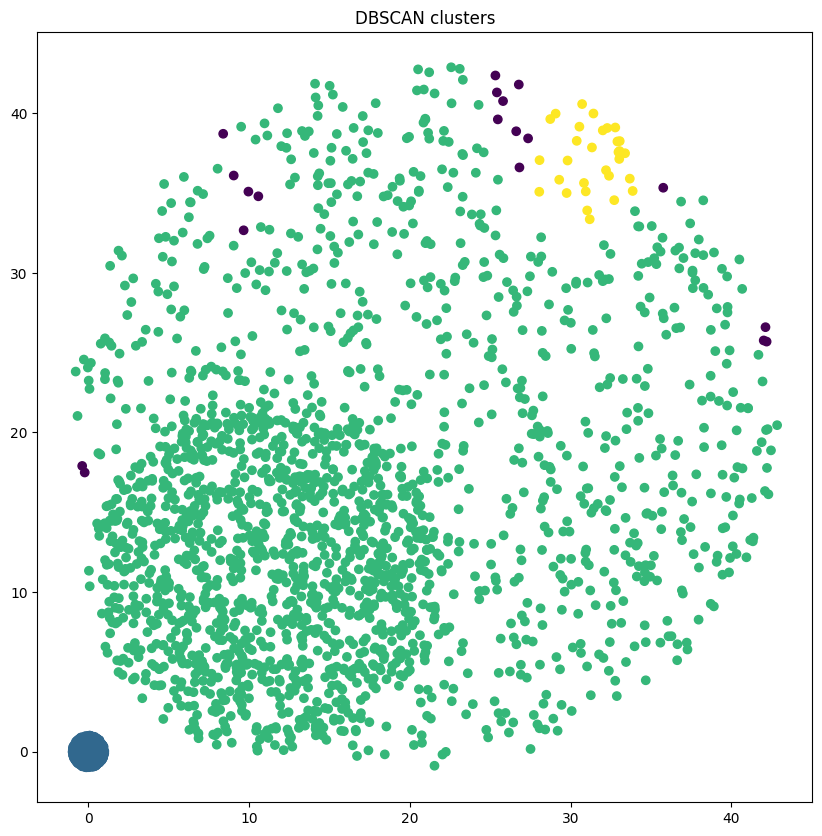

0.6766666666666666
6


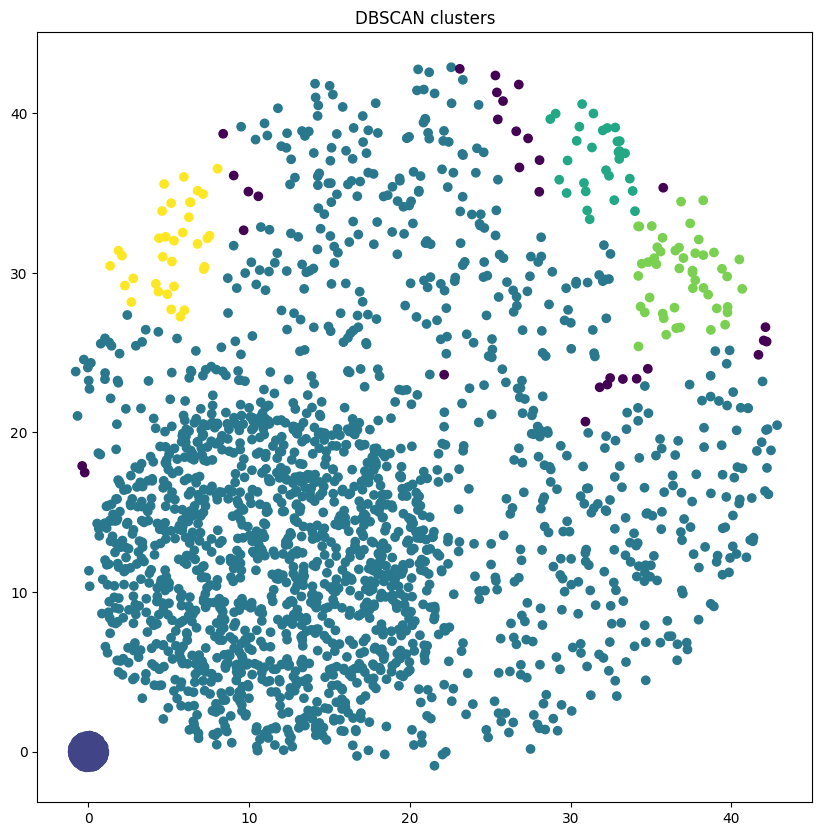

0.6763333333333333
9


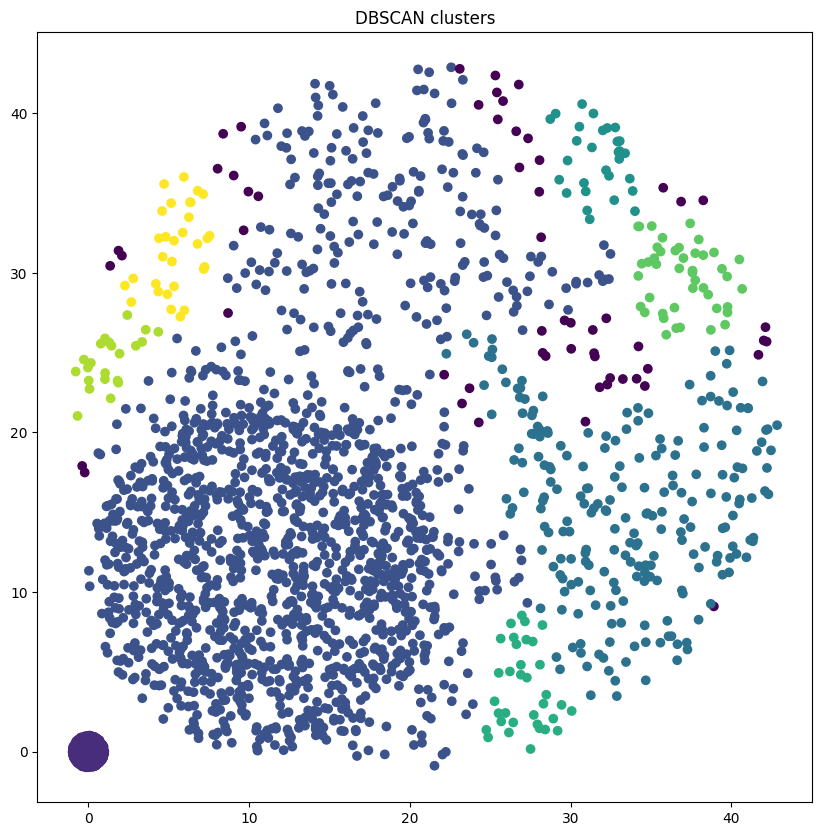

0.7403333333333333
16


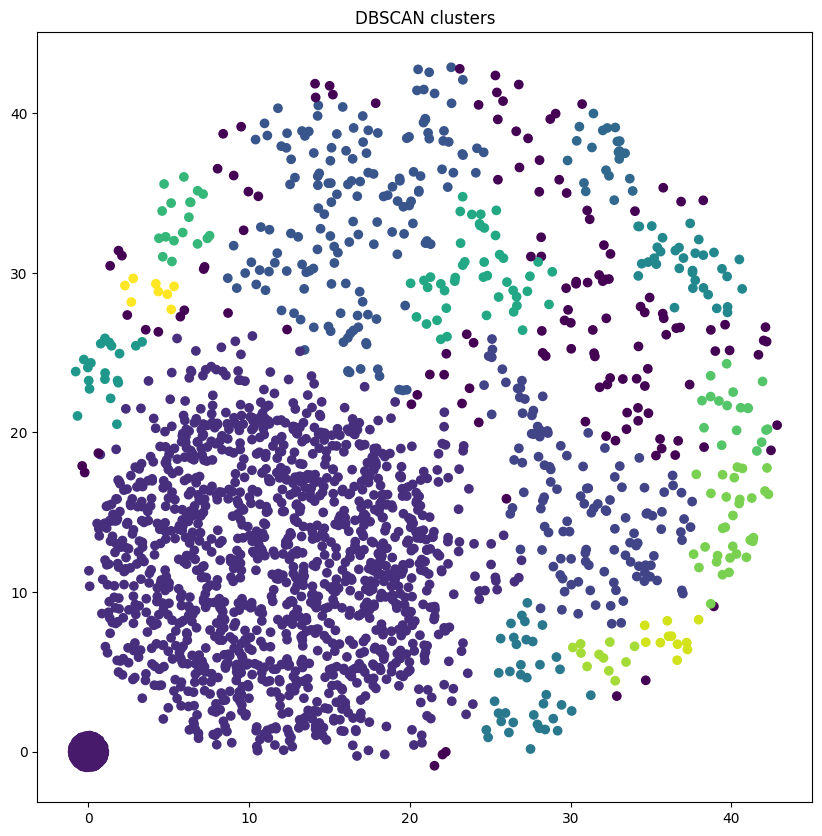

0.708
1


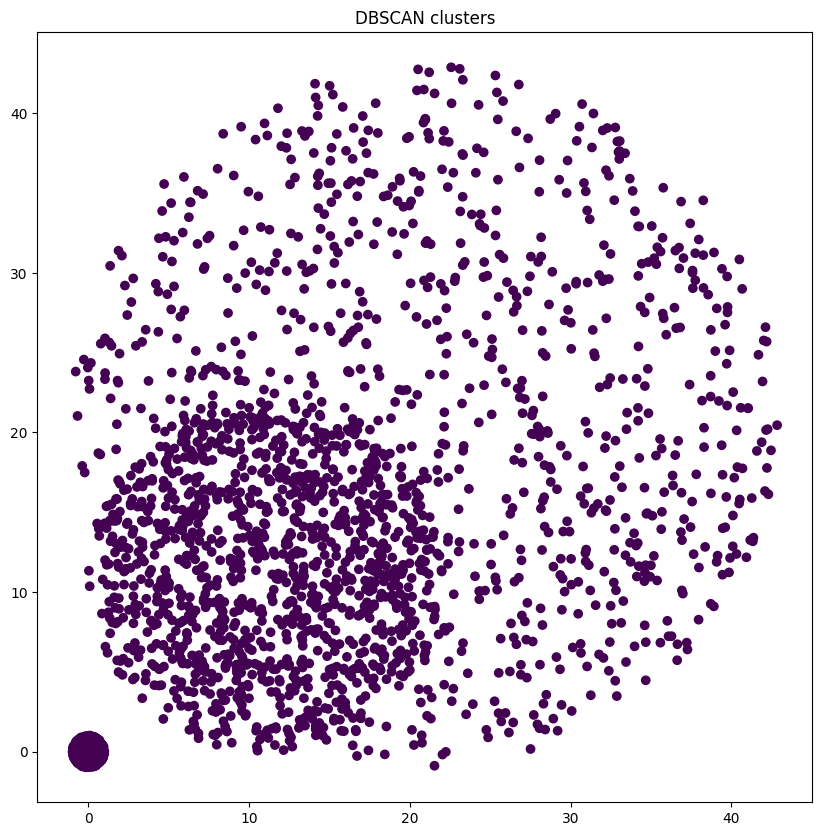

0.3333333333333333
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


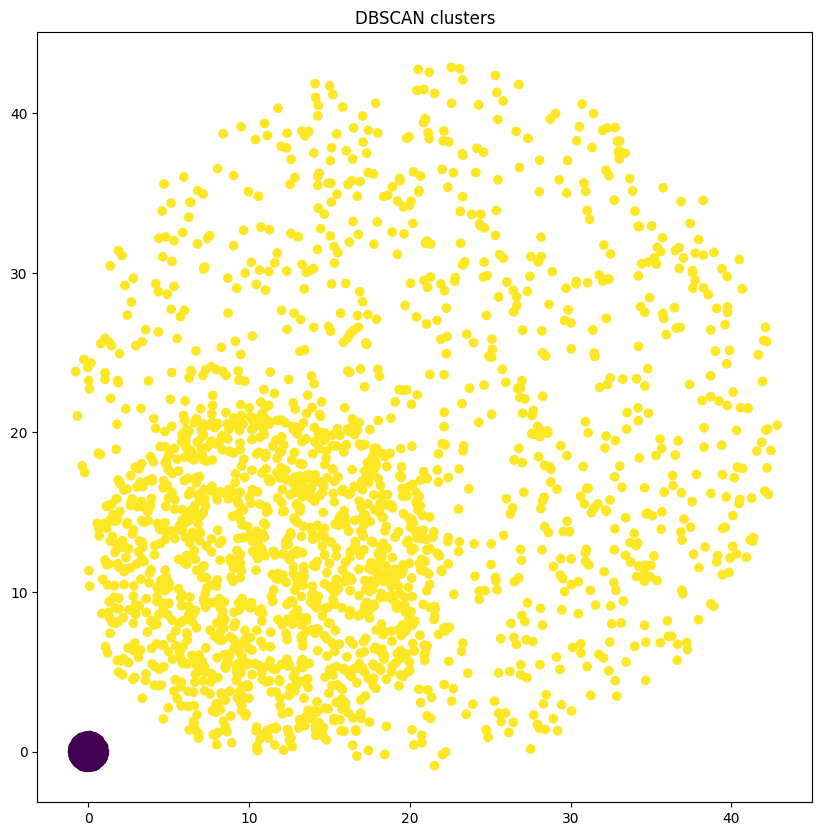

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
2


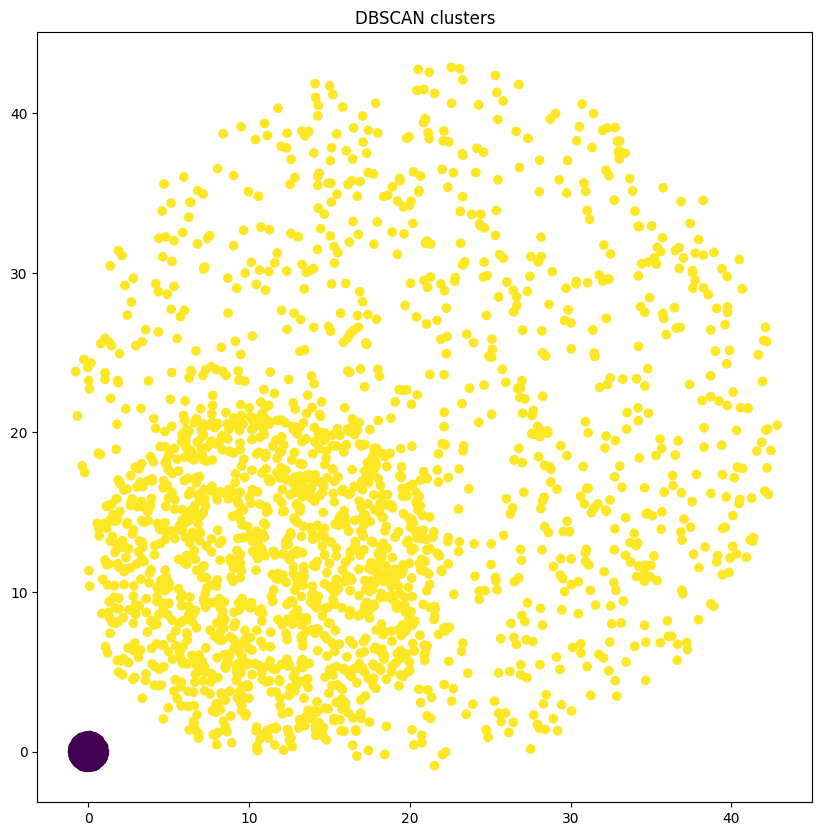

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


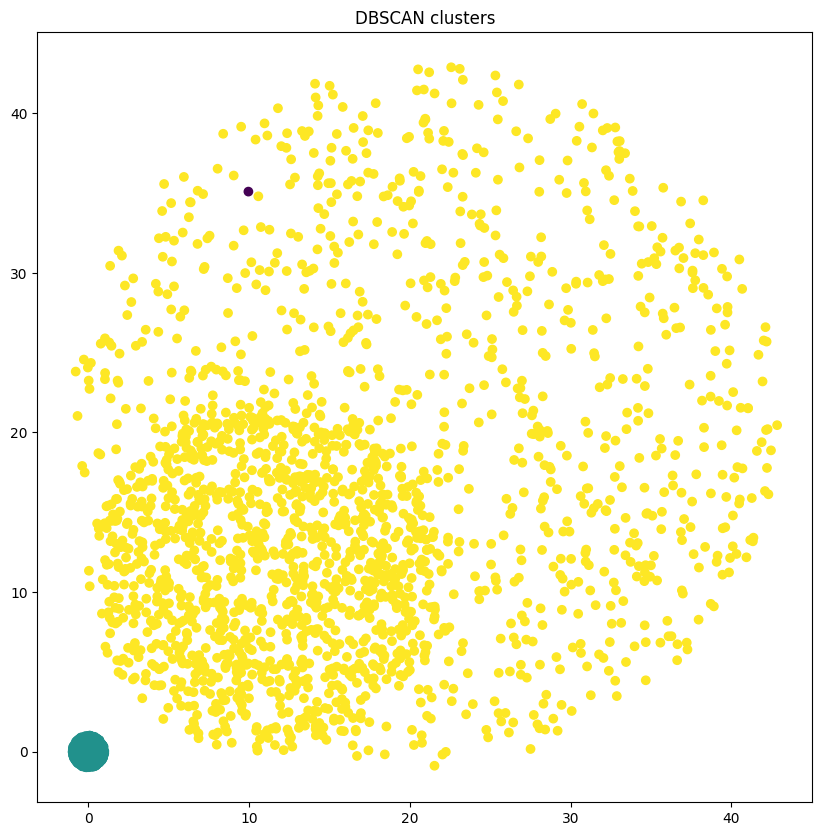

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


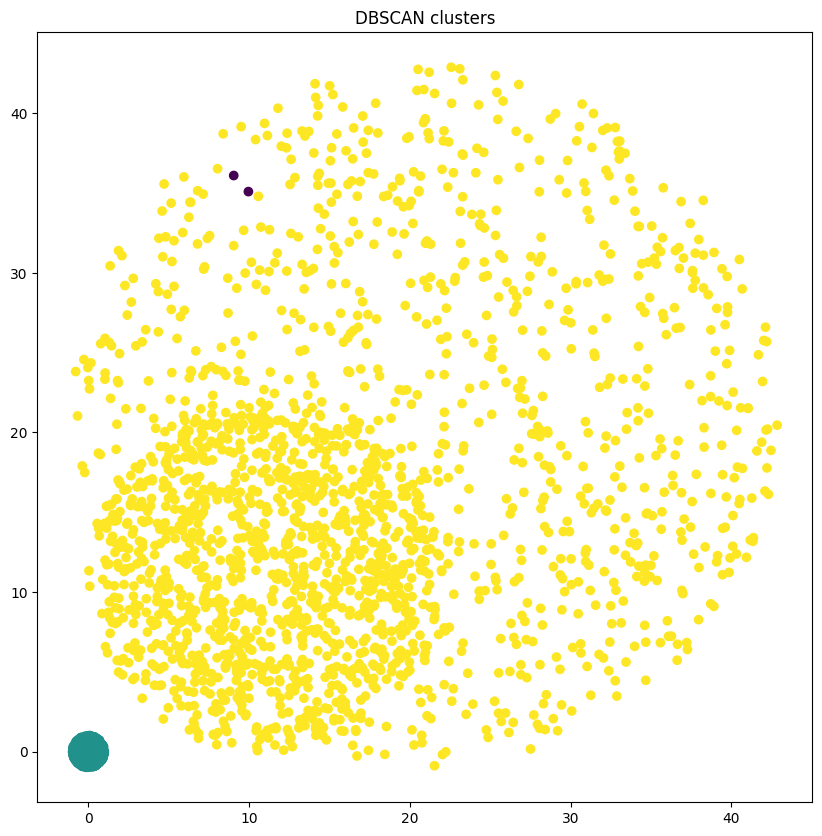

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


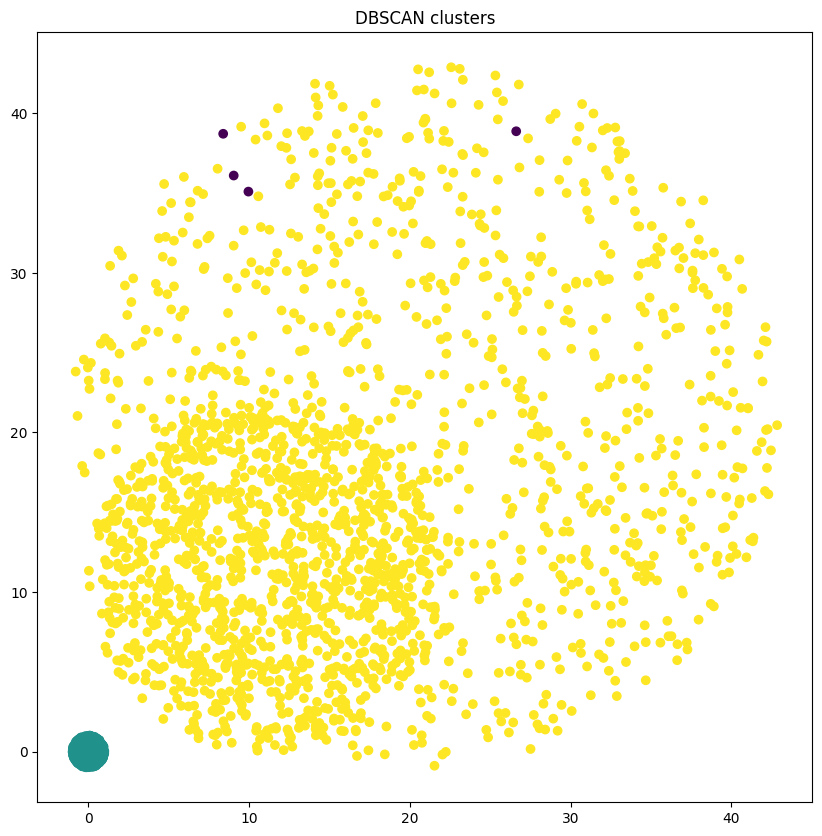

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
4


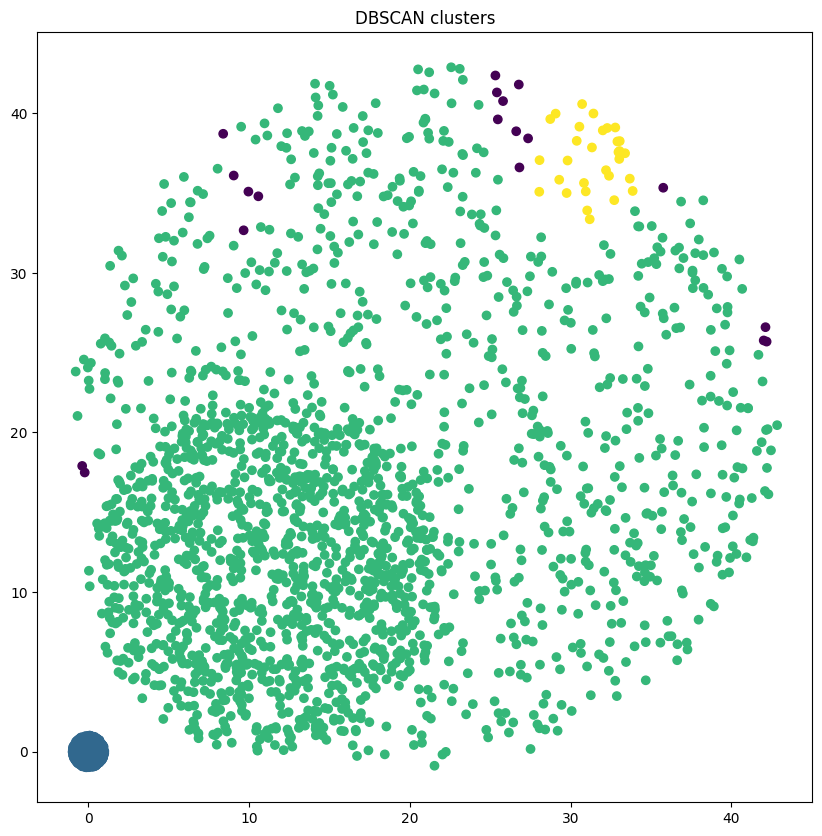

0.6766666666666666
6


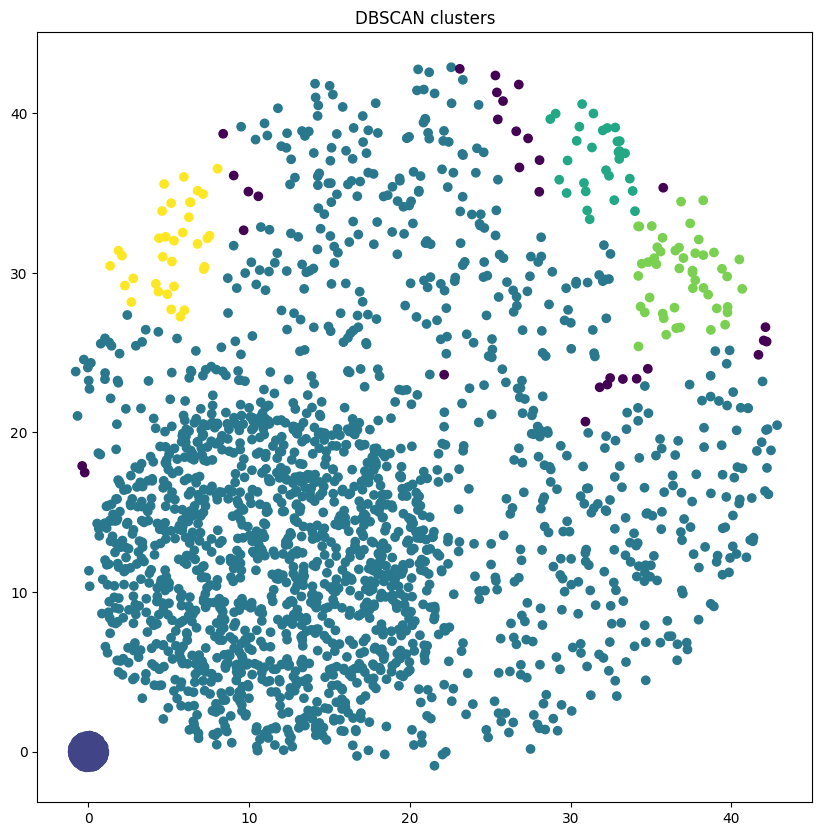

0.6763333333333333
9


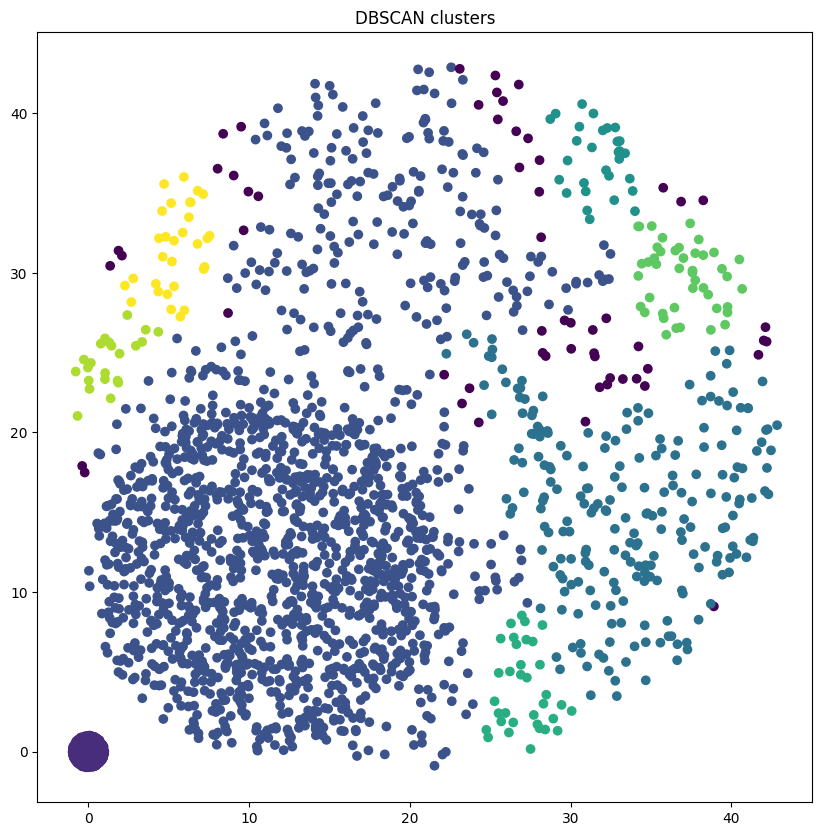

0.7403333333333333
16


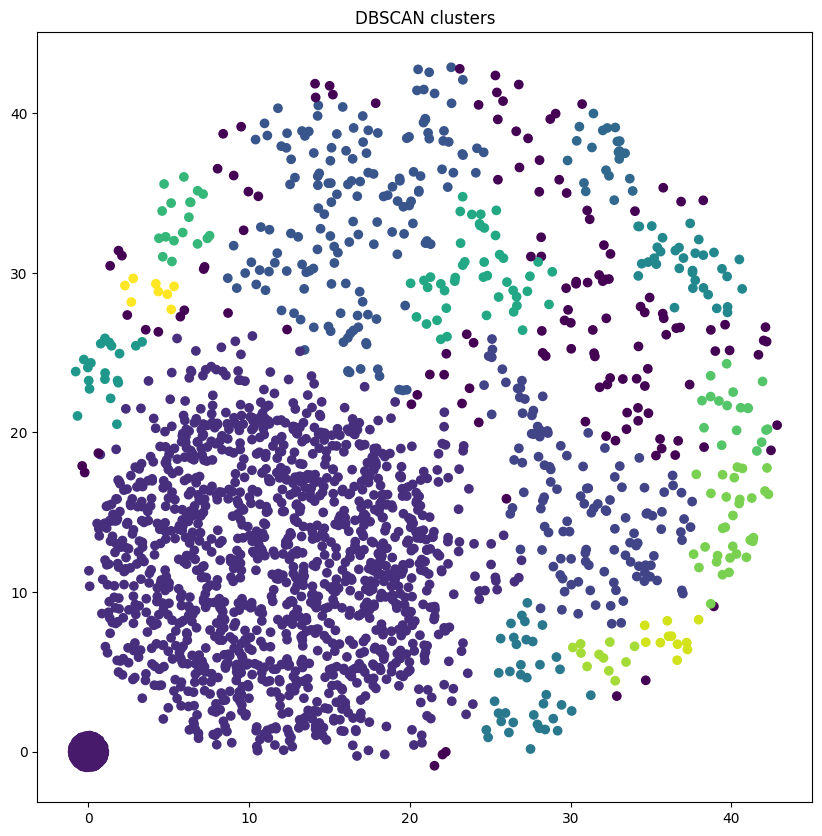

0.708
1


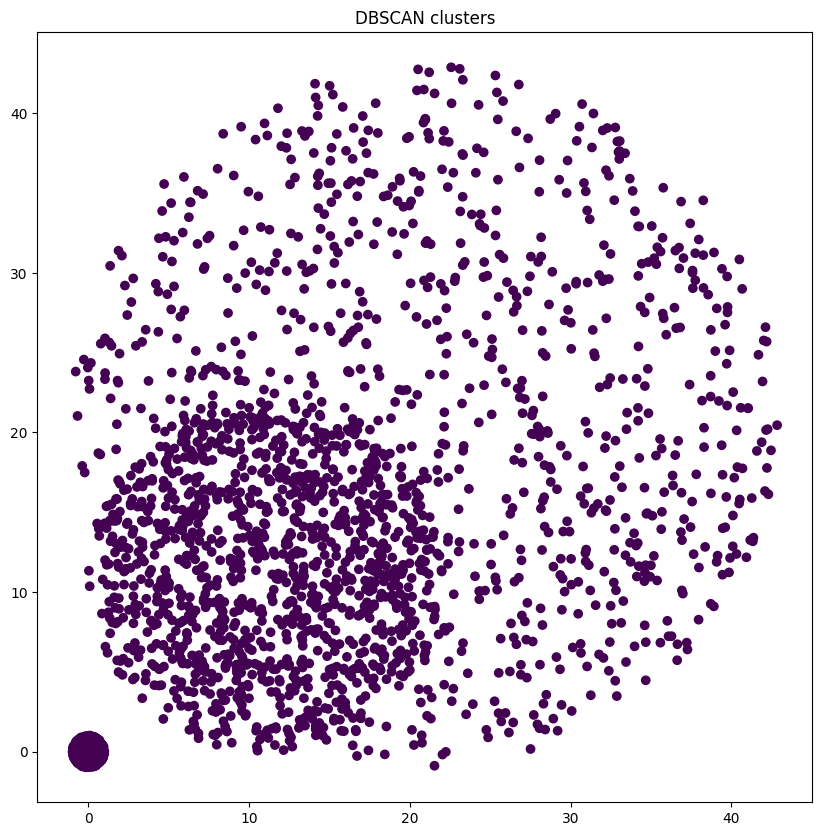

0.3333333333333333
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


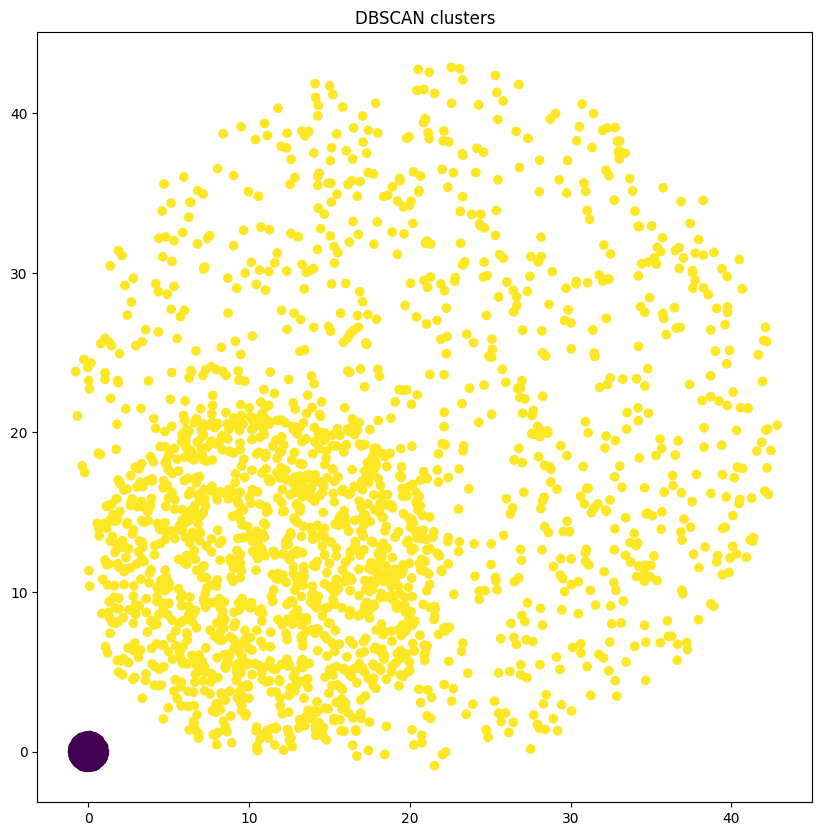

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
2


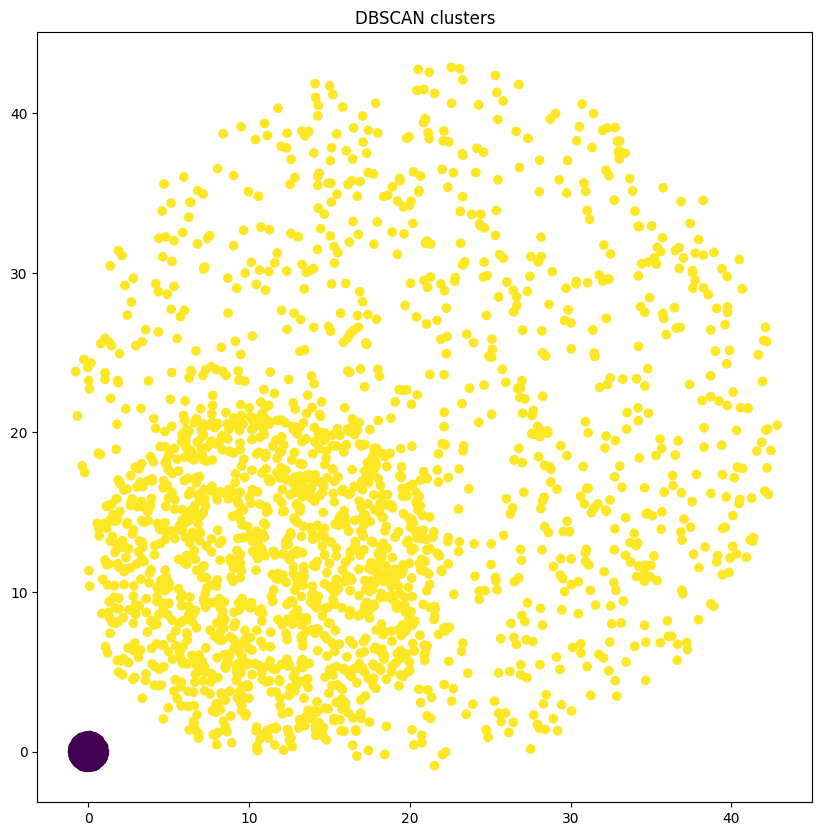

0.6666666666666666
3


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


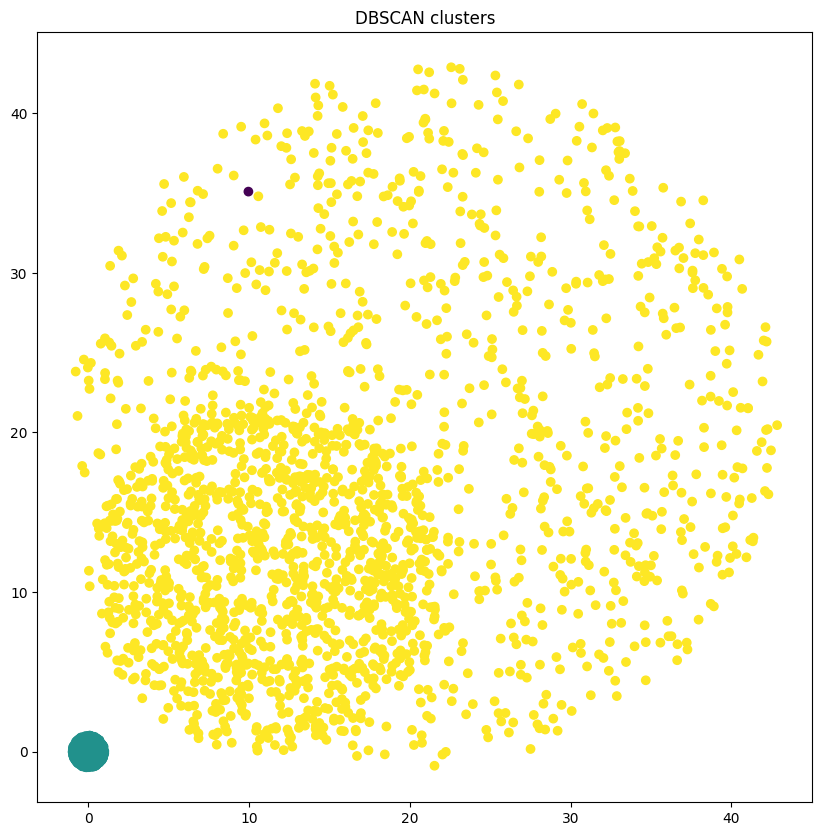

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


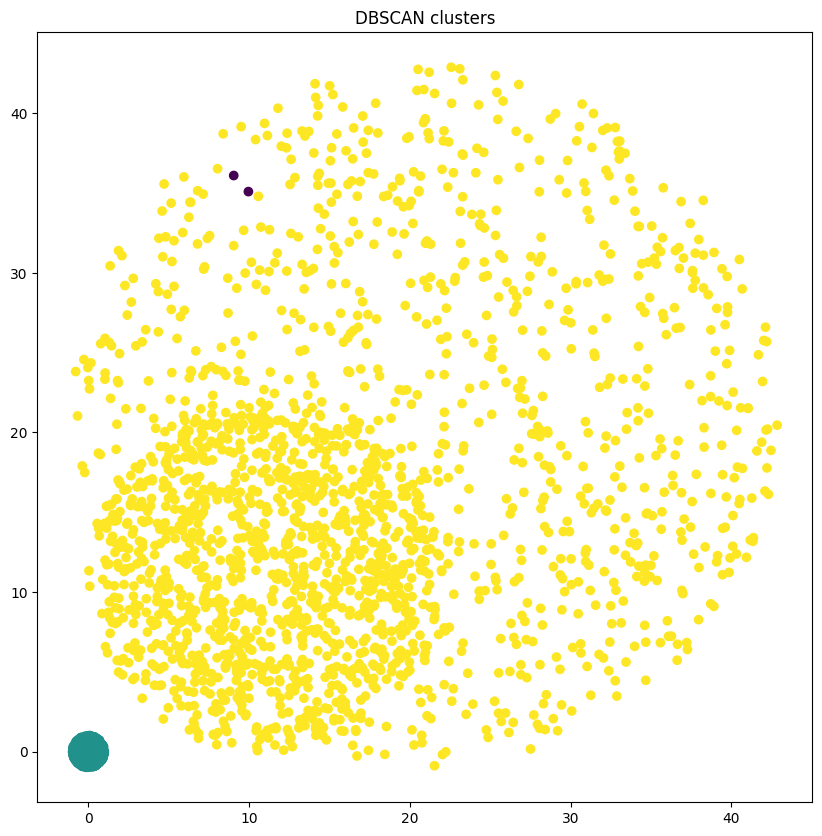

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


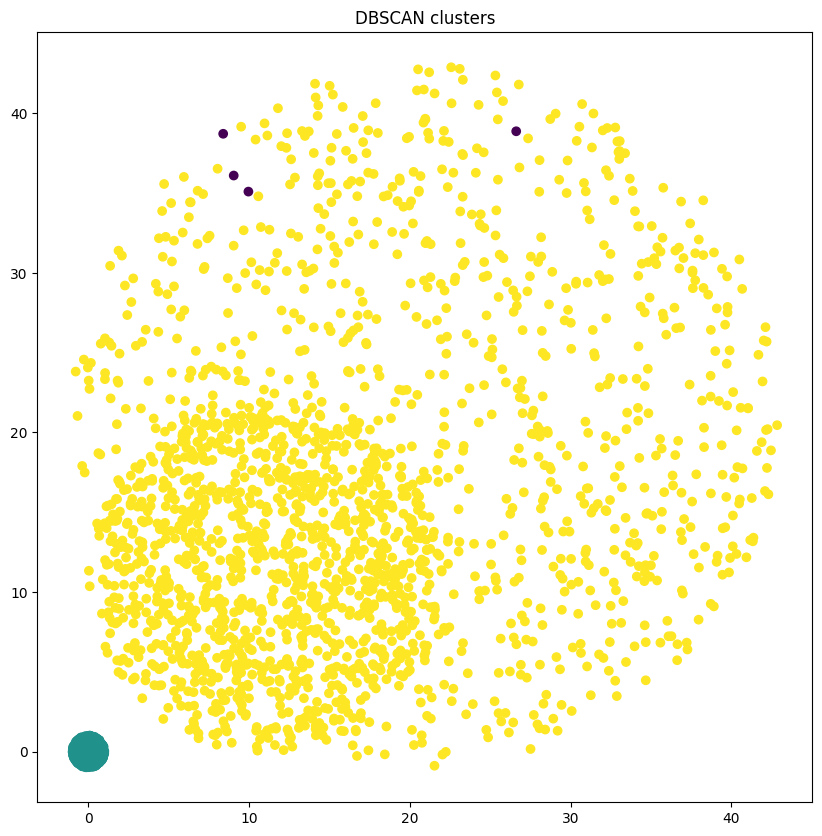

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
4


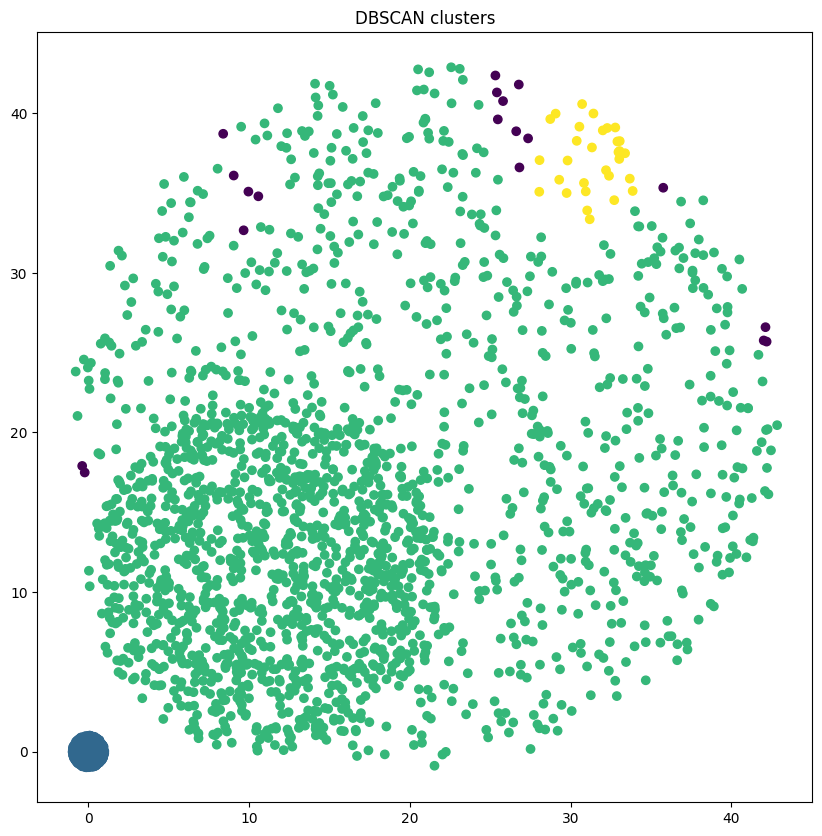

0.6766666666666666
6


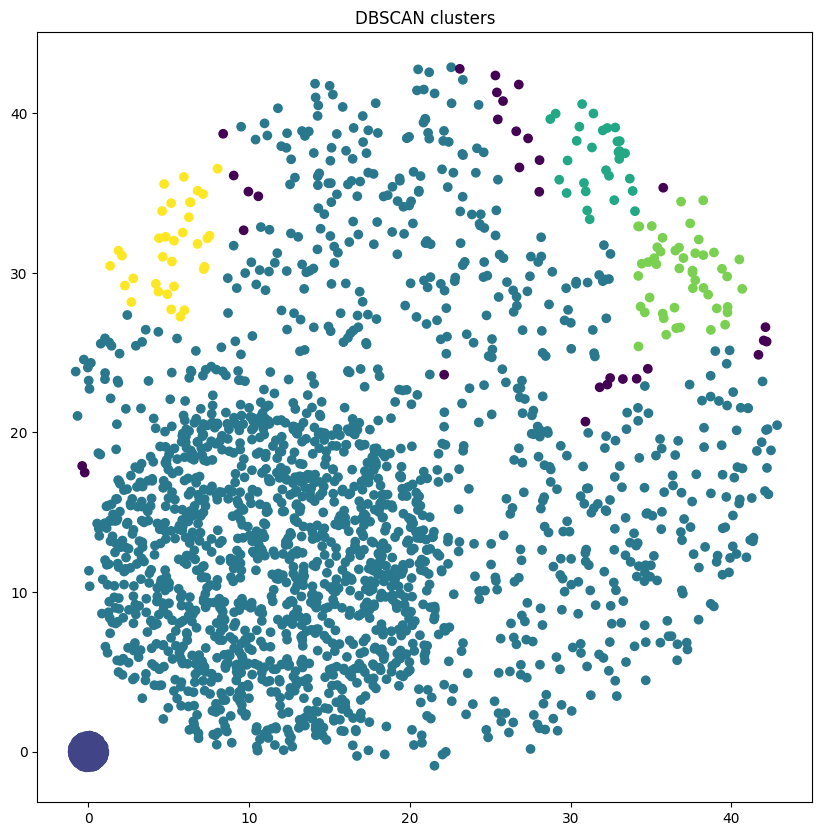

0.6763333333333333
9


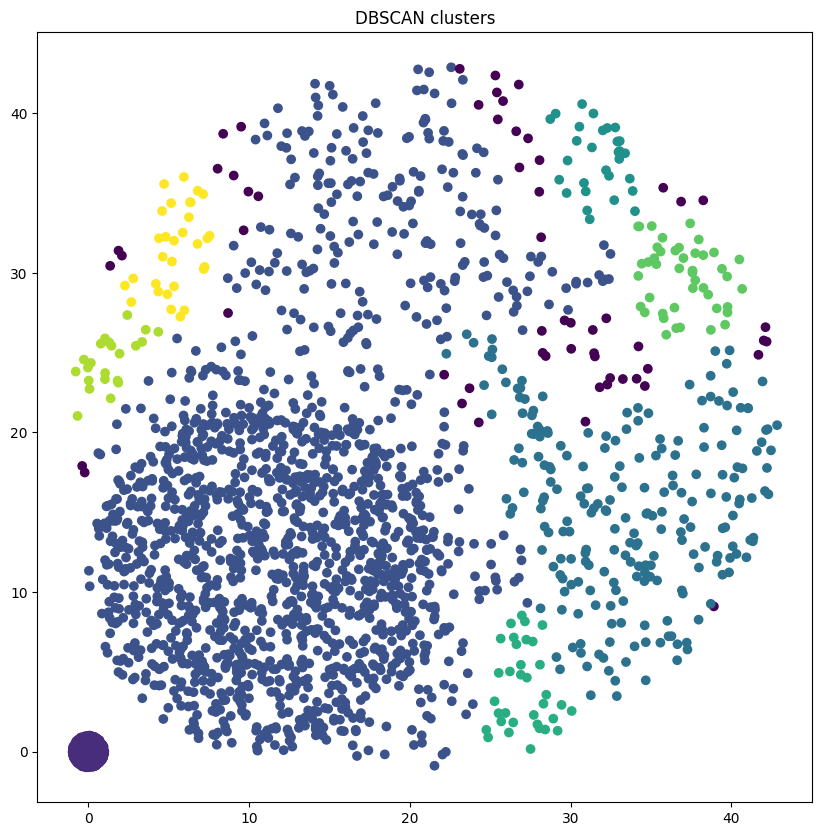

0.7403333333333333
16


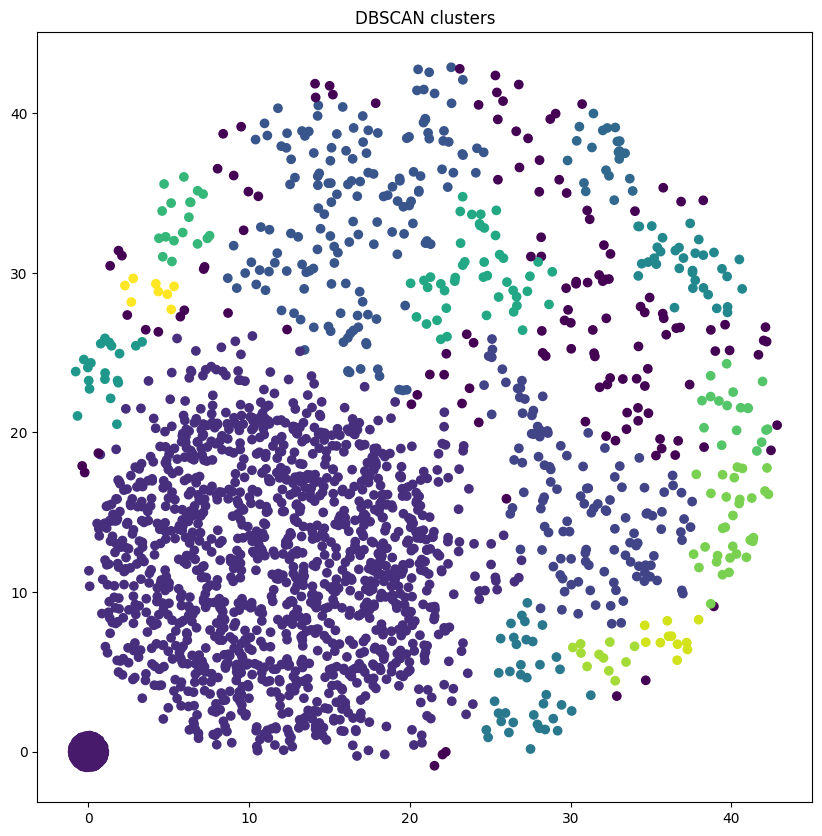

0.708
1


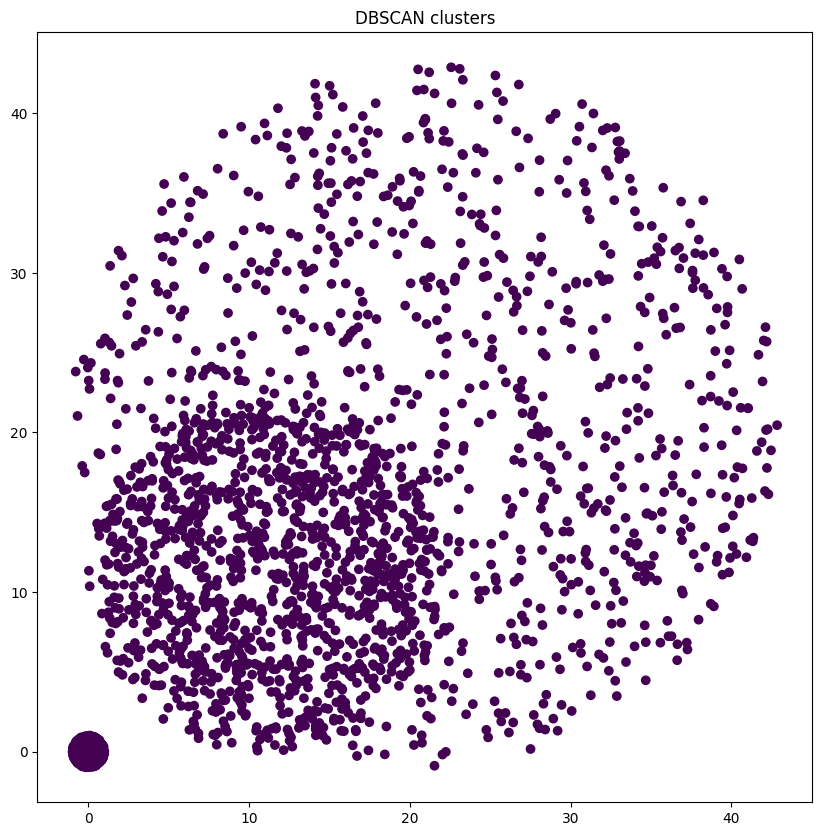

0.3333333333333333
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


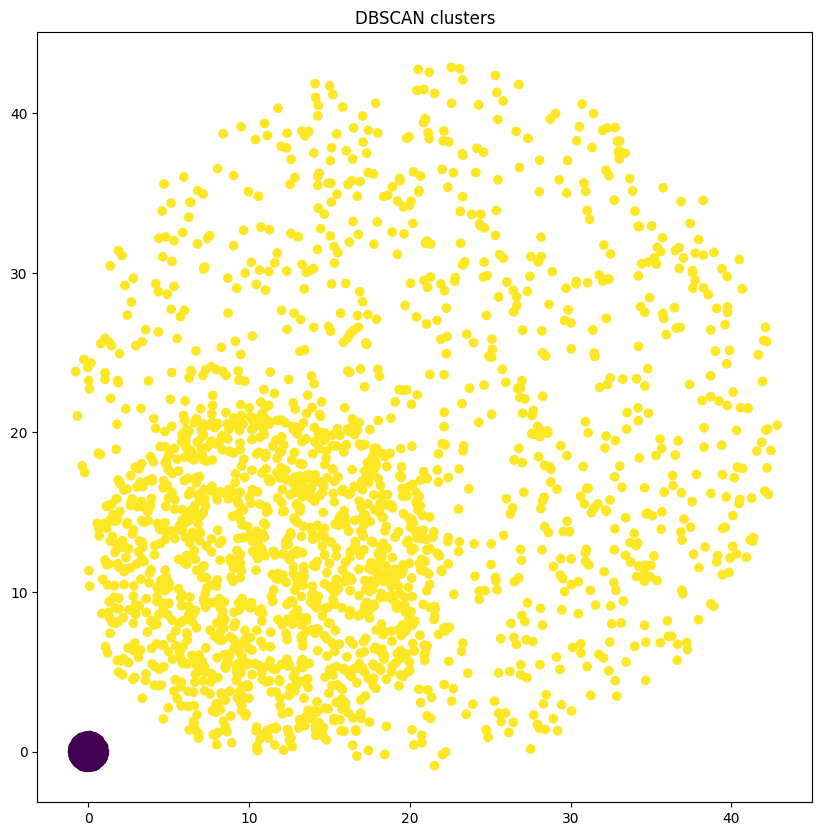

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
2


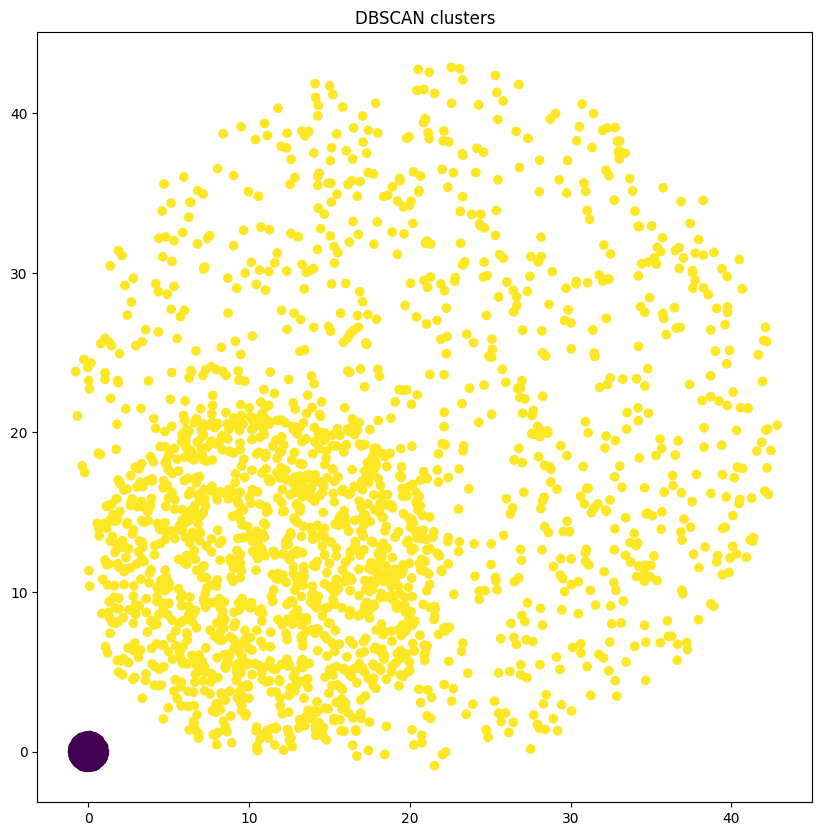

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


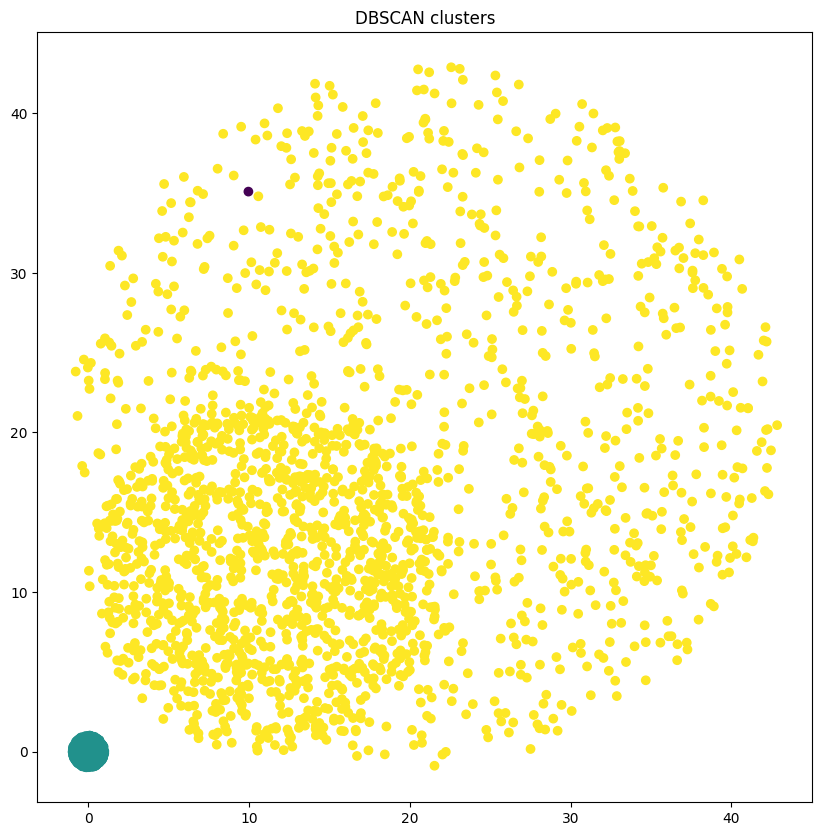

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


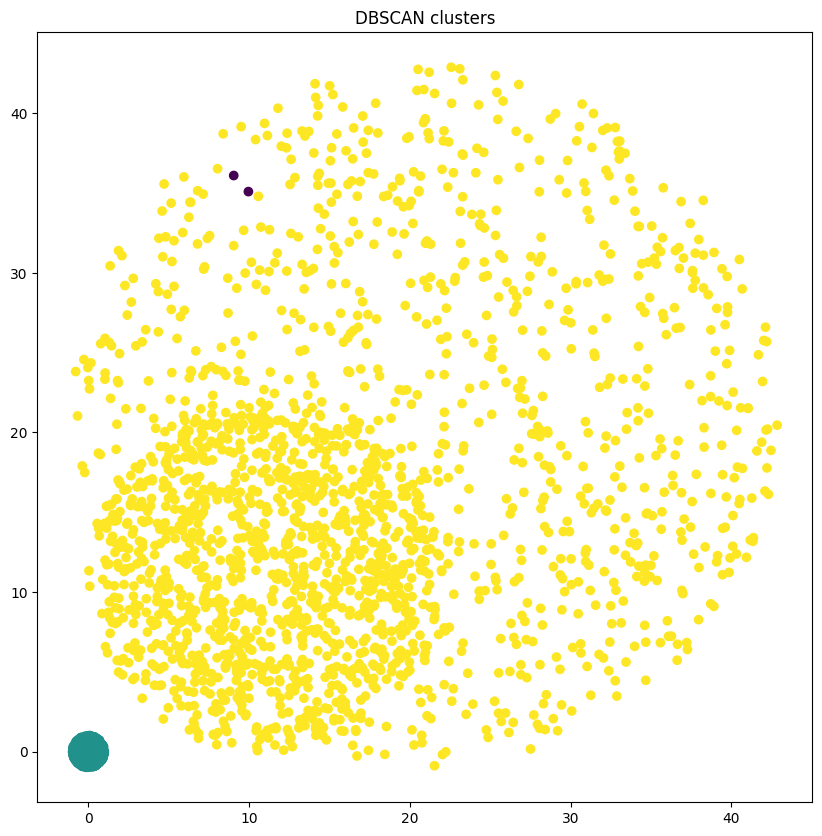

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


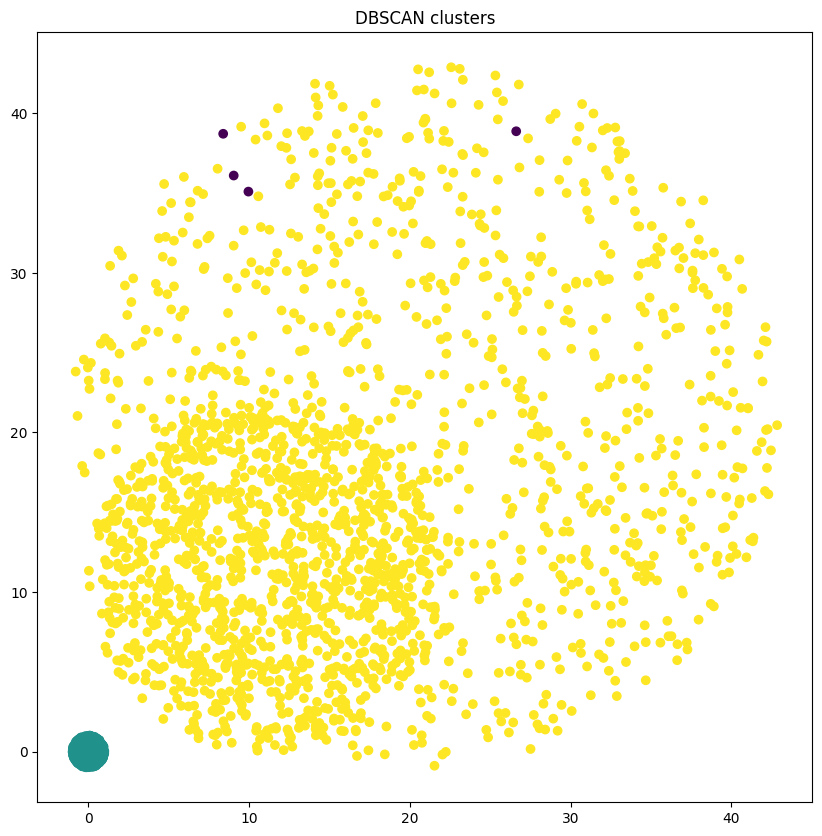

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
4


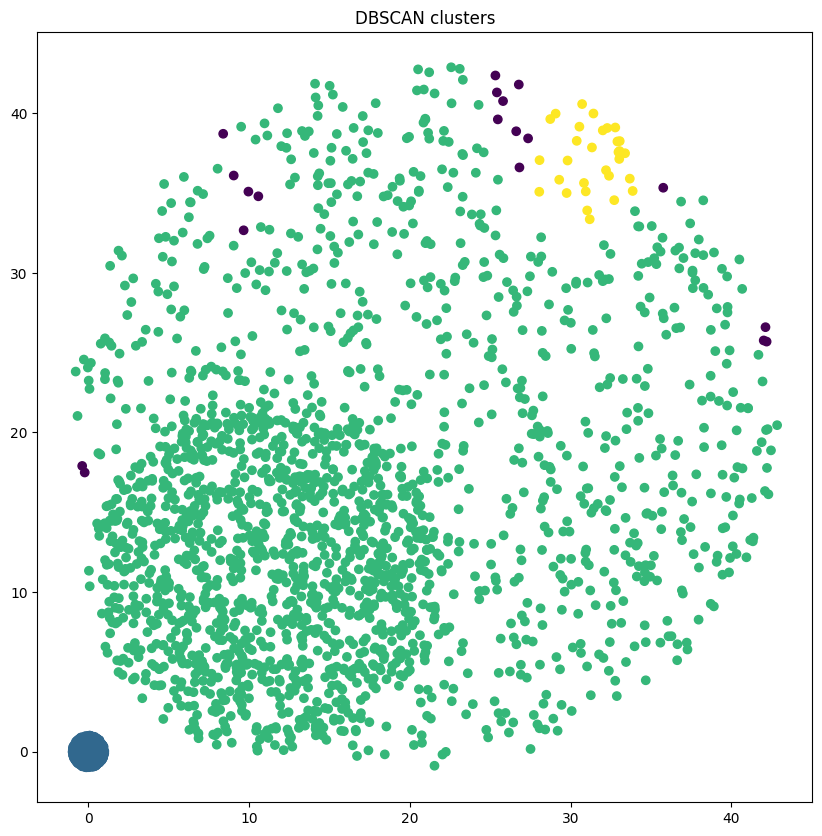

0.6766666666666666
6


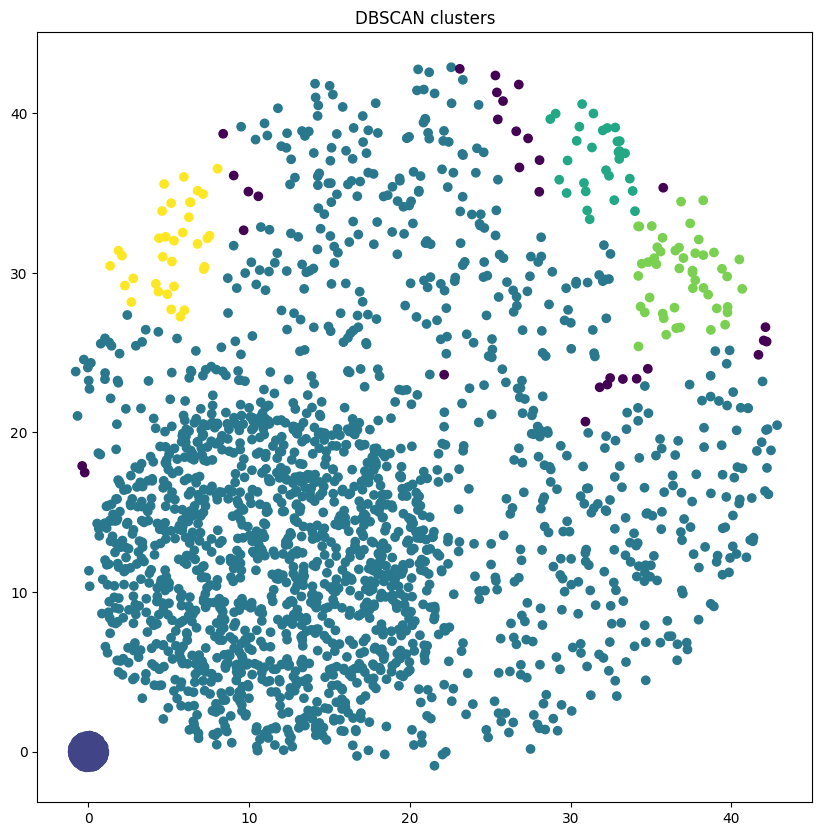

0.6763333333333333
9


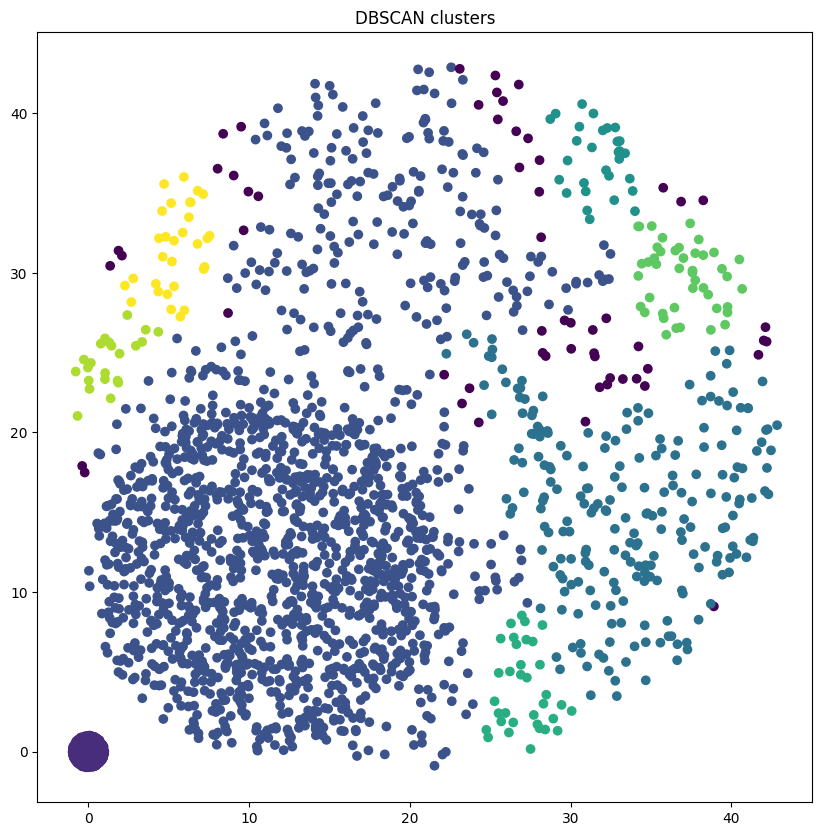

0.7403333333333333
16


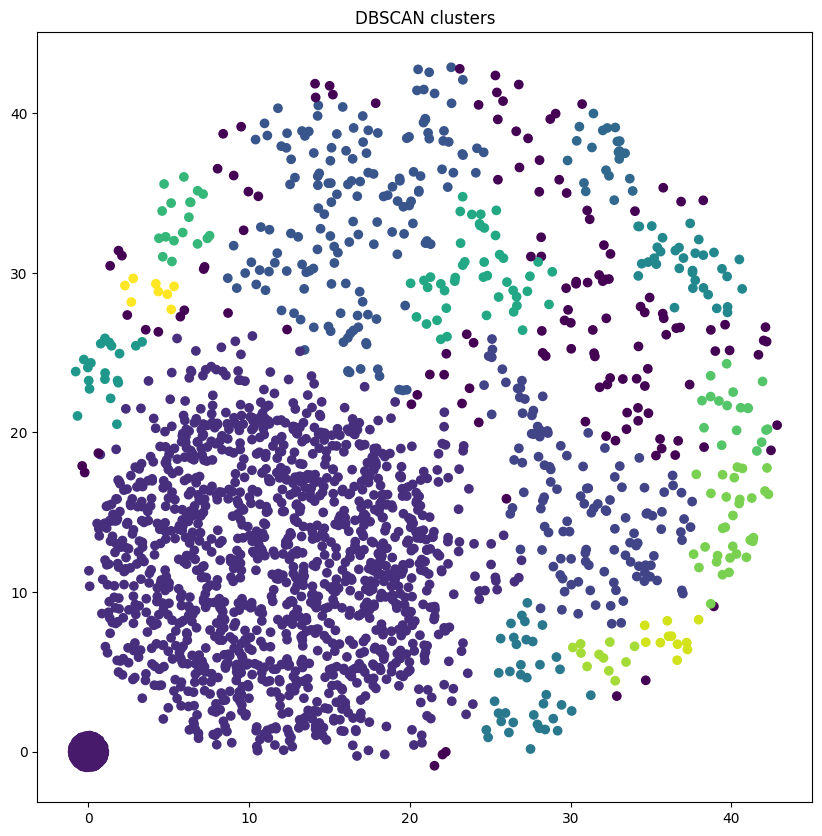

0.708
1


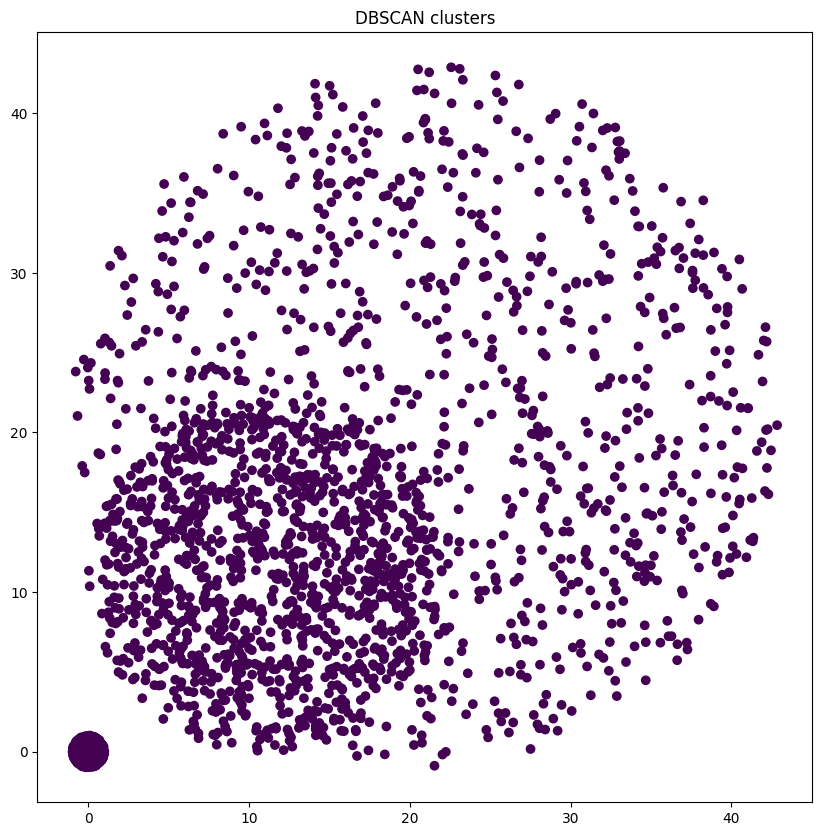

0.3333333333333333
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


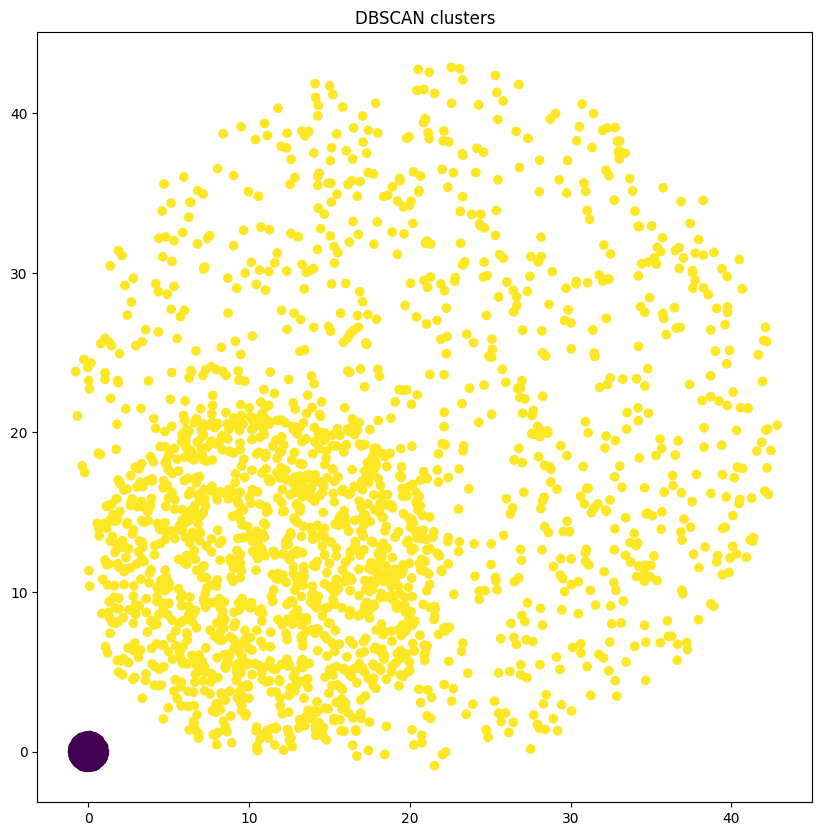

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
2


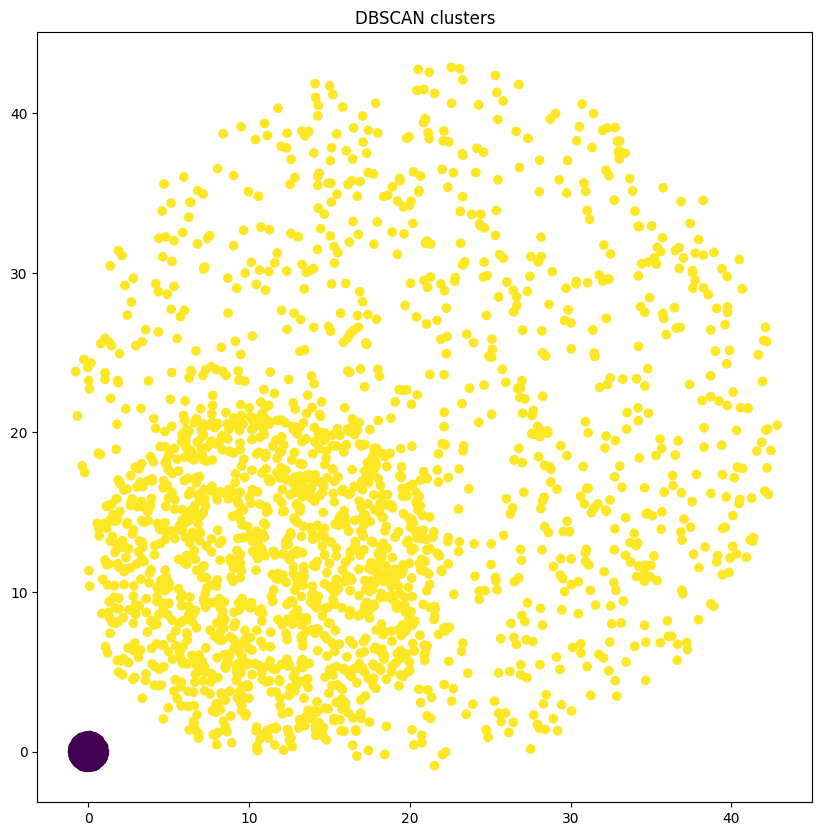

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


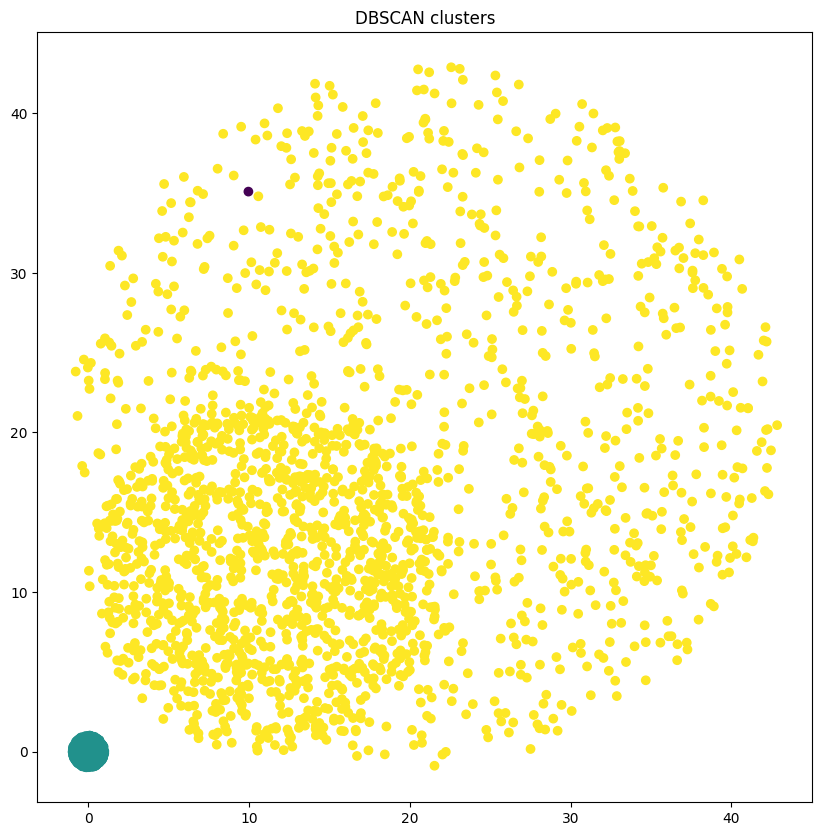

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


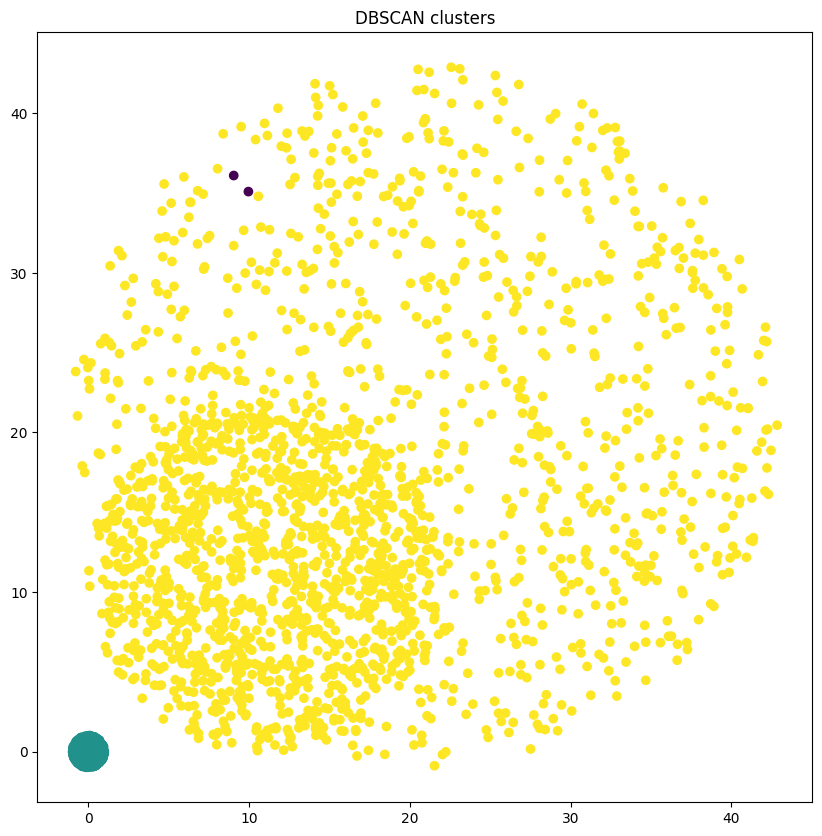

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


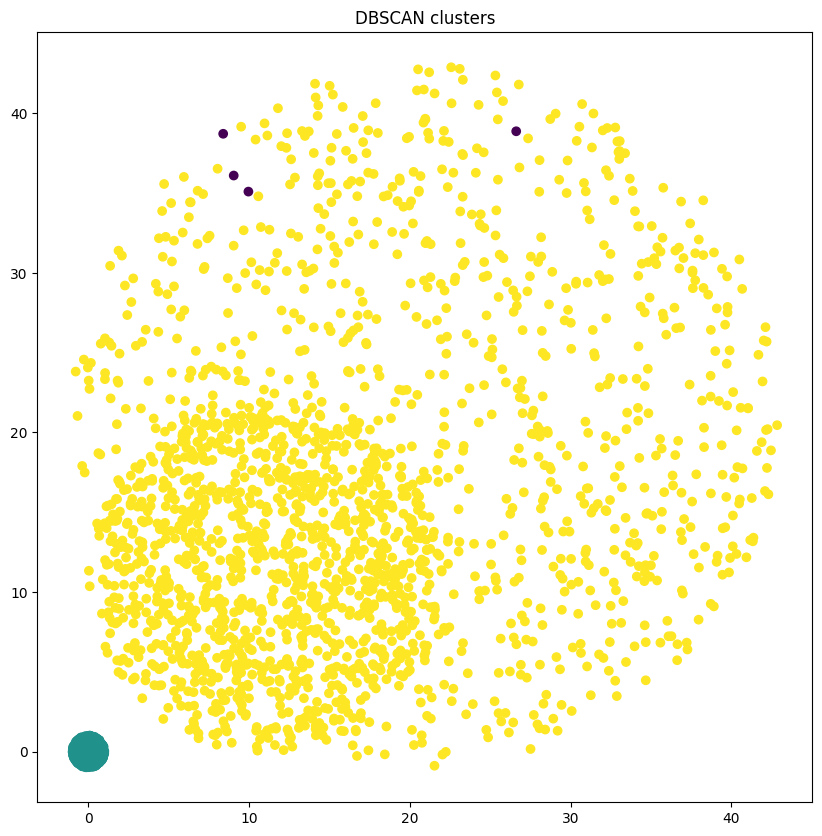

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
4


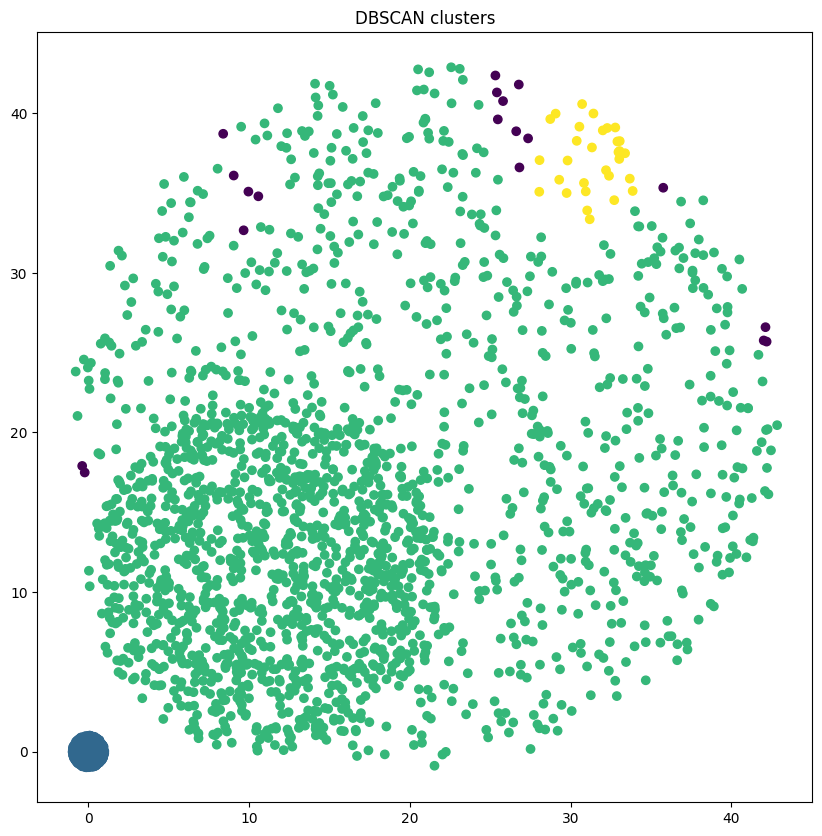

0.6766666666666666
6


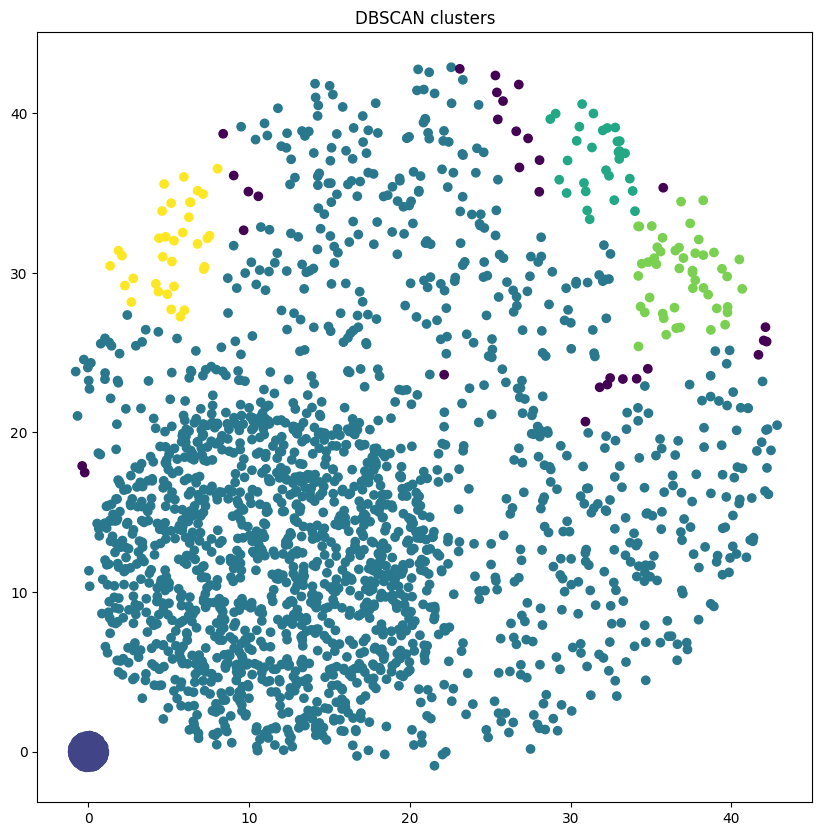

0.6763333333333333
9


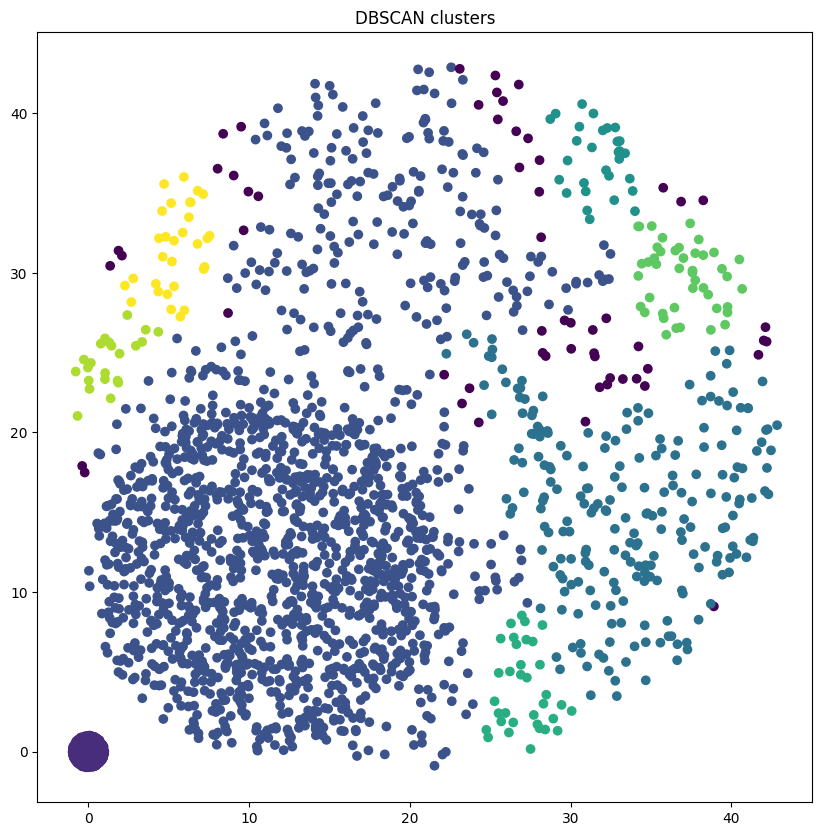

0.7403333333333333
16


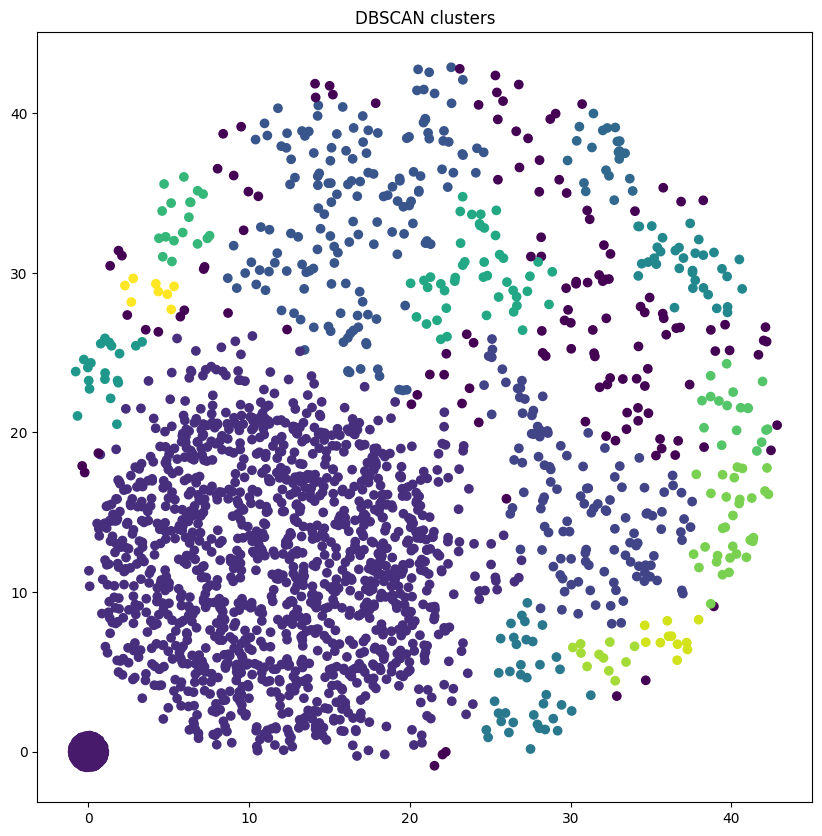

0.708
1


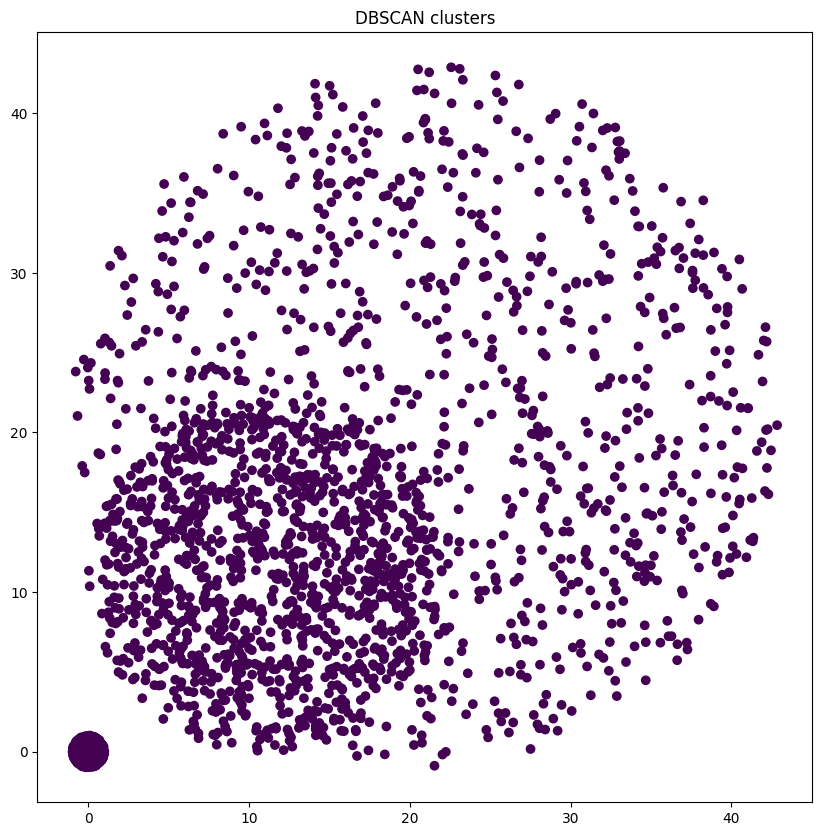

0.3333333333333333
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


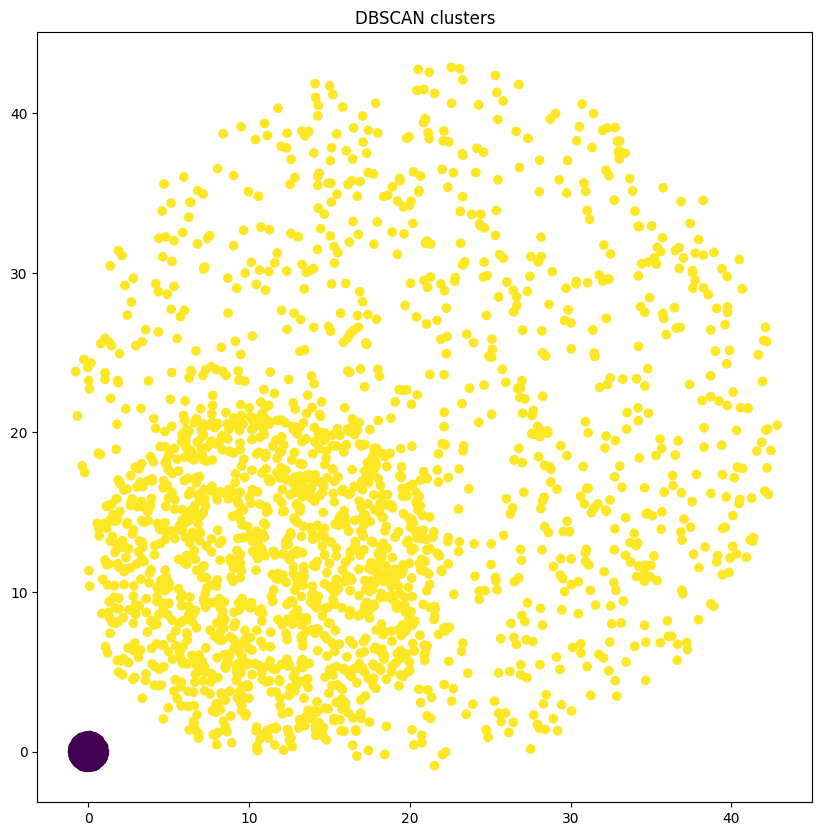

0.6666666666666666
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


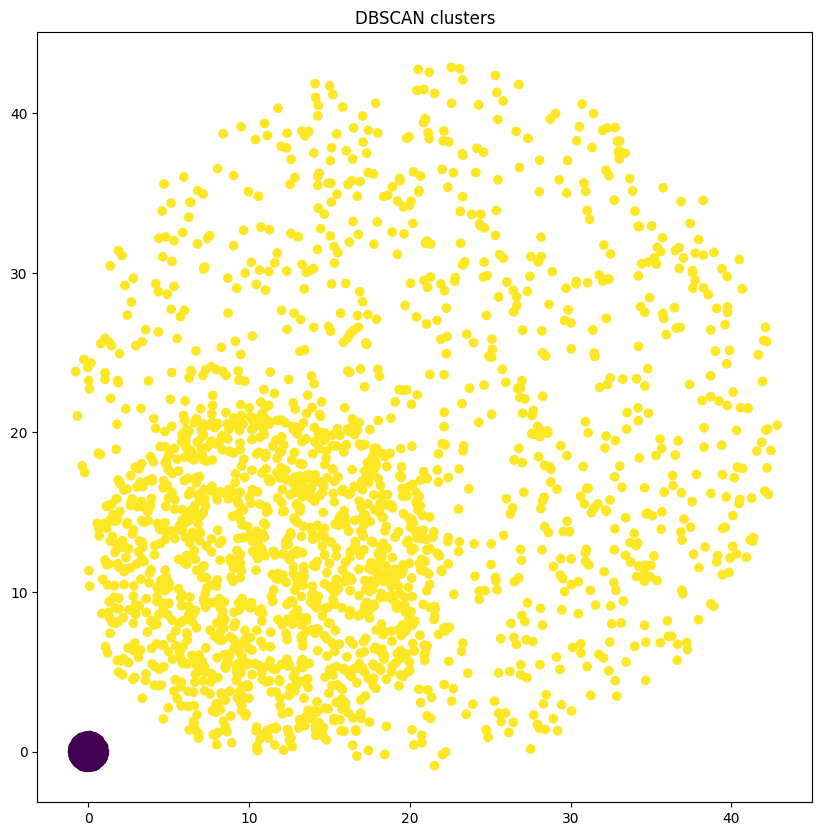

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


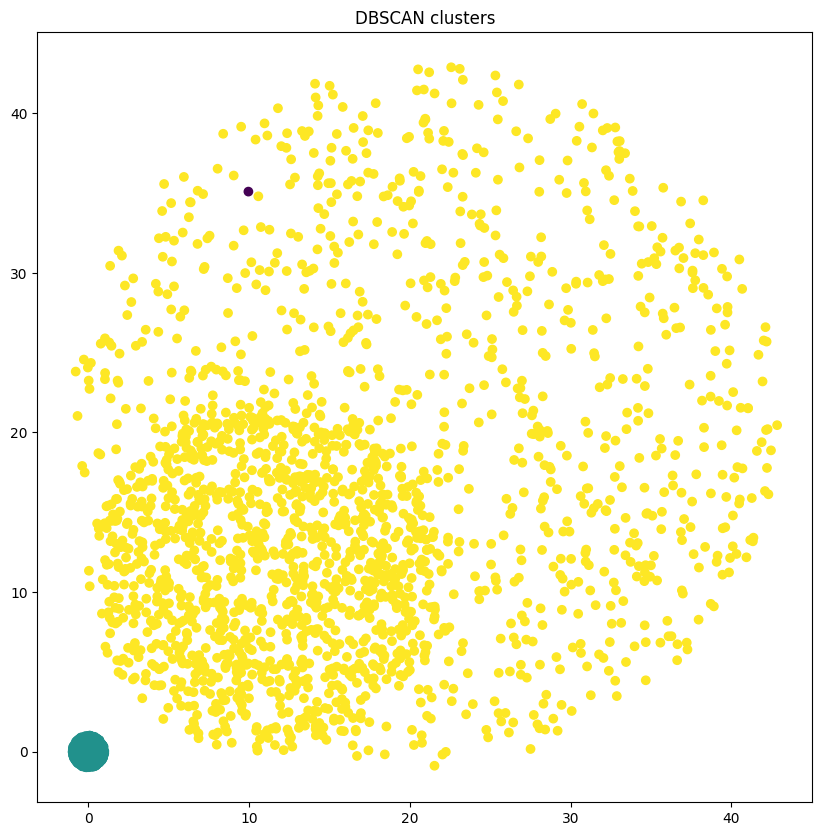

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


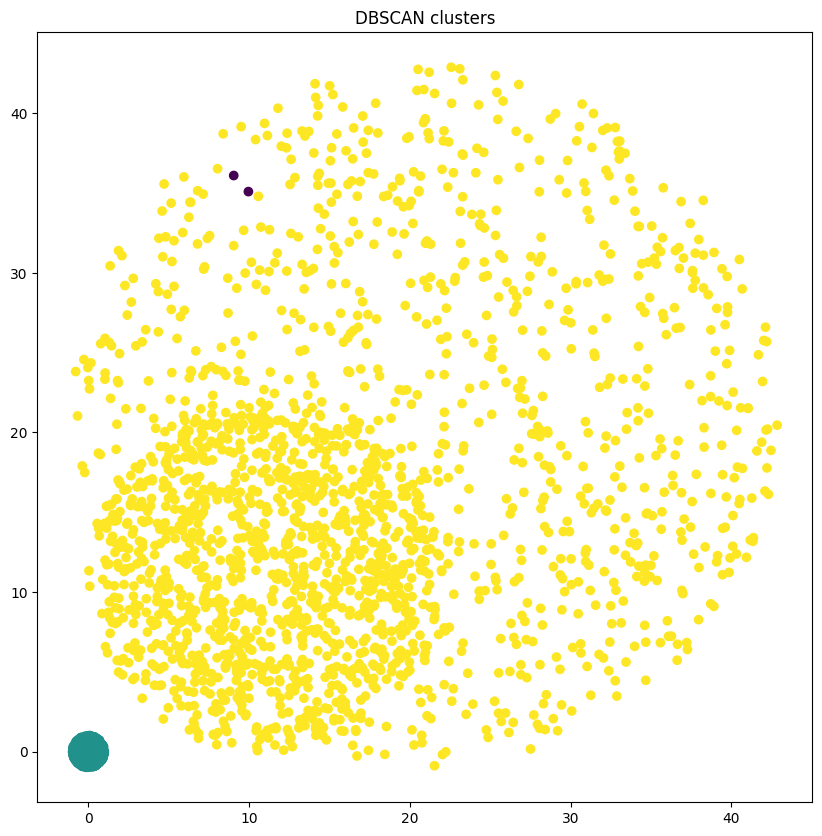

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


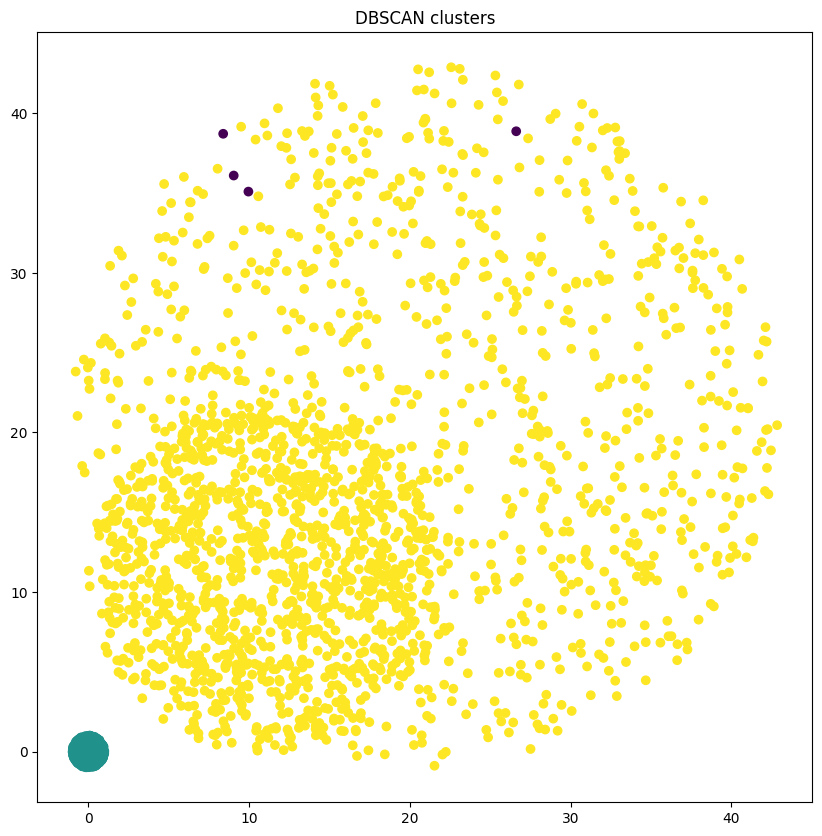

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
4


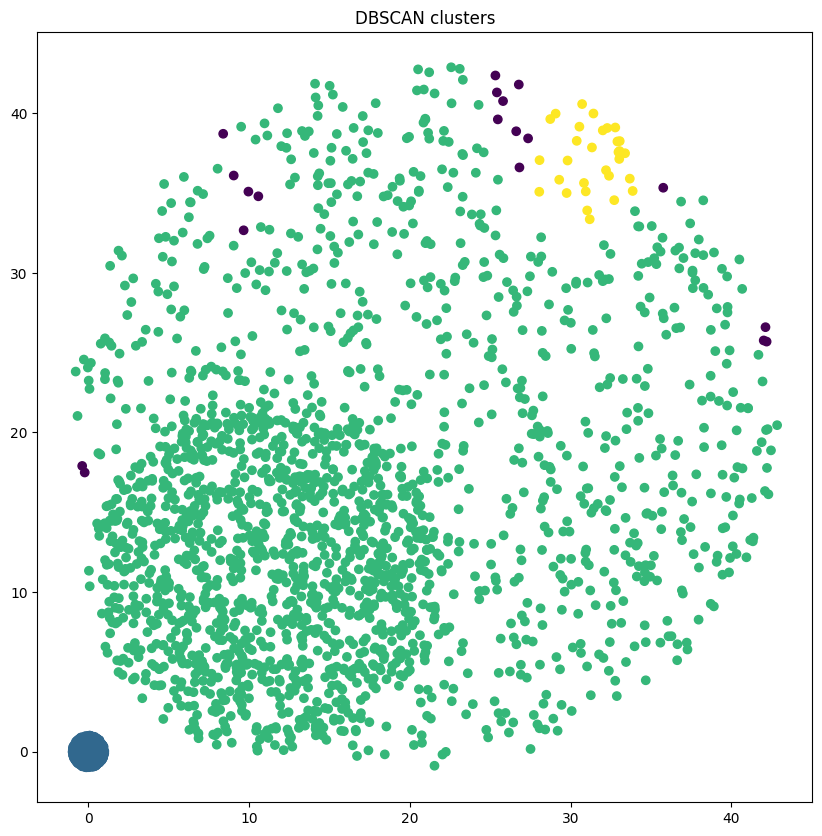

0.6766666666666666
6


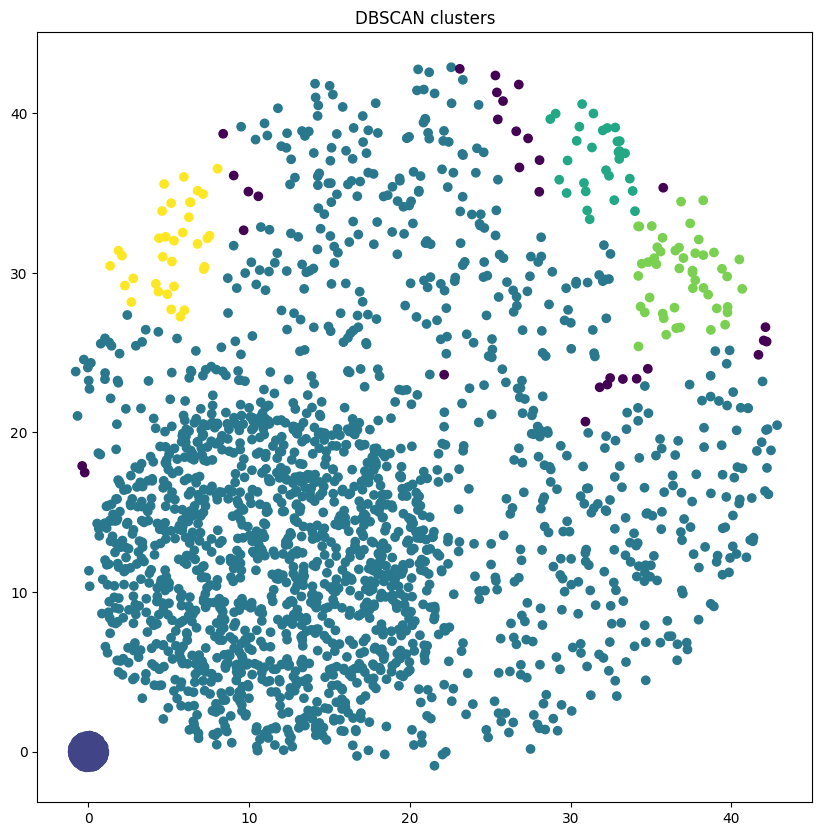

0.6763333333333333
9


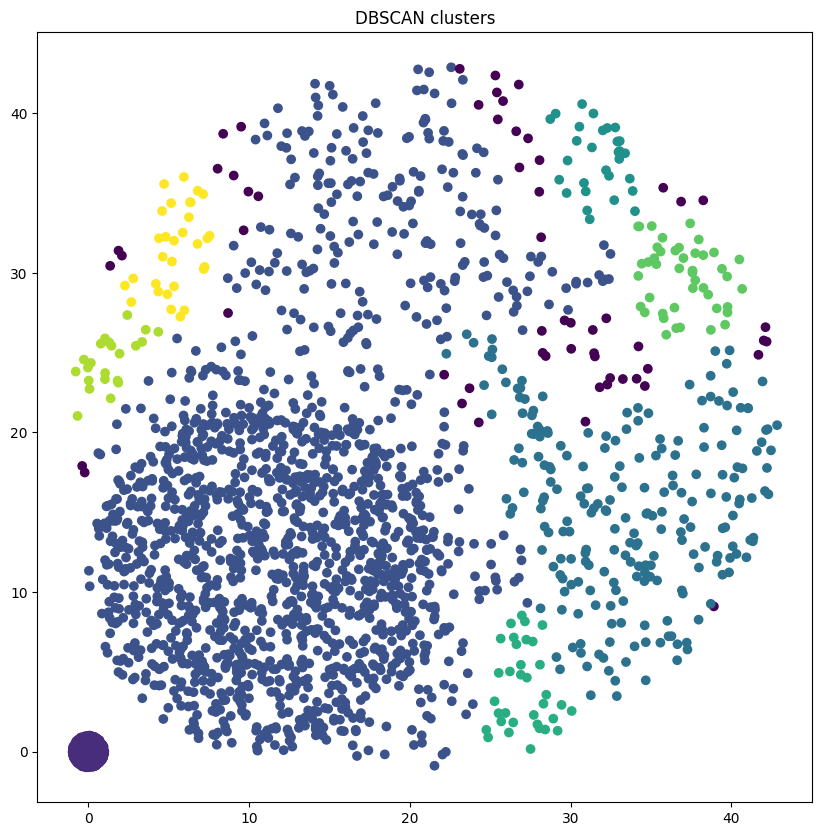

0.7403333333333333
16


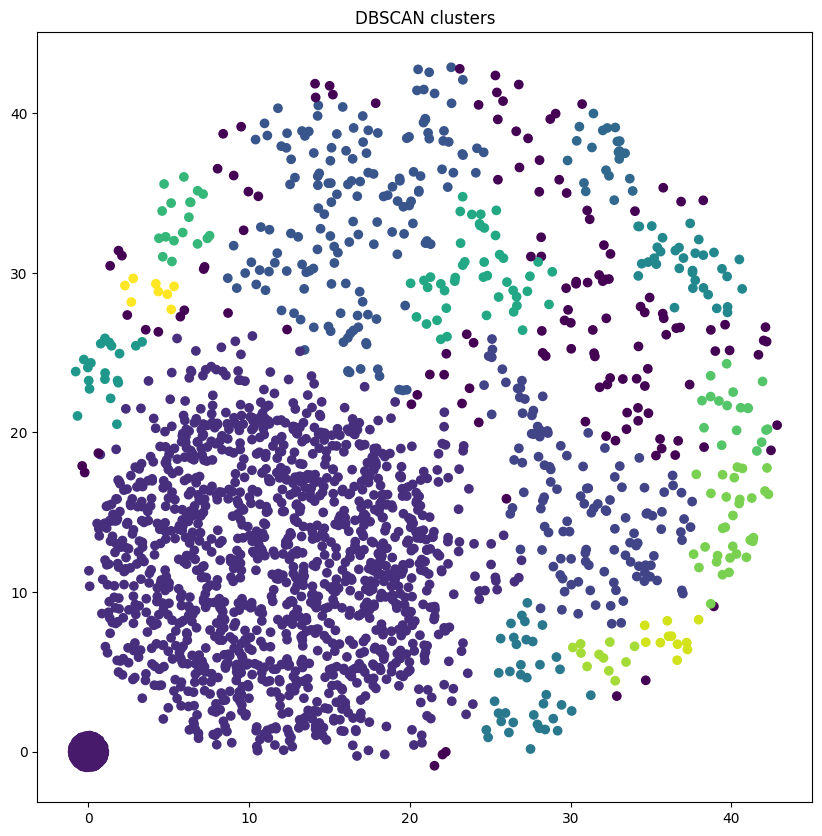

0.708
1


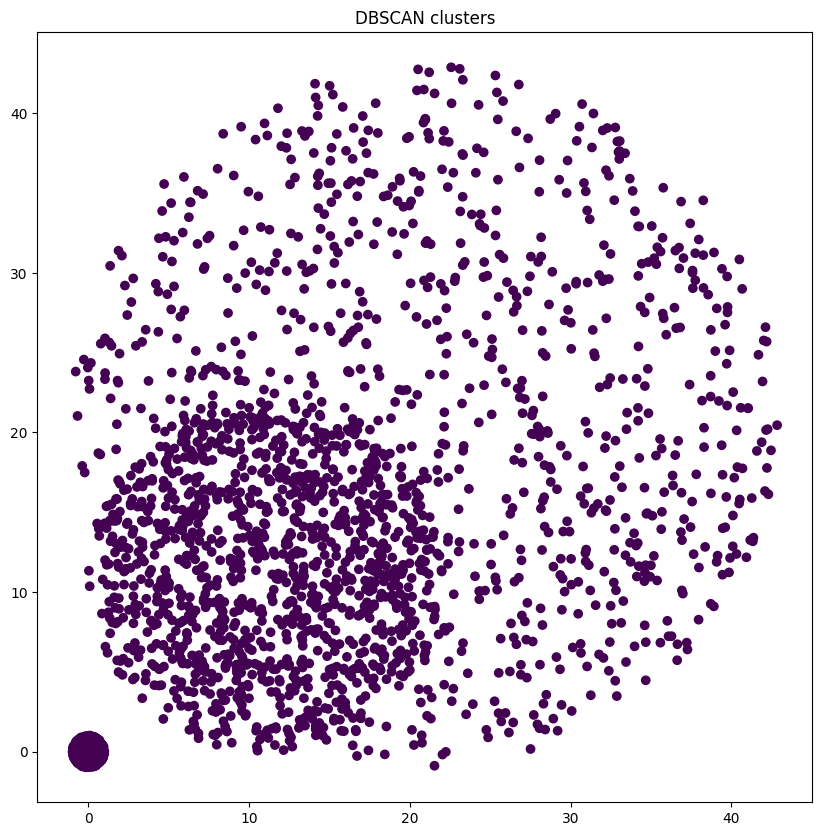

0.3333333333333333
2


/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


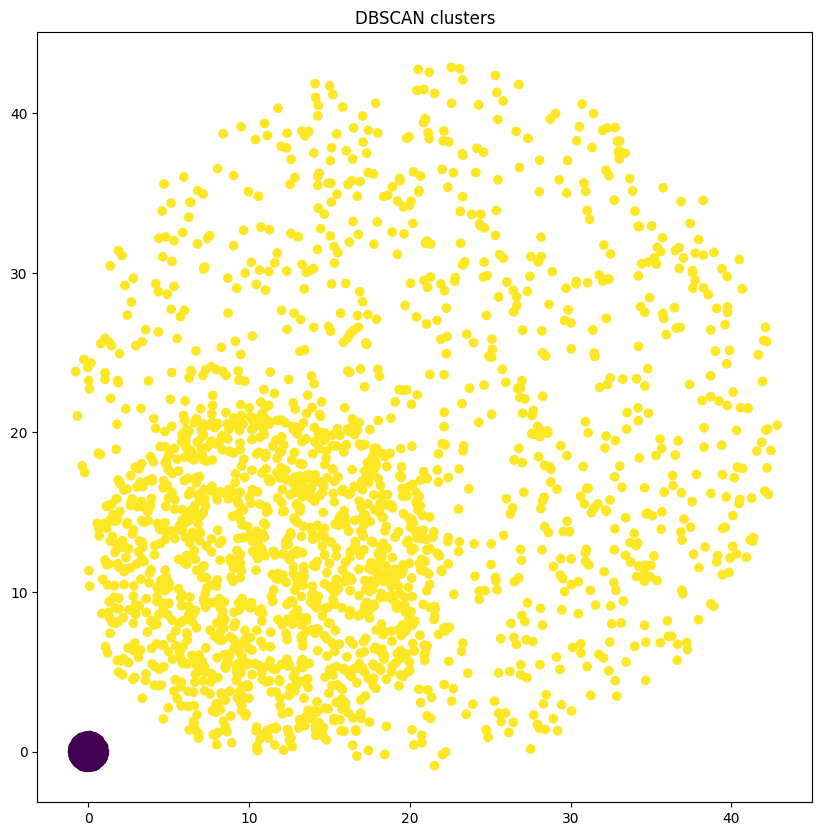

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
2


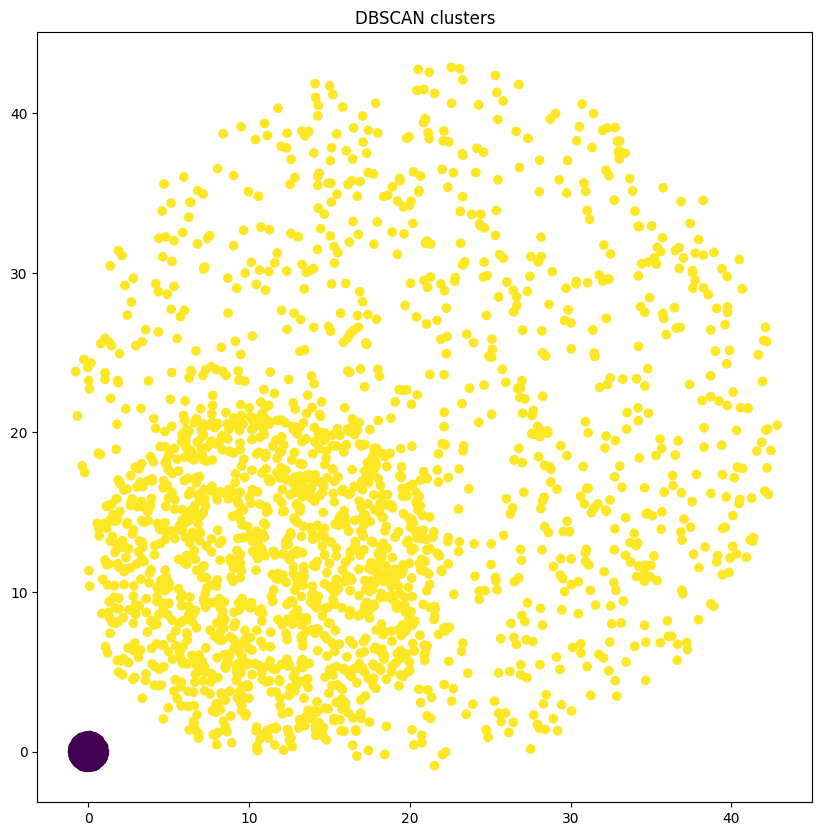

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


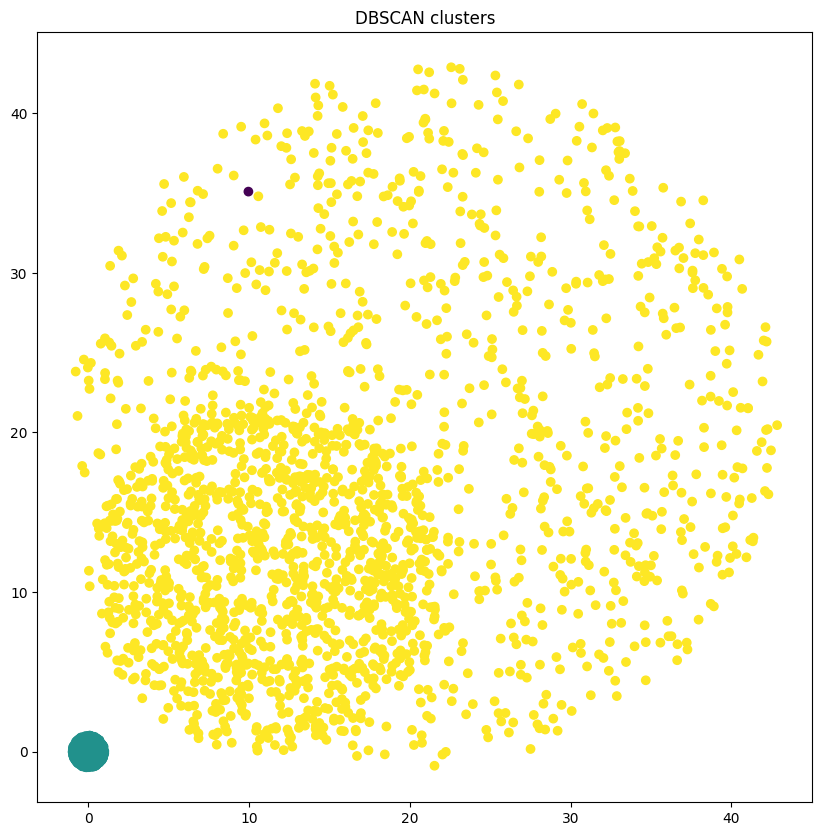

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


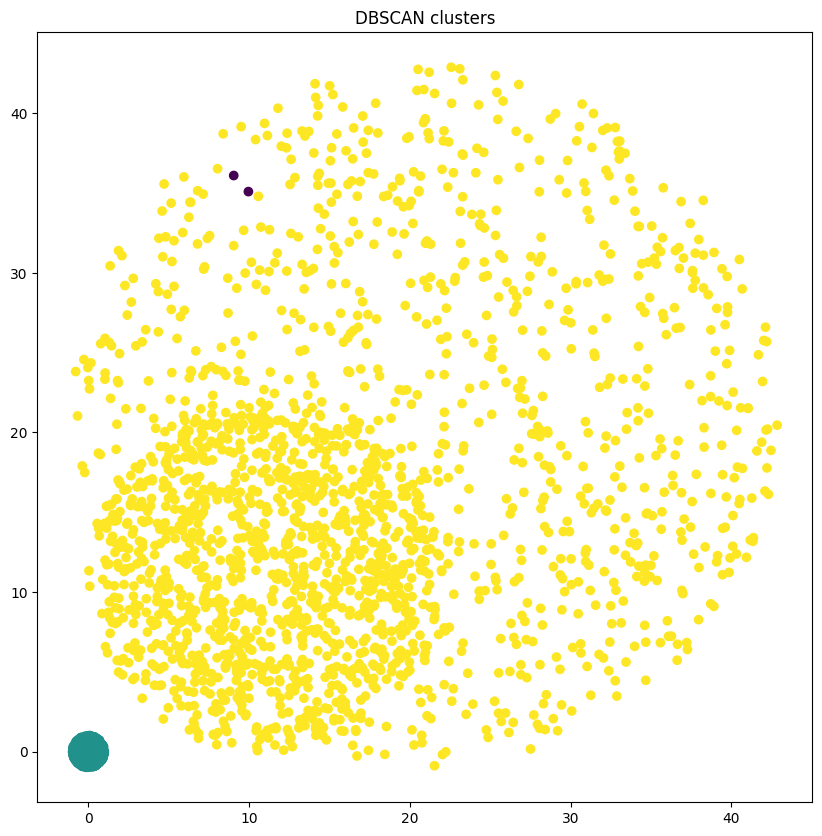

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
3


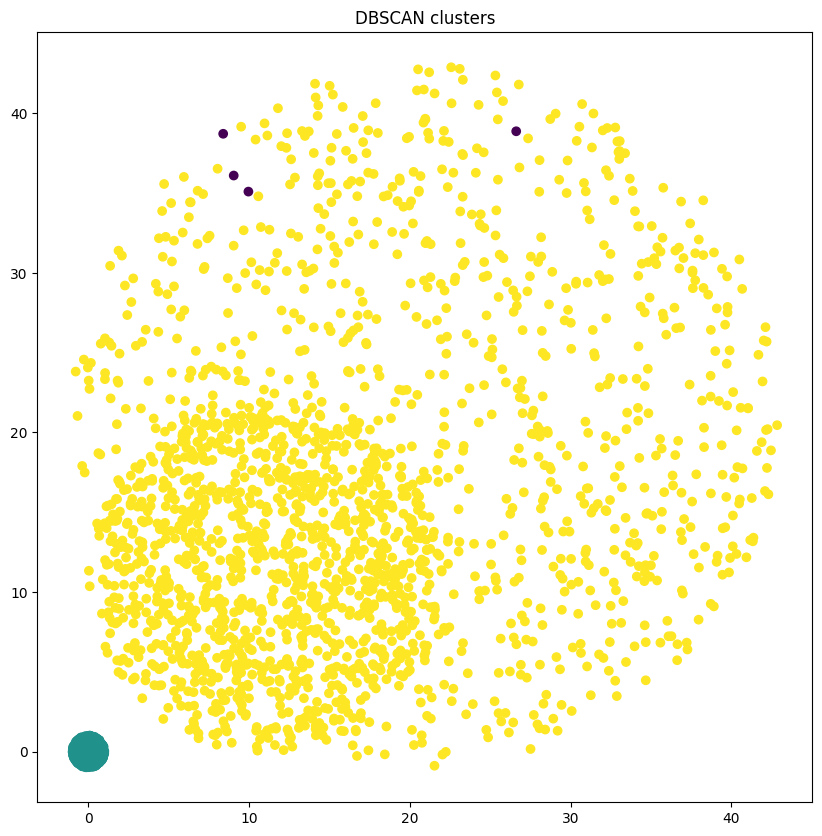

/var/folders/4b/06ymqbhd3c785p2vvkrn8r5m0000gn/T/ipykernel_8182/1431300144.py:20: RuntimeWarning: invalid value encountered in cast
  predicted_labels_mapped[mask] = mode(true_labels[mask])[0]


0.6666666666666666
4


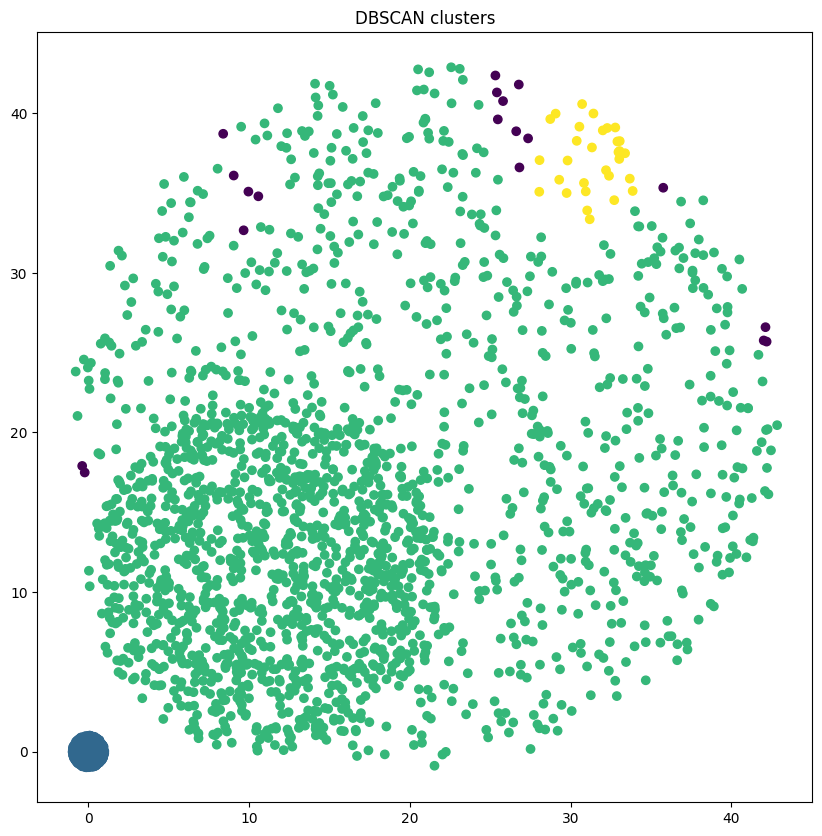

0.6766666666666666
6


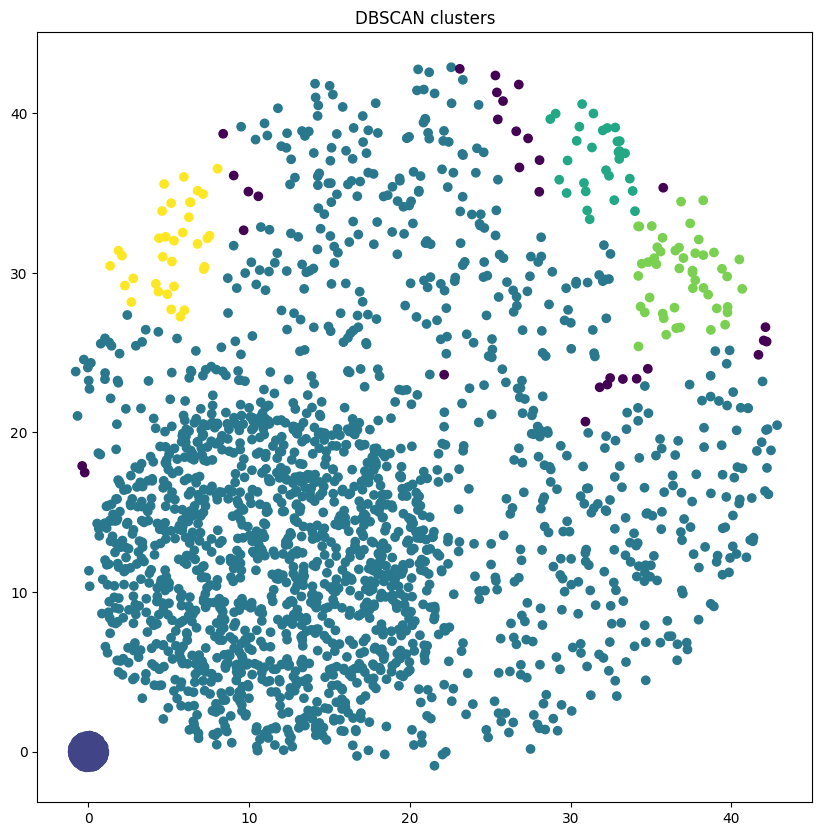

0.6763333333333333
9


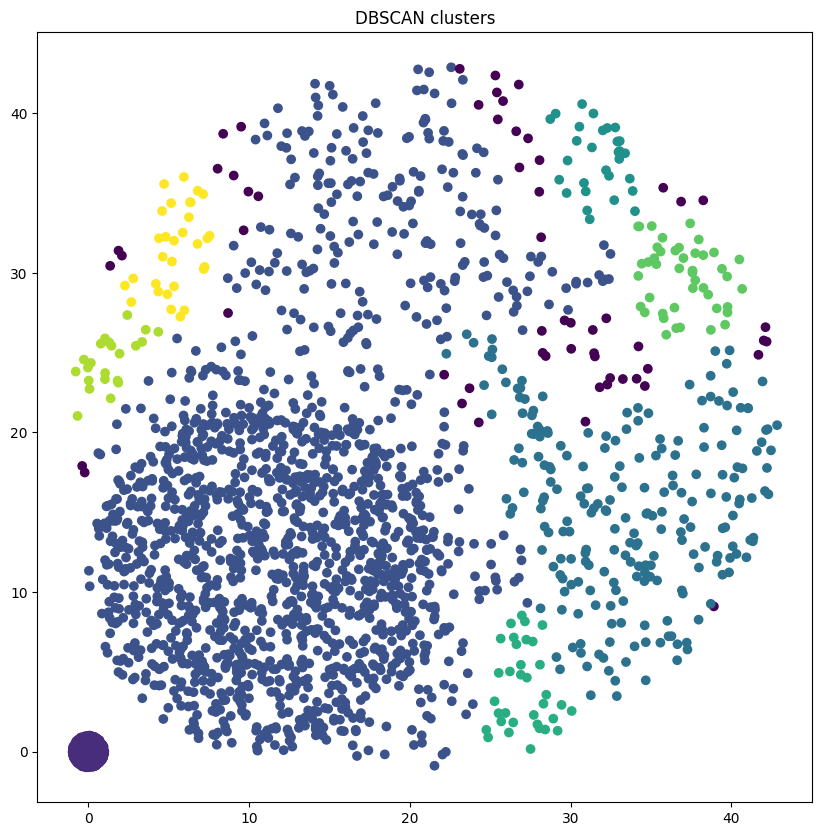

0.7403333333333333
16


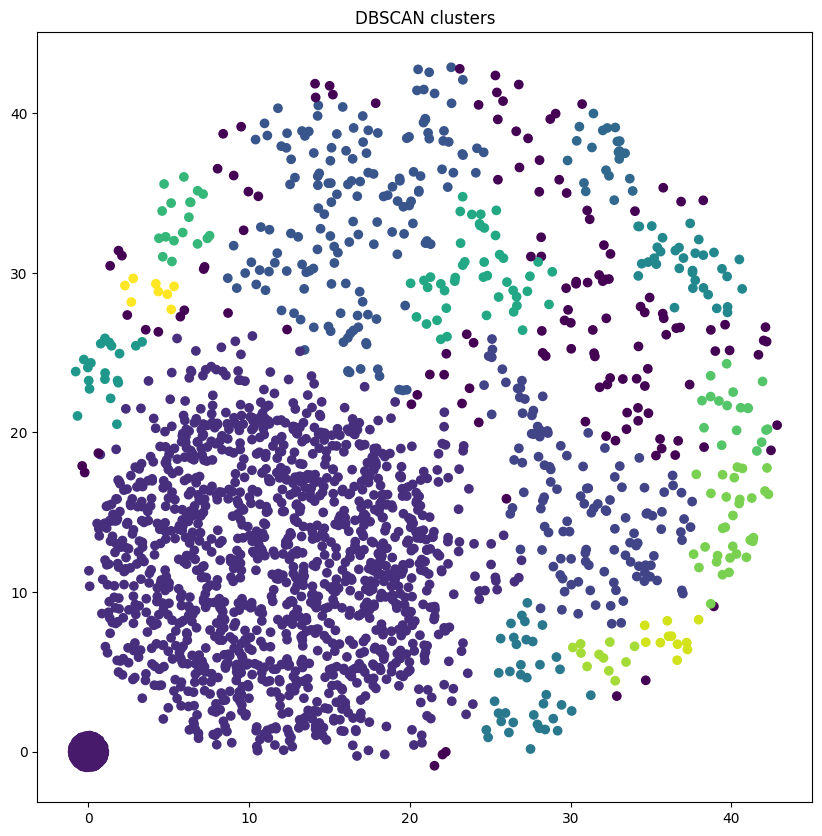

0.708


In [113]:
for i in range(1,11):
    for j in range(1,11):
        # DBSCAN Clustering
        dbscan = DBSCAN(eps=i, min_samples=j)  # Parameters can be adjusted for better clustering
        dbscan.fit(circles)
        predicted_labels = dbscan.labels_
        numberOfClusters = len(np.unique(predicted_labels))
        print(numberOfClusters)

        # Visualize DBSCAN result
        plt.figure(figsize=(10, 10))
        plt.scatter(circles[:, 0], circles[:, 1], c=predicted_labels)
        plt.title('DBSCAN clusters')
        plt.show()

        # Map predicted labels to true labels
        predicted_labels_mapped = np.zeros_like(predicted_labels)
        for i in range(3):
            mask = (predicted_labels == i)
            predicted_labels_mapped[mask] = mode(true_labels[mask])[0]

        # Calculate accuracy
        accuracy = np.sum(predicted_labels_mapped == true_labels) / len(true_labels)
        print(accuracy)


##### 